# Scratch Paper

In [2]:
%load_ext autoreload
%autoreload 2

import sys
import os
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
import seaborn as sns
import pandas as pd
import cv2
import pywt
import tifffile as tiff
from functools import reduce, partial
import itertools
from skimage.measure import block_reduce

In [3]:
import data as udata

## Dataset

In [3]:
ROOT_PATH = '/home/mixs/scotty/mseg'
data_path = os.path.join(ROOT_PATH, 'data')
file_list_path = os.path.join(data_path, 'mini-256', 'all_list.txt')
img_size = 256

db = udata.MicroscopyDataset(
    data_path,
    file_list_path,
    img_size,
    img_size,
    h_flip=False,
    v_flip=False,
    normalize_color=True,
    shuffle_list=False)

[dataset] read /home/mixs/scotty/mseg/data/mini-256/all_list.txt


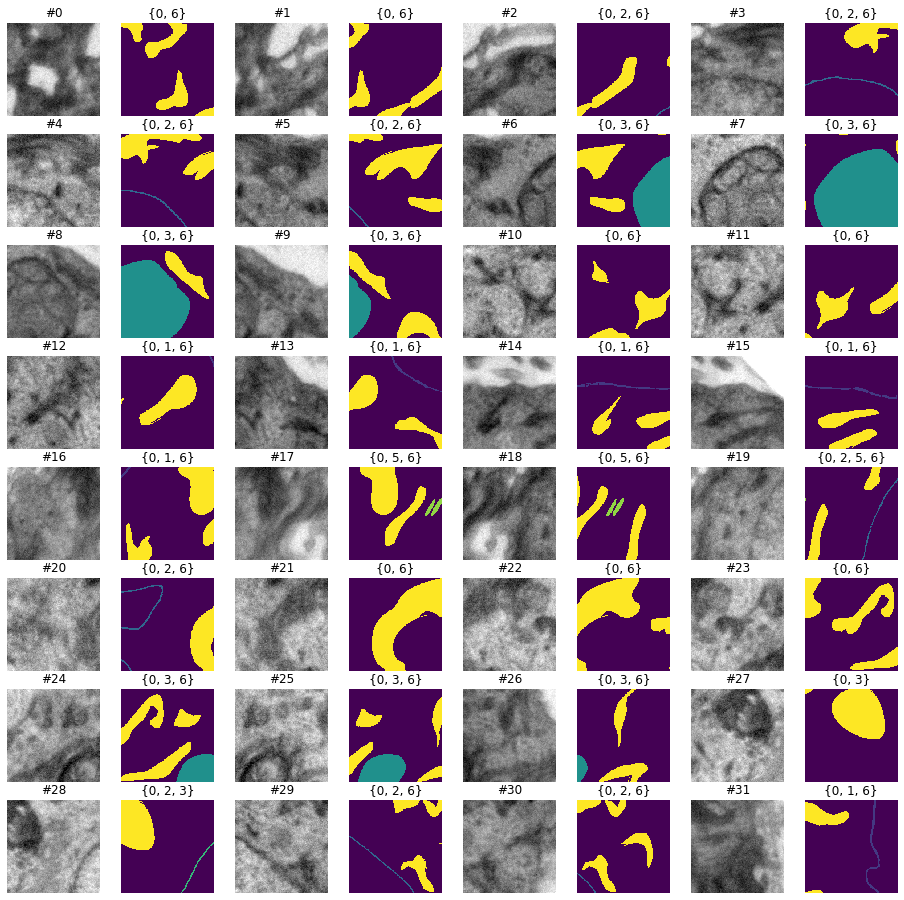

In [4]:
N, M, SZ, SHIFT, REPEAT = 8, 4, 2.0, 0, 1
n_img = N*M // REPEAT
fig, axes = plt.subplots(nrows=N, ncols=2*M, figsize=(SZ*M*2, SZ*N))
axes = axes.flatten()
axes_idx = 0
for i in range(n_img):
    for j in range(REPEAT):
        img, label = db[i+SHIFT]
        img = img[0]
        axes[axes_idx].imshow(img, cmap='gray')
        axes[axes_idx].set_title(f'#{i}')
        axes[axes_idx+1].imshow(label)
        axes[axes_idx+1].set_title(set(list(label.flatten())))
        axes_idx += 2
        
for ax in axes:
    ax.axis('off')

## Wavelets

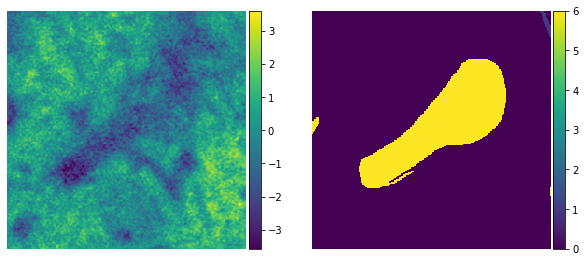

In [5]:
def add_colorbar(ax, pl):
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    plt.colorbar(pl, cax=cax)

img, label = db[12]
img = img[0]
fig, axes = plt.subplots(ncols=2, figsize=(10, 5))

axes[0].axis('off')
pl = axes[0].imshow(img)
add_colorbar(axes[0], pl)

axes[1].axis('off')
pl = axes[1].imshow(label)
add_colorbar(axes[1], pl)

In [6]:
coeffs = pywt.wavedec2(img, 'db1', level=2)
print(len(coeffs))

3


In [7]:
print('Shapes')
for i, cs in enumerate(coeffs):
    if isinstance(cs, np.ndarray):
        print(f'{i}: {cs.shape}')
    elif isinstance(cs, tuple):
        for j, c in enumerate(cs):
            print(f'{i}, {j}: {c.shape}')
    else:
        print(f'{i}: {cs}')

Shapes
0: (64, 64)
1, 0: (64, 64)
1, 1: (64, 64)
1, 2: (64, 64)
2, 0: (128, 128)
2, 1: (128, 128)
2, 2: (128, 128)


In [8]:
def unpack(coeffs):
    coeff_list = []
    coeff_name = []
    for i, cs in enumerate(coeffs):
        if isinstance(cs, np.ndarray):
            coeff_list.append(cs)
            coeff_name.append(f'({i})')
        elif isinstance(cs, tuple):
            for j, c in enumerate(cs):
                coeff_list.append(c)
                coeff_name.append(f'({i}, {j})')
        else:
            print(f'WARNING {i} unknown type')
    return coeff_list, coeff_name

In [9]:
coeff_list, coeff_name = unpack(coeffs)
print(f'{len(coeff_list)} set of coefficients: {[coeff.shape for coeff in coeff_list]}')
print(coeff_name)

7 set of coefficients: [(64, 64), (64, 64), (64, 64), (64, 64), (128, 128), (128, 128), (128, 128)]
['(0)', '(1, 0)', '(1, 1)', '(1, 2)', '(2, 0)', '(2, 1)', '(2, 2)']


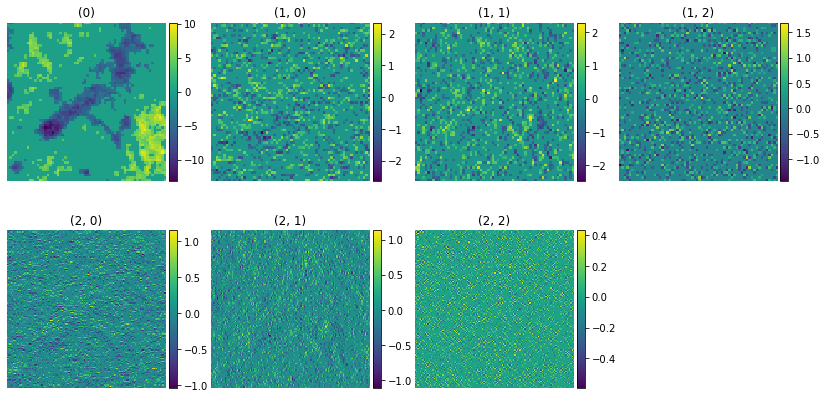

In [10]:
def plot_list_grid(l, names, M=4, SZ=3.5, ksigma=1.0, plot_bar=True):
    N = len(l) // M + (1 if len(l) % M != 0 else 0)
    fig, axes = plt.subplots(nrows=N, ncols=M, figsize=(SZ*M, SZ*N)); axes = axes.flatten()
    for coeff, name, ax in zip(l, names, axes):
        coeff = np.array(coeff)
        if np.sum(coeff < 0.0) > 0.0:
            coeff[np.abs(coeff - np.mean(coeff)) < ksigma * np.std(coeff)] = np.mean(coeff)
        pl = ax.imshow(coeff)
        if plot_bar:
            add_colorbar(ax, pl)
        ax.set_title(name)
    
    for ax in axes:
        ax.axis('off')

# def plot_coeffs_grid(l, names, M=4, SZ=3.5):
#     N = len(l) // M + (1 if len(l) % M != 0 else 0)
#     fig, axes = plt.subplots(nrows=N, ncols=M, figsize=(SZ*M, SZ*N)); axes = axes.flatten()
#     for coeff, name, ax in zip(l, names, axes):
#         pl = ax.imshow(coeff)
#         add_colorbar(ax, pl)
#         ax.set_title(name)
    
#     for ax in axes:
#         ax.axis('off')

plot_list_grid(coeff_list, coeff_name, 4, 3.5)

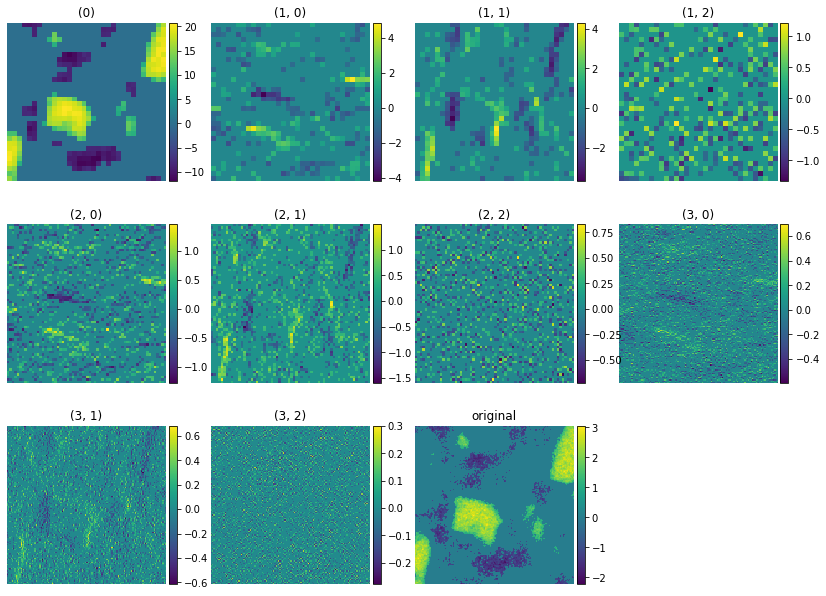

In [11]:
def test_wavelet_img(img, wavelet, level, **kwargs):
    # fit wavelet
    coeff_list, coeff_name = unpack(pywt.wavedec2(img, wavelet, level=level))
    coeff_list.append(img)
    coeff_name.append('original')
    
    # plot result with original image
    plot_list_grid(coeff_list, coeff_name, 4, 3.5, **kwargs)

test_wavelet_img(db[0][0][0], 'haar', 3)

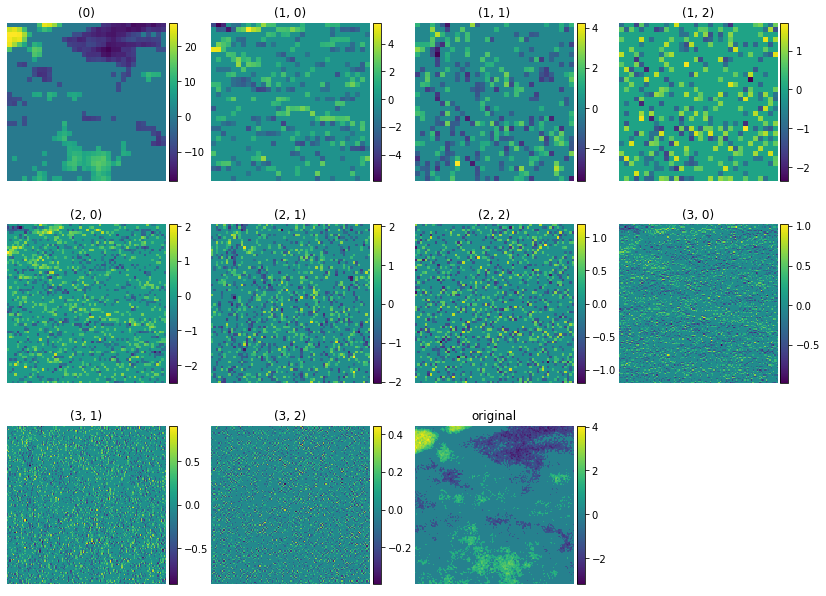

In [12]:
test_wavelet_img(db[3][0][0], 'db1', 3)

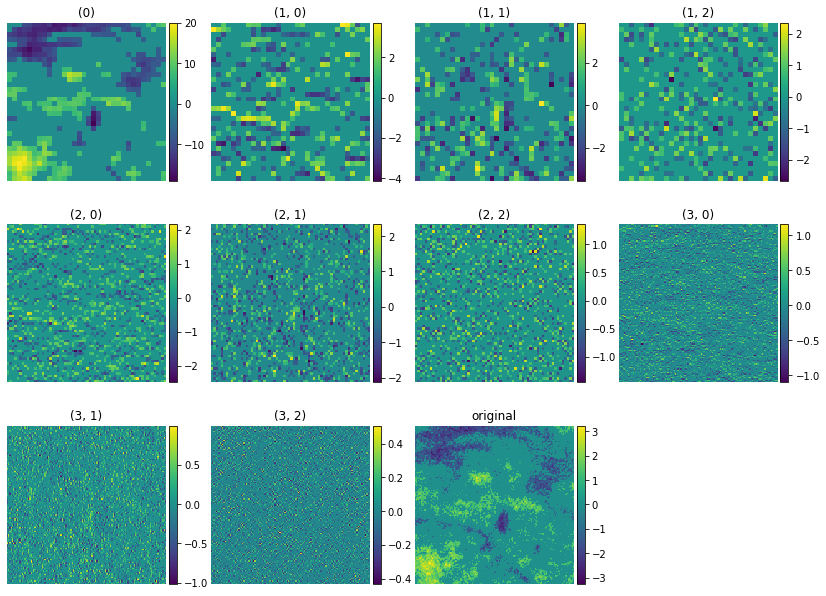

In [13]:
test_wavelet_img(db[4][0][0], 'db1', 3)

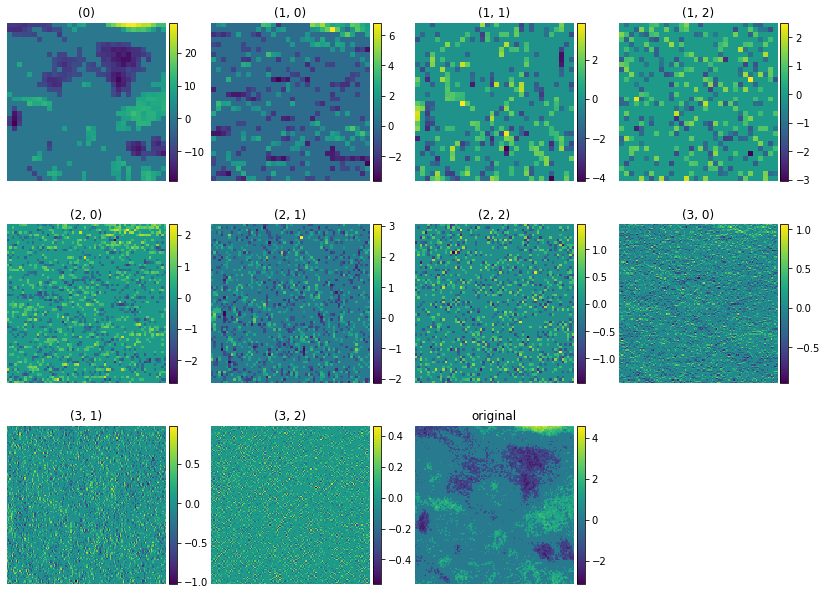

In [14]:
test_wavelet_img(db[5][0][0], 'db1', 3)

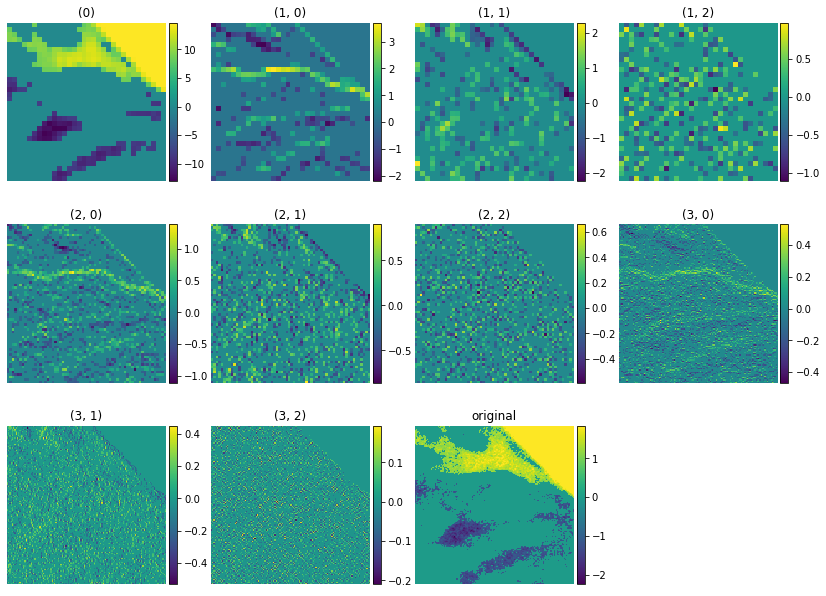

In [15]:
test_wavelet_img(db[15][0][0], 'db1', 3)

In [16]:
dba = udata.WaveletDataAugmemt(db, 'db1', 3)

In [17]:
x = dba[1][0]
print(x.shape)

torch.Size([11, 256, 256])


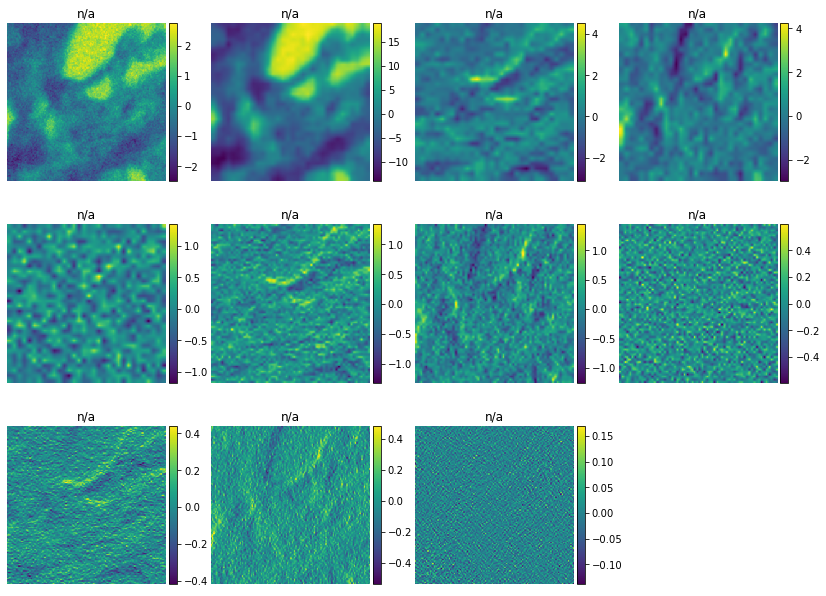

In [18]:
plot_list_grid(x, ["n/a" for _ in range(x.shape[2])], ksigma=0.0)

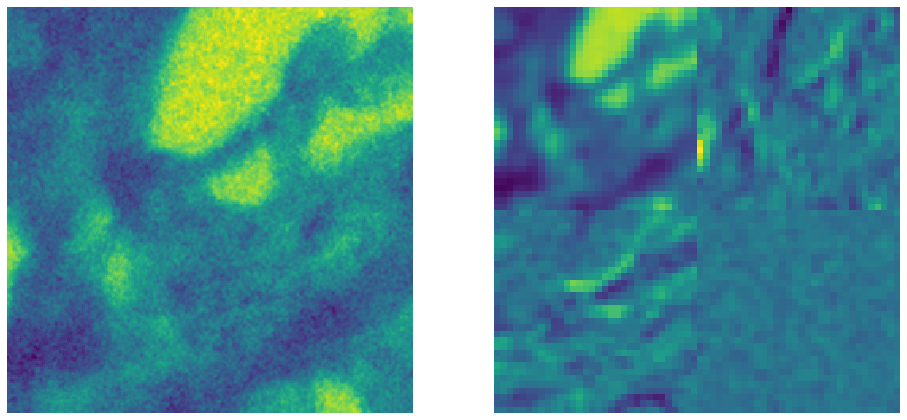

In [19]:
all_x = np.zeros(x.shape[1:])
sz = x.shape[1] // (2 ** (x.shape[0] // 3))
all_x[0:sz, 0:sz] = x[1, ::256//sz, ::256//sz] / (256//sz)**2.8
for i in range(2, x.shape[0], 3):
    for j in range(3):
        xoffset = (1 - j%2) * sz
        yoffset = ((j+1)//2) * sz
        all_x[xoffset:xoffset+sz, yoffset:yoffset+sz] = x[i+j, ::256//sz, ::256//sz] / (256//sz)**2
    sz *= 2
    
fig, axes = plt.subplots(ncols=2, figsize=(16, 8))
axes[0].imshow(x[0])
axes[1].imshow(all_x[:64, :64])
for ax in axes: ax.axis('off')

## Raw Dataset

In [4]:
MROOT = '../data/microscopy'

In [5]:
# unpack given info
class SlideFetcher:
    def __init__(self, name, labels, where):
        self.name = name
        self.labels = labels
        self.label2where = dict()
        for l, w in zip(labels, where):
            self.label2where[l] = w
            
    def __getitem__(self, key):
        return self.get_img(key)
            
    def get_img(self, label):
        return tiff.imread(self.label_path(label))
            
    def label_path(self, label):
        return self.label2where[label]

slides = dict()
for d in os.listdir(MROOT):
    subpath = os.path.join(MROOT, d)
    for dslide in os.listdir(subpath):
        subpathslide = os.path.join(subpath, dslide)
        labels = []
        where = []
        for dimg in os.listdir(subpathslide):
            if dslide in dimg:
                label_name = dimg[len(dslide)+1:]
                if label_name == 'tif':
                    label_name = '__raw__'
                elif label_name.endswith('.tiff'):
                    label_name = label_name[:-5]
#                 print(dslide, label_name)
                labels.append(label_name)
                where.append(os.path.join(subpathslide, dimg))
        slides[dslide] = SlideFetcher(dslide, labels, where)
slides

{'CL_T4R_180807_01': <__main__.SlideFetcher at 0x7fae1a194438>,
 'NA_T4R_122117_19': <__main__.SlideFetcher at 0x7fae53faf400>,
 'CL_T4R_180824_02': <__main__.SlideFetcher at 0x7fae1a194470>,
 'CL_T4R_180807_06': <__main__.SlideFetcher at 0x7fae53faf390>,
 'CL_T4R_180824_05': <__main__.SlideFetcher at 0x7fae1a1944e0>,
 'NA_T4R_122117_17': <__main__.SlideFetcher at 0x7fae1a194518>,
 'S1_Helios_1of3_v1010': <__main__.SlideFetcher at 0x7fae1a194550>,
 'S1_Helios_1of3_v1270': <__main__.SlideFetcher at 0x7fae1a194400>,
 'NA_T4_122117_11': <__main__.SlideFetcher at 0x7fae1a194588>,
 'NA_T4_122117_14': <__main__.SlideFetcher at 0x7fae1a1945f8>,
 'NA_T4_122117_15': <__main__.SlideFetcher at 0x7fae1a1944a8>,
 'NA_T4_122117_13': <__main__.SlideFetcher at 0x7fae1a194630>,
 'NA_T4_122117_01': <__main__.SlideFetcher at 0x7fae1a194668>}

In [6]:
allskey = list(slides.keys())
nlabel = 1
label2val = {'Background': 0}
val2label = {0: 'Background'}
allalllabel = []
allrimg = []
for skey in allskey:
    tlabel = slides[skey].labels[3]
    rimg = slides[skey]['__raw__']

    alllabel = np.zeros(rimg.shape, dtype=int)
    for l in slides[skey].labels:
        if l == '__raw__': continue
        limg = slides[skey][l]
        if l not in label2val:
            label2val[l] = nlabel
            val2label[nlabel] = l
            nlabel += 1
        alllabel[limg != 0] = label2val[l]
        del limg
    
    allalllabel.append(alllabel)
    allrimg.append(rimg)

In [7]:
everylabel = list(label2val.keys())
label2cmap = {label2val[l]:c for l, c in zip(everylabel, sns.color_palette("hls", len(everylabel)))}

In [8]:
print('val2label', val2label)
print('label2val', label2val)

val2label {0: 'Background', 1: 'Desmosome', 2: 'LipidDroplet', 3: 'PlasmaMembrane', 4: 'MitochondriaLight', 5: 'NuclearMembrane', 6: 'Cytoskeleton', 7: 'MitochondriaDark'}
label2val {'Background': 0, 'Desmosome': 1, 'LipidDroplet': 2, 'PlasmaMembrane': 3, 'MitochondriaLight': 4, 'NuclearMembrane': 5, 'Cytoskeleton': 6, 'MitochondriaDark': 7}


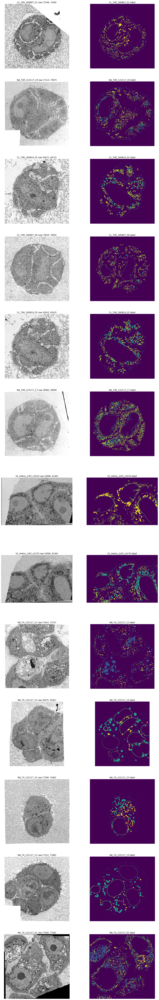

In [9]:
N, SZ = len(allskey), 8
fig, axes = plt.subplots(nrows=N, ncols=2, figsize=(2*SZ, N*SZ))
for axs, alllabel, rimg, name in zip(axes, allalllabel, allrimg, allskey):
    axs[1].imshow(alllabel[::8, ::8])
    axs[1].set_title(f'{name} label')
    axs[0].imshow(rimg[::8, ::8], cmap='gray')
    axs[0].set_title(f'{name} raw {rimg.shape}')
for ax in axes.flatten():
    ax.axis('off')

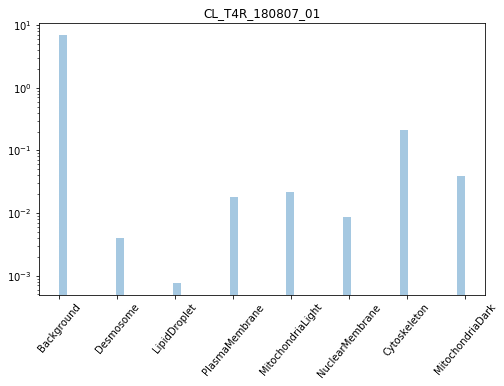

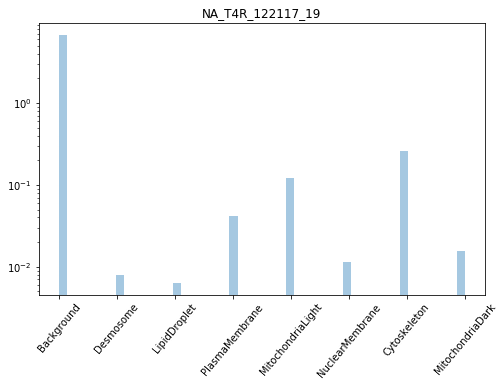

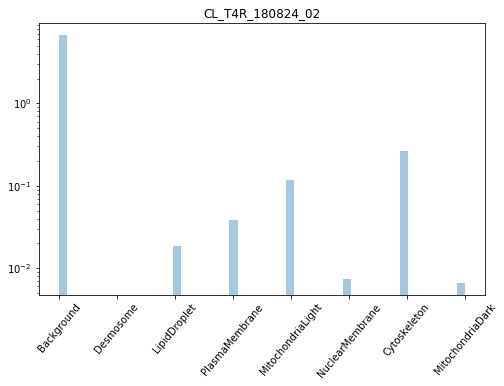

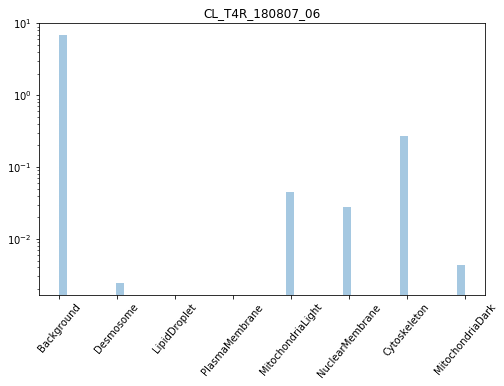

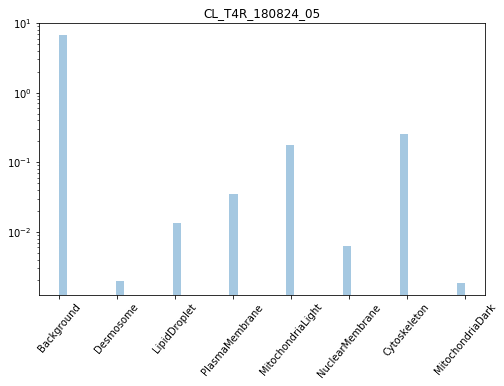

...

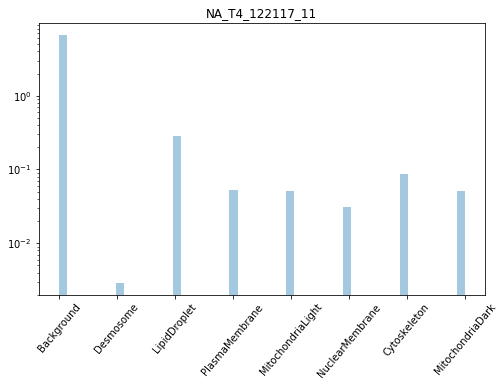

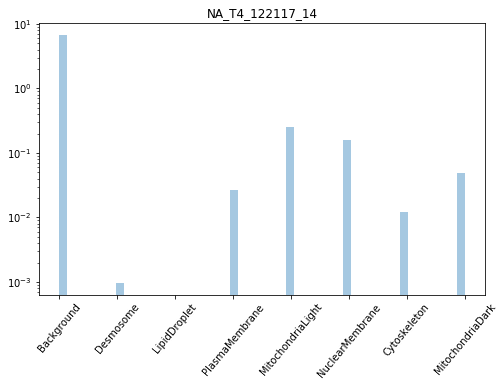

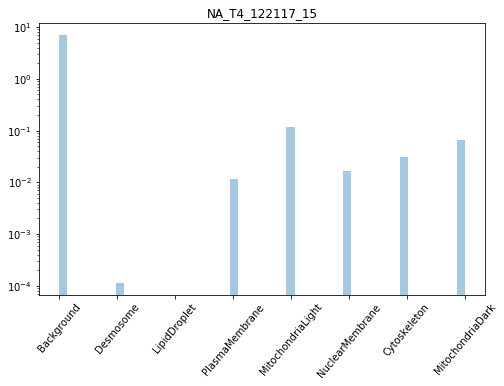

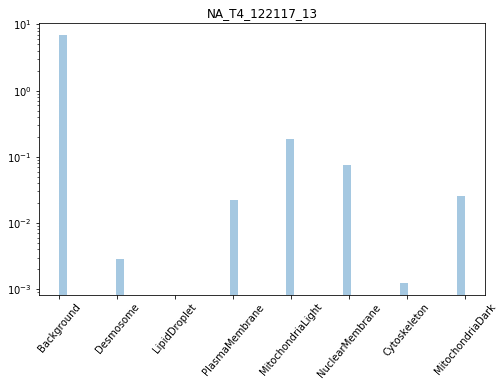

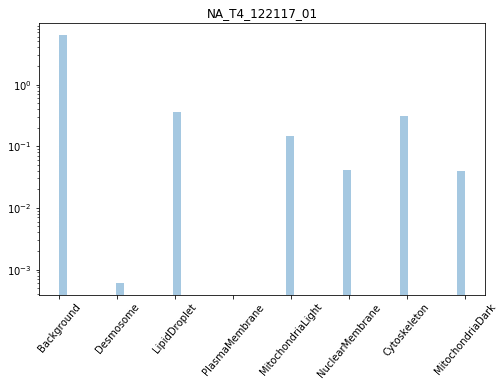

In [72]:
def plot_dist_label(alllabel, val2label, name):
    plt.figure(figsize=(8, 5))
    plt.xticks(list(val2label.keys()), list(val2label.values()), rotation=50)
    g = sns.distplot(alllabel.flatten(), hist=True, kde=False, norm_hist=True)
    g.set_yscale('log')
    g.set_title(name)
    plt.show()

for i in range(len(allskey)):
    plot_dist_label(allalllabel[i], val2label, allskey[i])

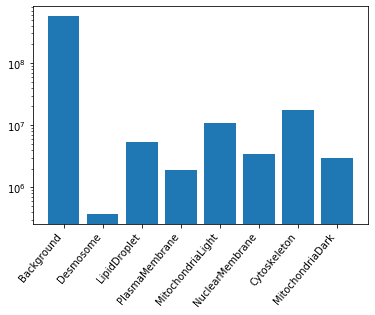

In [76]:
lsum = np.zeros(nlabel)
for i in range(len(allskey)):
    for l in everylabel:
        lsum[label2val[l]] += np.sum(allalllabel[i] == label2val[l])
fig, ax = plt.subplots()
ax.set_xticks(list(val2label.keys()))
ax.set_xticklabels(list(val2label.values()), rotation=50, ha='right')
ax.bar(range(nlabel), lsum)
ax.set_yscale('log')

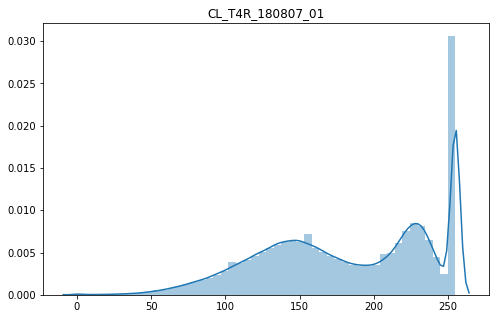

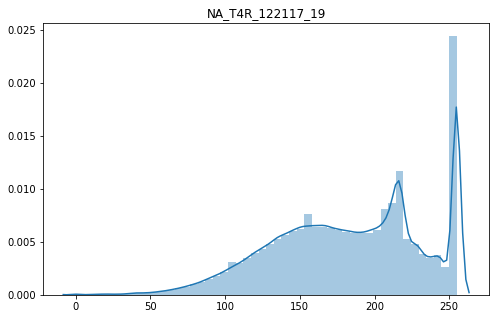

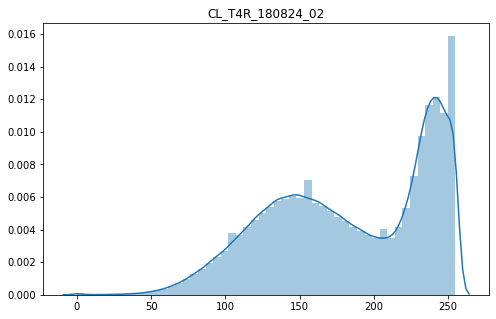

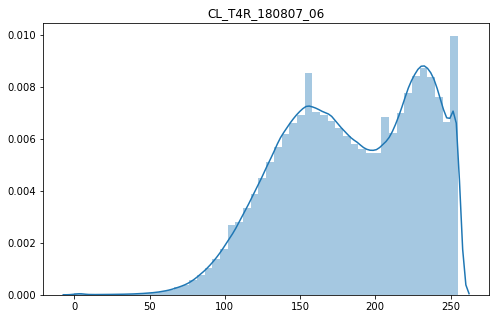

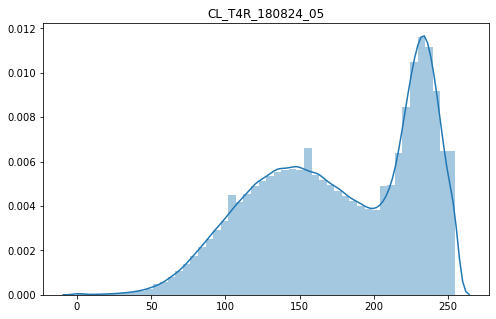

...

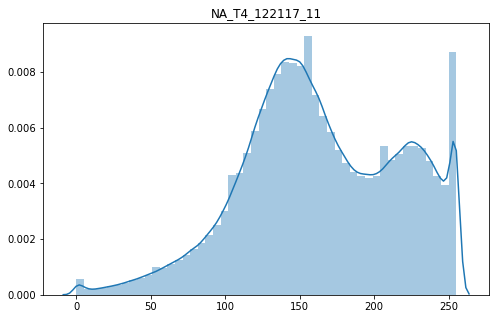

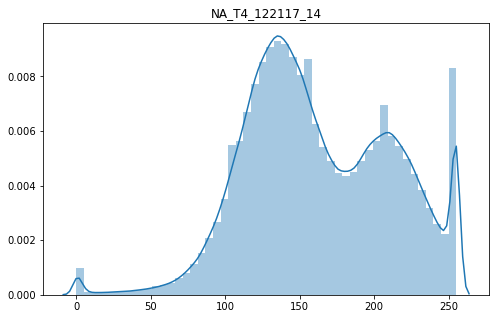

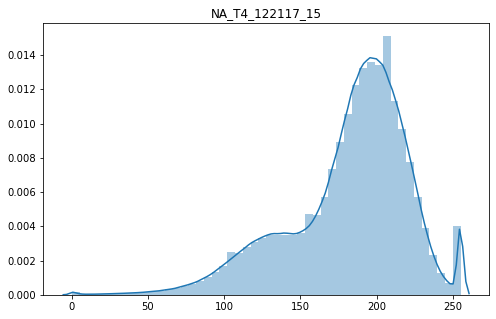

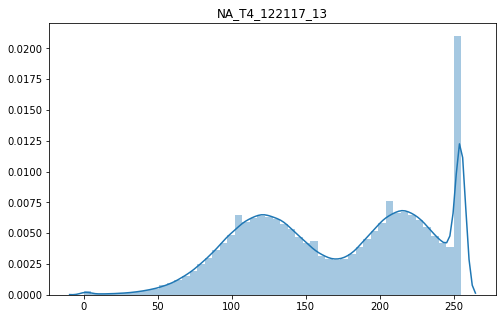

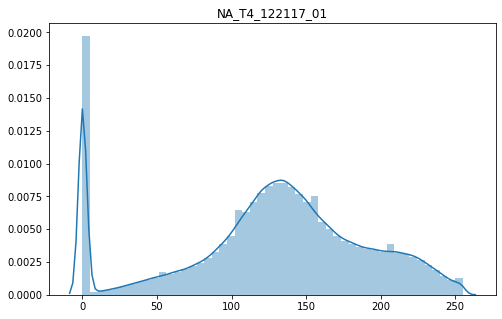

In [40]:
for i in range(len(allskey)):
    plt.figure(figsize=(8, 5))
    g = sns.distplot(allrimg[i].flatten()[::20])
    g.set_title(allskey[i])

Background: mean= 185.925037, std= 52.893528
Desmosome: mean= 65.688988, std= 23.879320
LipidDroplet: mean= 201.332924, std= 25.807565
PlasmaMembrane: mean= 147.682371, std= 36.697082
MitochondriaLight: mean= 114.497758, std= 15.732414
NuclearMembrane: mean= 108.307692, std= 19.983967
Cytoskeleton: mean= 83.382602, std= 23.977775
MitochondriaDark: mean= 80.760804, std= 25.402438


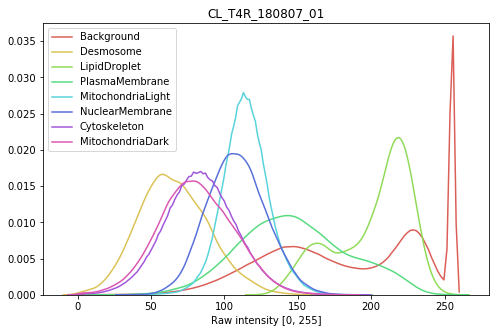

Background: mean= 186.958625, std= 47.149081
Desmosome: mean= 99.183407, std= 38.681103
LipidDroplet: mean= 185.296260, std= 34.600341
PlasmaMembrane: mean= 173.740639, std= 38.179140
MitochondriaLight: mean= 114.567703, std= 30.886928
NuclearMembrane: mean= 134.369154, std= 31.185328
Cytoskeleton: mean= 114.891649, std= 32.521449
MitochondriaDark: mean= 80.191325, std= 46.819473


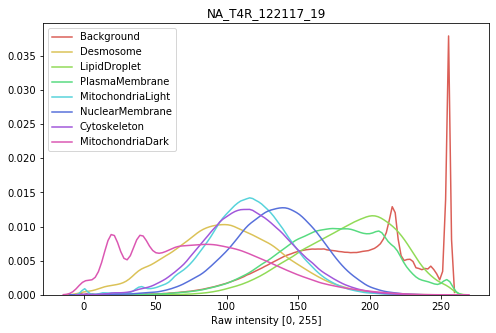

Background: mean= 188.285405, std= 51.267903
LipidDroplet: mean= 187.258524, std= 34.734557
PlasmaMembrane: mean= 157.989928, std= 36.883453
MitochondriaLight: mean= 138.653634, std= 21.603151
NuclearMembrane: mean= 130.087169, std= 30.093091
Cytoskeleton: mean= 99.011632, std= 25.494713
MitochondriaDark: mean= 114.195234, std= 33.119314


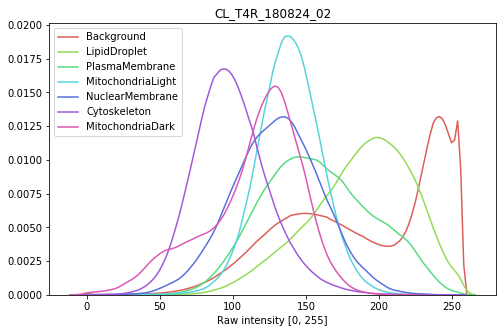

Background: mean= 187.276075, std= 43.890577
Desmosome: mean= 108.236190, std= 23.284971
MitochondriaLight: mean= 168.508182, std= 23.939624
NuclearMembrane: mean= 125.258855, std= 25.252963
Cytoskeleton: mean= 111.504934, std= 24.262460
MitochondriaDark: mean= 134.432943, std= 28.452207


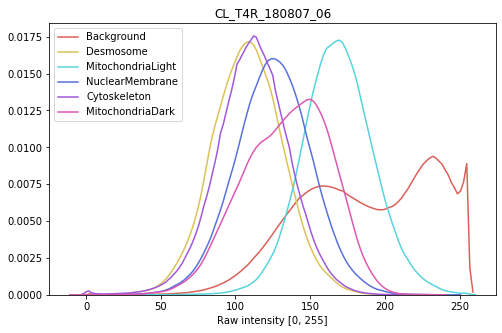

Background: mean= 182.278600, std= 51.244551
Desmosome: mean= 98.025791, std= 31.322008
LipidDroplet: mean= 182.660401, std= 36.047231
PlasmaMembrane: mean= 150.228676, std= 38.580744
MitochondriaLight: mean= 130.942503, std= 24.867679
NuclearMembrane: mean= 128.304894, std= 32.401194
Cytoskeleton: mean= 95.684589, std= 25.193610
MitochondriaDark: mean= 70.820107, std= 36.874030


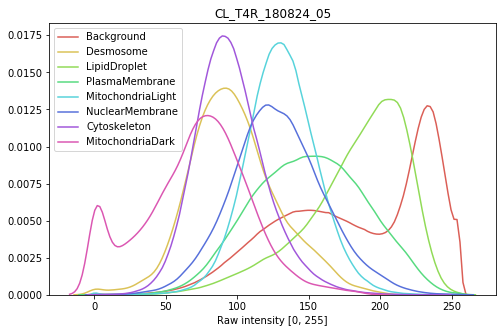

Background: mean= 204.111624, std= 41.941648
Desmosome: mean= 97.234385, std= 29.044926
MitochondriaLight: mean= 126.558603, std= 26.111644
NuclearMembrane: mean= 145.233059, std= 25.748576
Cytoskeleton: mean= 126.995607, std= 27.260536
MitochondriaDark: mean= 92.828204, std= 39.184466


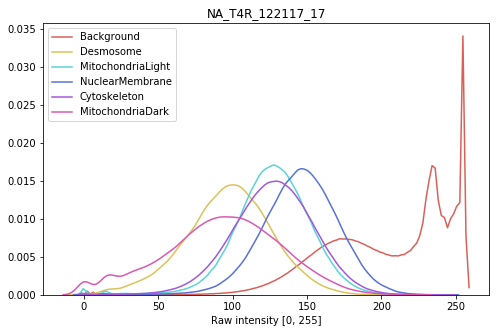

Background: mean= 141.203408, std= 41.437479
Desmosome: mean= 41.581405, std= 20.383345
NuclearMembrane: mean= 78.685680, std= 19.414190
Cytoskeleton: mean= 68.099275, std= 25.589197
MitochondriaDark: mean= 73.135044, std= 19.349543


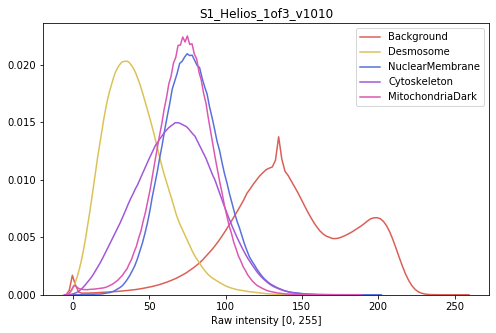

Background: mean= 133.260050, std= 41.563319
Desmosome: mean= 28.811634, std= 18.289784
PlasmaMembrane: mean= 116.493930, std= 26.023290
MitochondriaLight: mean= 62.072874, std= 18.842002
NuclearMembrane: mean= 70.977383, std= 20.655943
Cytoskeleton: mean= 54.014095, std= 25.461470
MitochondriaDark: mean= 35.198974, std= 21.395751


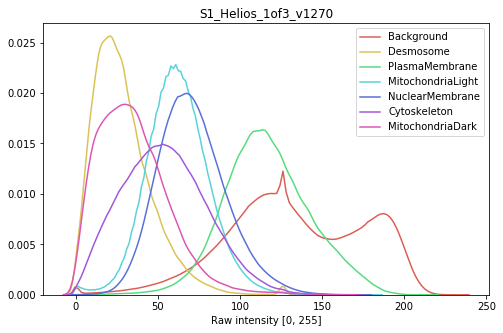

Background: mean= 163.930418, std= 50.645294
Desmosome: mean= 65.945229, std= 29.947016
LipidDroplet: mean= 225.949488, std= 18.328604
PlasmaMembrane: mean= 132.504581, std= 31.794154
MitochondriaLight: mean= 130.713962, std= 25.492174
NuclearMembrane: mean= 86.325701, std= 37.399487
Cytoskeleton: mean= 71.737487, std= 33.251321
MitochondriaDark: mean= 73.062676, std= 32.819540


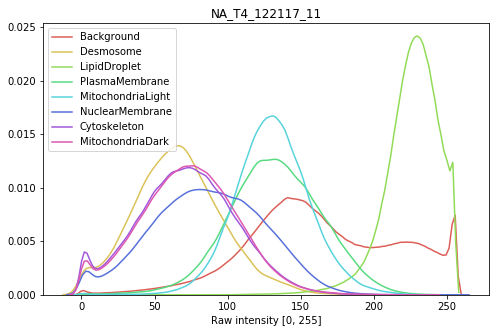

Background: mean= 165.141123, std= 48.501165
Desmosome: mean= 86.537048, std= 20.918922
PlasmaMembrane: mean= 164.770035, std= 33.072564
MitochondriaLight: mean= 142.689084, std= 30.270726
NuclearMembrane: mean= 108.838853, std= 25.165500
Cytoskeleton: mean= 108.017160, std= 25.705779
MitochondriaDark: mean= 87.479468, std= 29.230145


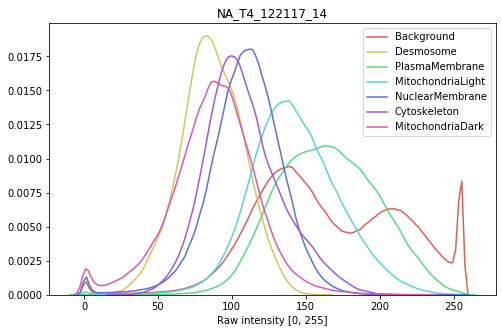

Background: mean= 184.631805, std= 36.384618
Desmosome: mean= 65.677890, std= 14.677779
PlasmaMembrane: mean= 150.709046, std= 32.975506
MitochondriaLight: mean= 128.225564, std= 27.489772
NuclearMembrane: mean= 88.400584, std= 19.721167
Cytoskeleton: mean= 111.225022, std= 19.714237
MitochondriaDark: mean= 60.233563, std= 31.266639


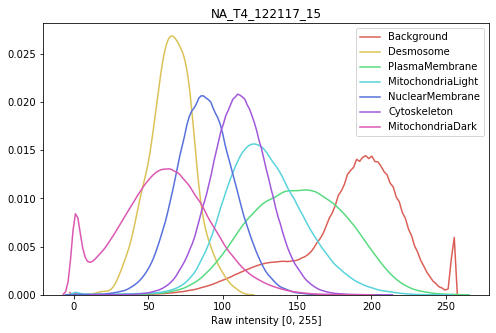

Background: mean= 173.029206, std= 57.872153
Desmosome: mean= 98.222835, std= 25.133762
PlasmaMembrane: mean= 163.071998, std= 44.252692
MitochondriaLight: mean= 123.621413, std= 33.018925
NuclearMembrane: mean= 88.292961, std= 31.505090
Cytoskeleton: mean= 45.666702, std= 34.512121
MitochondriaDark: mean= 51.563693, std= 32.489457


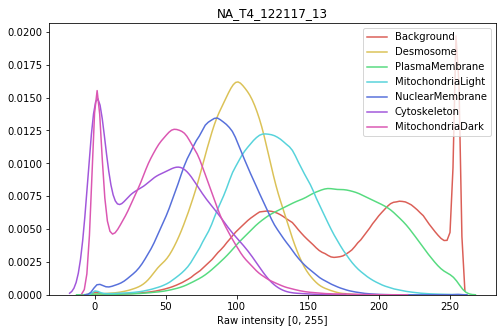

Background: mean= 127.986628, std= 61.092390
Desmosome: mean= 73.706794, std= 29.376399
LipidDroplet: mean= 216.514449, std= 23.638192
MitochondriaLight: mean= 105.549459, std= 20.578511
NuclearMembrane: mean= 77.754083, std= 29.725654
Cytoskeleton: mean= 58.797745, std= 28.249334
MitochondriaDark: mean= 81.414413, std= 42.932795


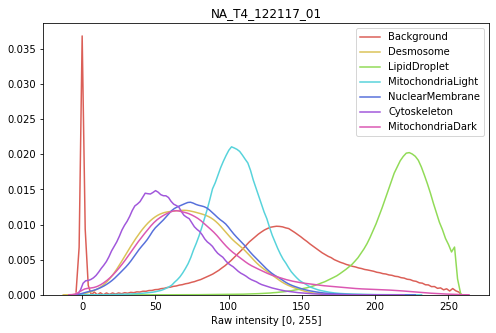

In [47]:
def plot_dist_label_raw(rimg, alllabel, val2label, skey):
    plt.figure(figsize=(8, 5))
    for i in range(nlabel):
        pix = rimg[alllabel == i]
        if len(pix) == 0: continue
        g = sns.distplot(pix, color=label2cmap[i], label=val2label[i], hist=False)
        print('%s: mean= %f, std= %f'%(val2label[i], np.mean(pix), np.std(pix)))
    g.set_title(skey)
    g.set_xlabel('Raw intensity [0, 255]')
    plt.show()

for i in range(len(allskey)):
    plot_dist_label_raw(allrimg[i], allalllabel[i], val2label, allskey[i])

Background (113228): mean= 173.626576, std= 53.685238
Desmosome (371135): mean= 67.107804, std= 39.089493
LipidDroplet (1079713): mean= 218.991990, std= 23.890478
PlasmaMembrane (375992): mean= 149.226848, std= 39.734229
MitochondriaLight (2156586): mean= 121.263128, std= 35.512969
NuclearMembrane (3375676): mean= 98.161354, std= 34.242420
Cytoskeleton (3499009): mean= 95.532879, std= 36.859956
MitochondriaDark (584256): mean= 73.693946, std= 33.971128


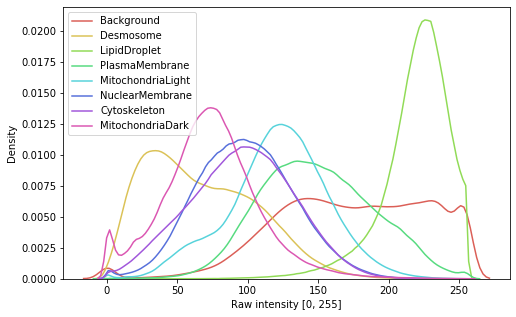

In [56]:
plt.figure(figsize=(8, 5))
for i in range(len(everylabel)):
    pix = []
    for rimg, alllabel in zip(allrimg, allalllabel):
        if i == 0:
            pix.extend(rimg[alllabel == i][::5000])
        elif i == 1:
            pix.extend(rimg[alllabel == i][::])
        elif i == 5:
            pix.extend(rimg[alllabel == i][::1])
        else:
            pix.extend(rimg[alllabel == i][::5])
    g = sns.distplot(pix, color=label2cmap[i], label=val2label[i], hist=False)
    print('%s (%d): mean= %f, std= %f'%(val2label[i], len(pix), np.mean(pix), np.std(pix)))
    g.set_xlabel('Raw intensity [0, 255]')
    g.set_ylabel('Density')
    del pix

bound ((2901, 2951), (1763, 1794)) , dim=  (50, 31) , size= 1550


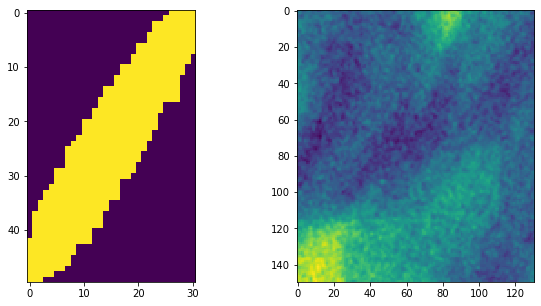

In [144]:
def bound_dim(bound):
    return bound[0][1] - bound[0][0], bound[1][1] - bound[1][0]

def bound_size(bound):
    dim = bound_dim(bound)
    return dim[0] * dim[1]

def extract_a_cont_true(bmap, orig, cut=False, border=0):
    for i in range(len(bmap)):
        if np.sum(bmap[i]) == 0: continue
        for j in range(len(bmap[i])):
            if bmap[i][j]: break
        if bmap[i][j]: break
    if np.sum(bmap[i]) == 0: return None, None, None
    works = [(i, j)]
    emap = np.zeros(bmap.shape, dtype=bool)
    if cut: bmap[i, j] = False
    emap[i, j] = True
    mx_x, mx_y = i, j
    mi_x, mi_y = i, j
    while len(works) > 0:
        x, y = works.pop()
        for nx, ny in [(1, 0), (-1, 0), (0, 1), (0, -1), (1, 1), (-1, -1), (-1, 1), (1, -1)]:
            x2, y2 = x+nx, y+ny
            if 0 <= x2 < len(emap) and 0 <= y2 < len(emap[0]) and bmap[x2, y2] and not emap[x2, y2]:
                if cut: bmap[x2, y2] = False
                emap[x2, y2] = True
                works.append((x2, y2))
                mx_x = max(mx_x, x2)
                mx_y = max(mx_y, y2)
                mi_x = min(mi_x, x2)
                mi_y = min(mi_y, y2)
    return emap[mi_x:mx_x+1, mi_y:mx_y+1], \
        orig[mi_x-border:mx_x+border+1, mi_y-border:mx_y+border+1], \
        ((mi_x, mx_x+1), (mi_y, mx_y+1))

emap, eimg, bound = extract_a_cont_true(allalllabel[0] == 1, allrimg[0], border=50)
print('bound', bound, ', dim= ', bound_dim(bound), ', size=', bound_size(bound))
fig, axs = plt.subplots(ncols=2, figsize=(10, 5))
axs[0].imshow(emap)
axs[1].imshow(eimg)

found 6 regions of Desmosome


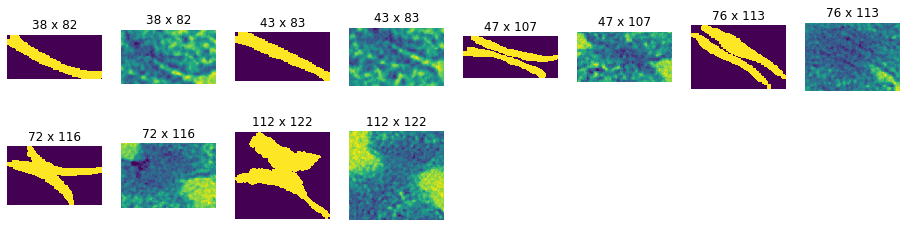

In [199]:
def extract_all_cont_true(bmap, rimg, limit=100, border=0):
    allemap = []
    alleimg = []
    allbound = []
    while len(allemap) < limit:
        emap, eimg, bound = extract_a_cont_true(bmap, rimg, cut=True, border=border)
        if emap is None or bound_size(bound) < 20: break
        allemap.append(emap)
        alleimg.append(eimg)
        allbound.append(bound)
    return allemap, alleimg, allbound

VAL = 1
SKEY = 4
allemap, alleimg, allbound = extract_all_cont_true(allalllabel[SKEY] == VAL, allrimg[SKEY], border=10)
print('found', len(allemap), 'regions of', val2label[VAL])

M, SZ = 4, 2
N = min(8, (len(allemap) - 1) // M + 1)
fig, axes = plt.subplots(nrows=N, ncols=2*M, figsize=(2*M*SZ, N*SZ))
axes_0 = axes.flatten()[::2]
axes_1 = axes.flatten()[1::2]
for ax0, ax1, emap, eimg, bound in zip(axes_0, axes_1, allemap, alleimg, allbound):
    ax0.imshow(emap)
    ax0.set_title('%d x %d'%(bound[0][1] - bound[0][0], bound[1][1] - bound[1][0]))
    ax1.imshow(eimg)
    ax1.set_title('%d x %d'%(bound[0][1] - bound[0][0], bound[1][1] - bound[1][0]))
for ax in axes.flatten(): ax.axis('off')

In [202]:
LIMIT = 30
label2lmap = dict()
label2limg = dict()
label2lbound = dict()
for l in everylabel:
    if l == 'Background': continue
    lmap = []
    limg = []
    lbound = []
    for i in range(len(allskey)):
        allemap, alleimg, allbound = extract_all_cont_true(allalllabel[i] == label2val[l], allrimg[i], limit=LIMIT, border=10)
        if len(allemap) == LIMIT: print(allskey[i], 'exceeds limit')
        lmap.extend(allemap)
        limg.extend(alleimg)
        lbound.extend(allbound)
    label2lmap[l] = lmap
    label2limg[l] = limg
    label2lbound[l] = lbound
    print(l, 'extract done', len(label2lmap[l]))

S1_Helios_1of3_v1010 exceeds limit
S1_Helios_1of3_v1270 exceeds limit
Desmosome extract done 147
NA_T4R_122117_19 exceeds limit
CL_T4R_180824_02 exceeds limit
CL_T4R_180824_05 exceeds limit
NA_T4_122117_11 exceeds limit
LipidDroplet extract done 126
CL_T4R_180824_05 exceeds limit
NA_T4_122117_13 exceeds limit
PlasmaMembrane extract done 99
CL_T4R_180807_01 exceeds limit
NA_T4R_122117_19 exceeds limit
CL_T4R_180824_02 exceeds limit
CL_T4R_180807_06 exceeds limit
CL_T4R_180824_05 exceeds limit
NA_T4R_122117_17 exceeds limit
S1_Helios_1of3_v1270 exceeds limit
NA_T4_122117_11 exceeds limit
NA_T4_122117_14 exceeds limit
MitochondriaLight extract done 317
NuclearMembrane extract done 31
CL_T4R_180807_01 exceeds limit
NA_T4R_122117_19 exceeds limit
CL_T4R_180824_05 exceeds limit
NA_T4R_122117_17 exceeds limit
S1_Helios_1of3_v1010 exceeds limit
S1_Helios_1of3_v1270 exceeds limit
NA_T4_122117_11 exceeds limit
Cytoskeleton extract done 290
CL_T4R_180807_01 exceeds limit
S1_Helios_1of3_v1010 exce

0 Desmosome 147
1 LipidDroplet 126
2 PlasmaMembrane 99
3 MitochondriaLight 317
4 NuclearMembrane 31
5 Cytoskeleton 290
6 MitochondriaDark 225


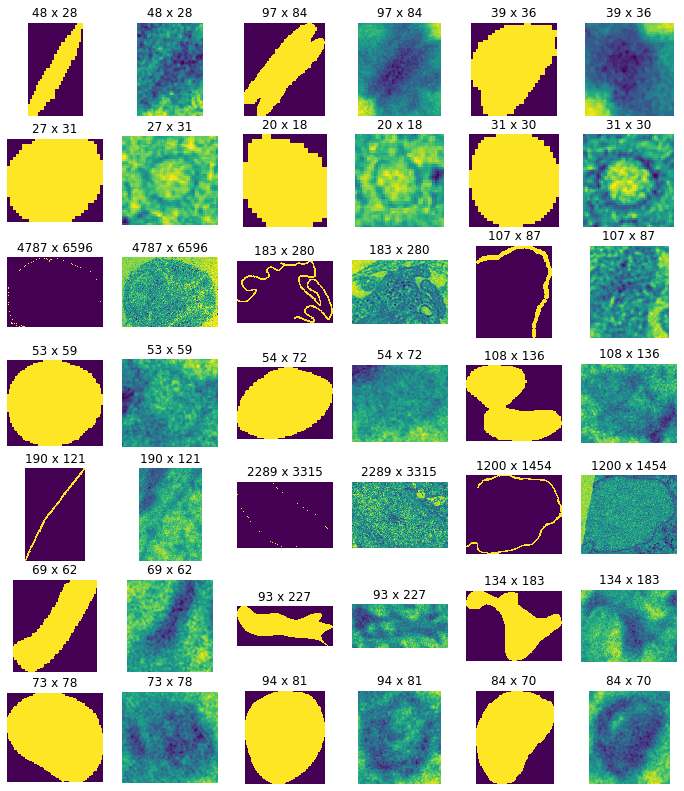

In [211]:
N, M, OFFSET, SKIP = len(val2limg), 3, 1, 7
fig, axes = plt.subplots(nrows=N, ncols=2*M, figsize=(2*M*SZ, N*SZ))
for i, l in enumerate(val2limg.keys()):
    print(i, l, len(label2lmap[l]))
    axes_0 = axes[i, ::2]
    axes_1 = axes[i, 1::2]
#     axes_0 = axes[i, :M]
#     axes_1 = axes[i, M:]
    for ax0, ax1, emap, eimg, bound in zip(axes_0, axes_1, label2lmap[l][OFFSET::SKIP], label2limg[l][OFFSET::SKIP], label2lbound[l][OFFSET::SKIP]):
        ax0.imshow(emap)
        ax0.set_title('%d x %d'%(bound[0][1] - bound[0][0], bound[1][1] - bound[1][0]))
        ax1.imshow(eimg)
        ax1.set_title('%d x %d'%(bound[0][1] - bound[0][0], bound[1][1] - bound[1][0]))
for ax in axes.flatten(): ax.axis('off')


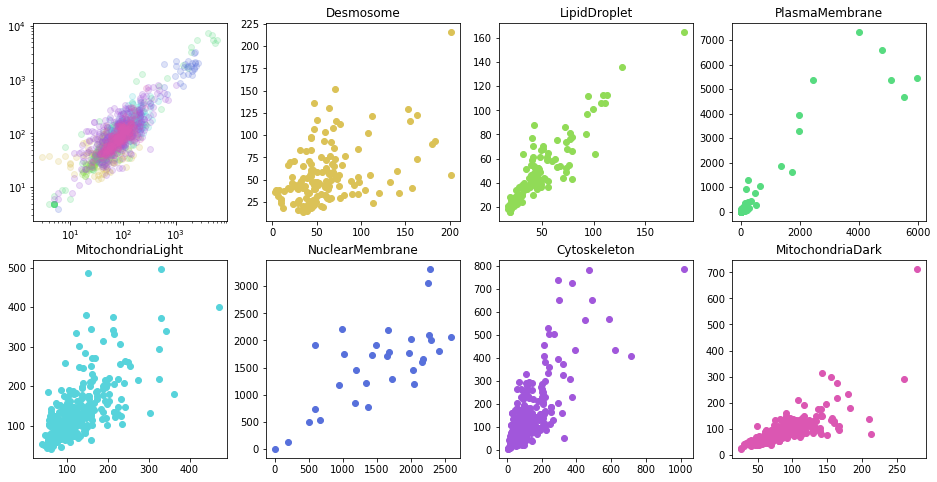

In [248]:
fig, axes = plt.subplots(ncols=4, nrows=2, figsize=(16, 8)); axes = axes.flatten()
for l in label2val.keys():
    if l == 'Background': continue
#     if l in ['MitochondriaDark', 'MitochondriaLight']: continue
    ldim = np.array(list(map(bound_dim, label2lbound[l])))
    axes[0].scatter(ldim[:, 0], ldim[:, 1], color=label2cmap[label2val[l]], label=l, alpha=0.2)
    axes[0].set_yscale('log')
    axes[0].set_xscale('log')
    
    t = label2val[l]
    axes[t].scatter(ldim[:, 0], ldim[:, 1], color=label2cmap[label2val[l]], label=l)
    axes[t].set_title(l)

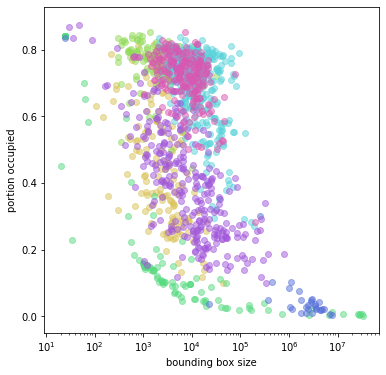

In [285]:
def plot_bound_one(HL, ax, l):
    ldim = np.array(list(map(bound_dim, label2lbound[l])))
    lsize = np.array(list(map(bound_size, label2lbound[l])))
    ltruesize = np.array(list(map(np.sum, label2lmap[l])))
    lportion = ltruesize / lsize
    xs = lsize; ax.set_xlabel('bounding box size')
    ys = lportion; ax.set_ylabel('portion occupied')
    if HL:
        c = label2cmap[label2val[l]] if l == HL else 'grey'
        a = 1.0 if l == HL else 0.1
    else:
        c = label2cmap[label2val[l]]
        a = 0.5
    ax.scatter(xs, ys, color=c, label=l, alpha=a)
#     ax.set_yscale('log')
    ax.set_xscale('log')

def plot_bound(HL, ax):
    for l in label2val.keys():
        if l == 'Background' or l == HL: continue
    #     if l in ['MitochondriaDark', 'MitochondriaLight']: continue
        plot_bound_one(HL, ax, l)
    if HL:
        plot_bound_one(HL, ax, HL)

fig, ax = plt.subplots(figsize=(6, 6))
plot_bound(None, ax)

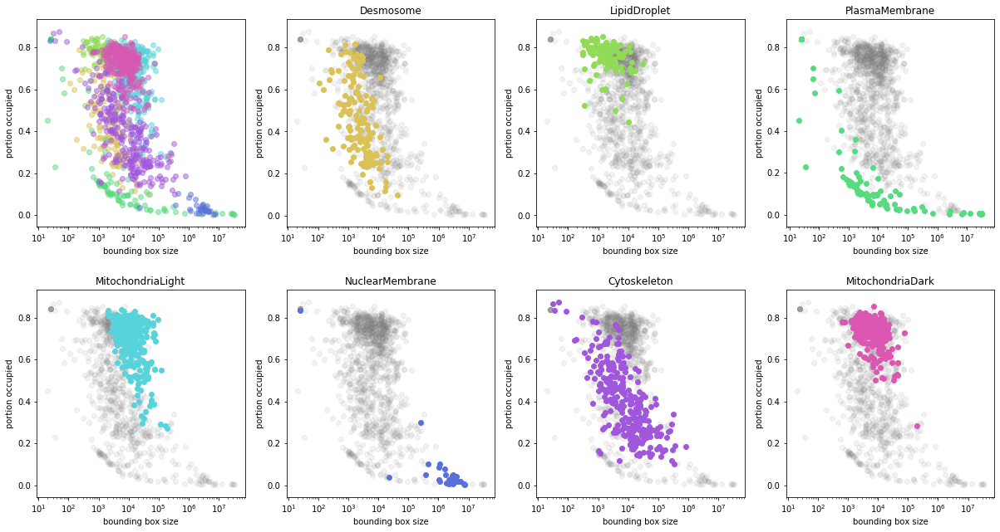

In [298]:
fig, axes = plt.subplots(ncols=4, nrows=2, figsize=(16, 8)); axes = axes.flatten()
for l, ax in zip(label2val.keys(), axes):
    if l == 'Background': l = None
    plot_bound(l, ax)
    ax.set_title(l if l else '')
#     ax.margins(0.1)
plt.subplots_adjust(left=0, bottom=0, right=1.0, top=1.0, wspace=0.2, hspace=0.3)

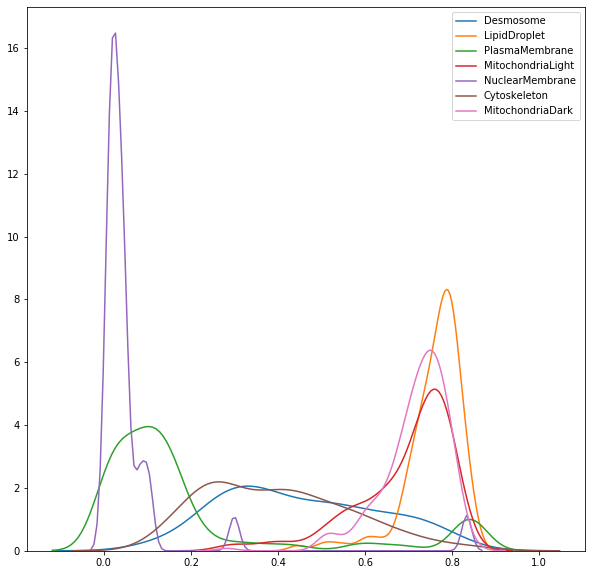

In [262]:
plt.figure(figsize=(10, 10))
for l in label2val.keys():
    if l == 'Background': continue
    lsize = np.array(list(map(bound_size, label2lbound[l])))
    lportion = np.array(list(map(np.sum, label2lmap[l]))) / lsize
    g = sns.distplot(lportion, label=l, hist=False)

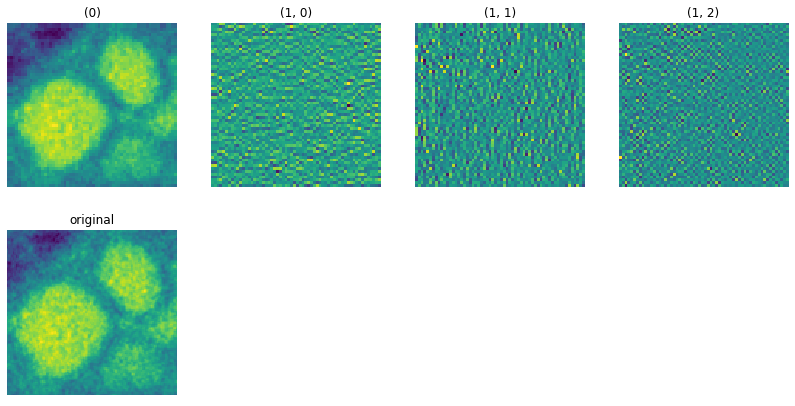

In [310]:
test_wavelet_img(label2limg[val2label[2]][0], 'db2', 1, ksigma=0.0, plot_bar=False)

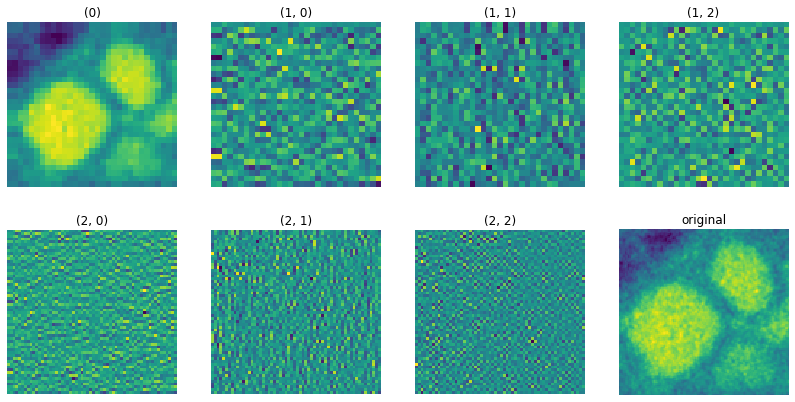

In [311]:
test_wavelet_img(label2limg[val2label[2]][0], 'db2', 2, ksigma=0.0, plot_bar=False)

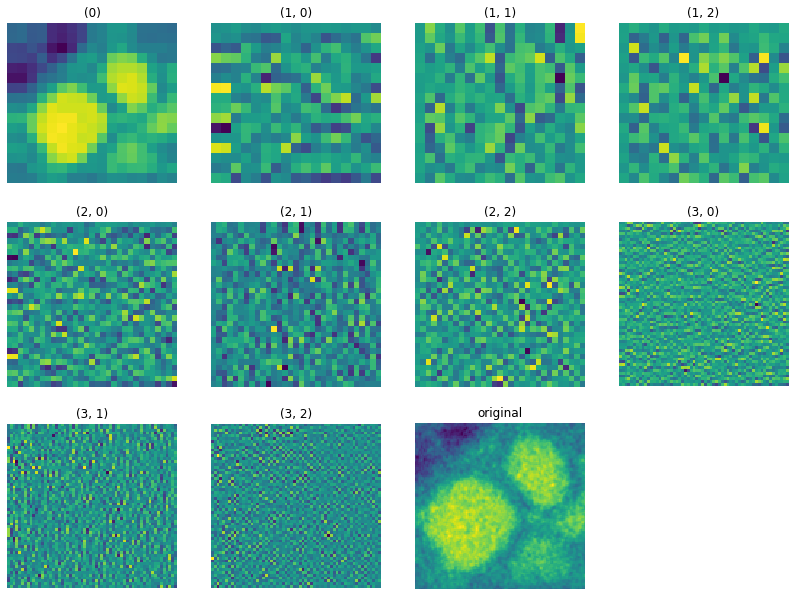

In [312]:
test_wavelet_img(label2limg[val2label[2]][0], 'db2', 3, ksigma=0.0, plot_bar=False)

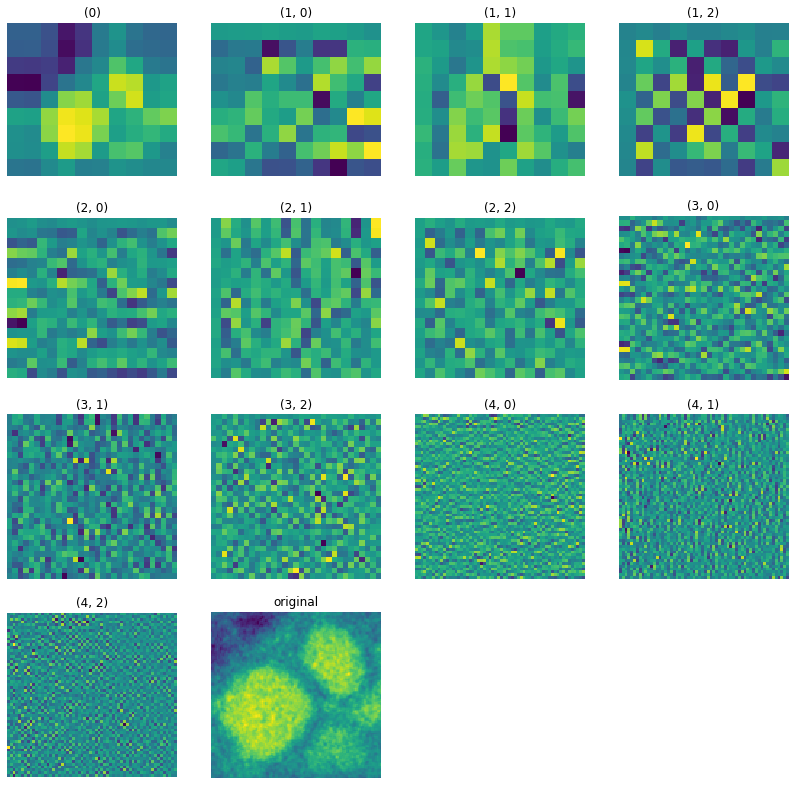

In [313]:
test_wavelet_img(label2limg[val2label[2]][0], 'db2', 4, ksigma=0.0, plot_bar=False)

## ODE Net

In [10]:
import torch
import torch.nn as nn
import torch.optim as optim

from neuode.interface.common import DynamicMap
from neuode.interface.struct import (
    ODEBlockSpec, ConvSpec, SequentialSpec, FFJORDProbDMapSpec,
    ActivationFn, DivSpec,
)
from neuode.dynamics.conv import ConcatSquashConv2d
from neuode.dynamics.composite import build_dmap, SequentialListDMap
from neuode.dynamics.odeblock import ODEBlock
from neuode.dynamics.ffjord_block import FFJORDProbDMap, FFJORDBlock
from neuode.util.util import log_normal_pdf, actfn2nn
from neuode.util.logging import logger

In [11]:
def alllabel2onehot(y, nclass):
    py = np.zeros(y.shape + (nclass,))
    for c in range(nclass):
        py[..., c][y == c] = 1.0
    py = np.transpose(py, (2, 0, 1))
    return py

In [39]:
IDX = 0
ximg = allrimg[IDX]
ylabel = allalllabel[IDX]
xname = allskey[IDX]
print(ximg.shape, ylabel.shape, xname)

(7248, 7248) (7248, 7248) CL_T4R_180807_01


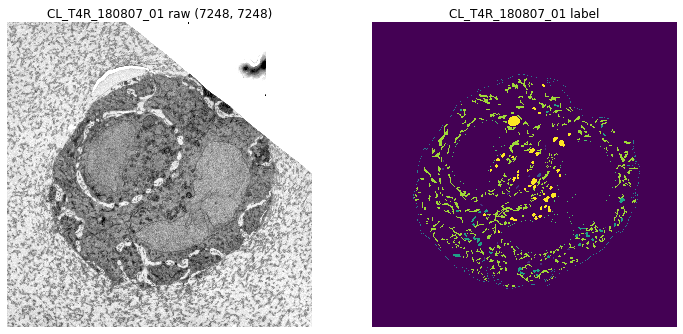

In [40]:
SZ = 6
fig, axs = plt.subplots(ncols=2, figsize=(2*SZ, N*SZ))
axs[0].imshow(ximg[::8, ::8], cmap='gray')
axs[0].set_title(f'{xname} raw {ximg.shape}')
axs[1].imshow(ylabel[::8, ::8])
axs[1].set_title(f'{xname} label')
for ax in axs.flatten(): ax.axis('off')

In [41]:
def downsample_label(img, dsr):
    return block_reduce(img, (1, dsr, dsr), np.mean)


def extract_window(lx, rx, ly, ry, nclass, dsr=1):
    if dsr == 1:
        return ximg[lx:rx:dsr, ly:ry:dsr], \
            ylabel[lx:rx:dsr, ly:ry:dsr], \
            alllabel2onehot(ylabel[lx:rx, ly:ry], nclass)
    return ximg[lx:rx:dsr, ly:ry:dsr], \
        ylabel[lx:rx:dsr, ly:ry:dsr], \
        downsample_label(alllabel2onehot(ylabel[lx:rx, ly:ry], nclass), dsr)


def make_hierarichical_dsr(img, dsrs):
    hdsr = []
    for dsr in dsrs:
        hdsr.append(downsample_label(img, dsr))
    return hdsr

In [42]:
def show_triplet(ximg_sel, ylabel_sel, yprob_sel, C=6, DSR=1, cmap='viridis'):
    SZ = 6
    fig, axs = plt.subplots(ncols=3, figsize=(2*SZ, N*SZ))
    axs[0].imshow(ximg_sel[::DSR, ::DSR], cmap='gray')
    axs[0].set_title(f'{xname} raw {ximg_sel.shape}')
    axs[1].imshow(ylabel_sel[::DSR, ::DSR], cmap=cmap)
    axs[1].set_title(f'label')
    axs[2].imshow(yprob_sel[C, ::DSR, ::DSR])
    axs[2].set_title(f'class {C}')
    for ax in axs.flatten(): ax.axis('off')

(1600, 1600) (1600, 1600) (8, 1600, 1600)


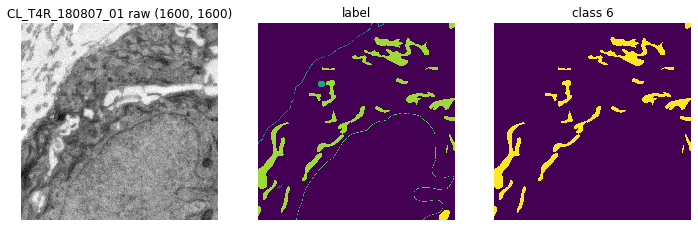

In [43]:
ximg_sel, ylabel_sel, yprob_sel = extract_window(1600, 3200, 1600, 3200, 8)
print(ximg_sel.shape, ylabel_sel.shape, yprob_sel.shape)
show_triplet(ximg_sel, ylabel_sel, yprob_sel, DSR=8)

(100, 100) (100, 100) (8, 100, 100)


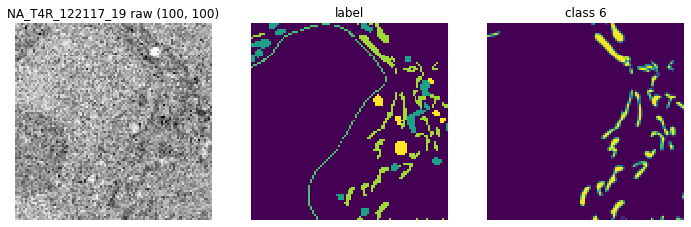

In [17]:
ximg_dsr, ylabel_dsr, yprob_dsr = extract_window(1600, 3200, 1600, 3200, 8, 16)
print(ximg_dsr.shape, ylabel_dsr.shape, yprob_dsr.shape)
show_triplet(ximg_dsr, ylabel_dsr, yprob_dsr)

### MSeg 1 Layer with ODENet + ConcatSquashConv

In [96]:
class AppendZeros(nn.Module):
    
    def __init__(self, dim):
        super(AppendZeros, self).__init__()
        self.dim = dim
        
        
    def forward(self, t, x):
        # append zero gradient to expanded features
        z = torch.zeros(x.shape[0], self.dim, x.shape[2], x.shape[3])
        return torch.cat([x, z], 1)
    
    
def make_truncate_logpz(dim_latent, dim_reduce=None):
    def truncate_logpz(x):
        # compute prob only for the first dim_latent channels
        x = x[:, :dim_latent, ...]
        x = -x.pow(2)
        if dim_reduce != None:
            x = x.mean(dim_reduce, keepdim=True)
        return x
#     def truncate_logpz(x):
#         # compute prob only for the first dim_latent channels
#         x = x[:, :dim_latent, ...]
#         return x.tanh()
    return truncate_logpz


class MSegNet(nn.Module):
    
    def __init__(self, dim_in, dim_latent, nclasses):
        super(MSegNet, self).__init__()
        self.dim_latent = dim_latent
        self.nclasses = nclasses
        
        # expand from image to higher-dim feature maps
        EXDIM = 64
        self.expand_cfn = nn.Sequential(
            nn.Conv2d(dim_in, EXDIM, kernel_size=3, stride=1, padding=1),
            actfn2nn(ActivationFn.RELU),
            nn.Conv2d(EXDIM, EXDIM, kernel_size=3, stride=1, padding=1),
            actfn2nn(ActivationFn.RELU),
        )

        # convolution dynamics
        MIDDIM = 128
        cdfn = SequentialListDMap([
            ConcatSquashConv2d(dim_latent+EXDIM, MIDDIM, actfn=ActivationFn.TANH),
            ConcatSquashConv2d(MIDDIM, MIDDIM, actfn=ActivationFn.TANH),
            ConcatSquashConv2d(MIDDIM, dim_latent+EXDIM, actfn=ActivationFn.NONE),
#             AppendZeros(EXDIM),
        ])
#         cdfn_aug = FFJORDProbDMap(cdfn, FFJORDProbDMapSpec(
#             DivSpec(kind='bruteforce'),
#             # DivSpec(kind='approx', dist='normal'),
#             # DivSpec(kind='approx', dist='rademacher'),
#         ))
#         self.cdfn_block = FFJORDBlock(
#             cdfn_aug,
#             ODEBlockSpec(use_adjoint=True),
#             pdf_z=make_truncate_logpz(self.dim_latent, dim_reduce=2)
#         )
        self.cdfn_block = ODEBlock(
            cdfn,
            ODEBlockSpec(use_adjoint=True)
        )
    
        self.logpdf = make_truncate_logpz(self.dim_latent, dim_reduce=None)
    
    
    def forward(self, x):
        # lift to higher-dim feature and prepend with latent variables
        x = self.expand_cfn(x)
        z = torch.zeros(x.shape[0], self.dim_latent, x.shape[2], x.shape[3])
        x = torch.cat([z, x], 1)
        
        # step through dynamics
        logpx = self.cdfn_block(x)
        
        # turn to probability
        logpx = self.logpdf(logpx)
        
        return logpx

In [107]:
segnet = MSegNet(1, 8, 8)

(8, 100, 100)
torch.Size([1, 1, 100, 100]) torch.Size([1, 8, 100, 100]) (8, 100, 100)


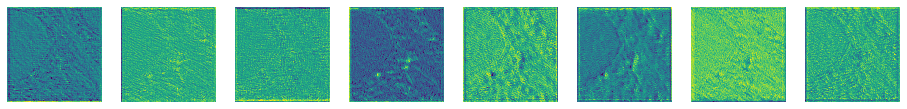

In [98]:
def show_pred(logpx, cap=None, M=8, SZ=2):
    N = (logpx.shape[0] - 1) // M + 1
    px = np.exp(logpx) / np.tile(np.exp(logpx).sum(0)[None, ...], (logpx.shape[0], 1, 1))
    fig, axes = plt.subplots(nrows=N, ncols=M, figsize=(SZ*M, SZ*N)); axes = axes.flatten()
    for ax, lpx in zip(axes, px):
        if cap is None:
            ax.imshow(lpx)
        else:
            z = np.zeros(lpx.shape); z[lpx > cap] = 1.0
            ax.imshow(z)
        ax.axis('off')

ximg_dsr_t = torch.Tensor(ximg_dsr)[None, None, ...]
yprob_dsr_t = torch.Tensor(yprob_dsr)[None, ...]

with torch.no_grad():
    logpx = segnet(ximg_dsr_t).detach().numpy()[0]
    print(logpx.shape)
show_pred(logpx)
print(ximg_dsr_t.shape, yprob_dsr_t.shape, logpx.shape)

INFO [2019-11-03 01:53:49,907]: Epoch   0: loss= 1.396630


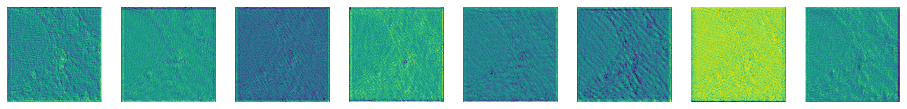

INFO [2019-11-03 01:53:53,962]: Epoch   1: loss= 1.395518


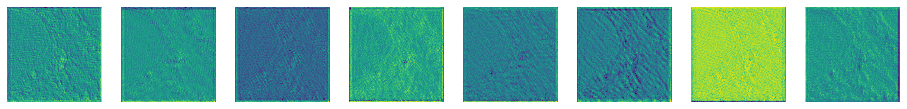

INFO [2019-11-03 01:53:57,643]: Epoch   2: loss= 1.393677


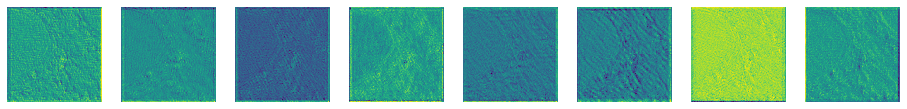

INFO [2019-11-03 01:54:01,189]: Epoch   3: loss= 1.391549


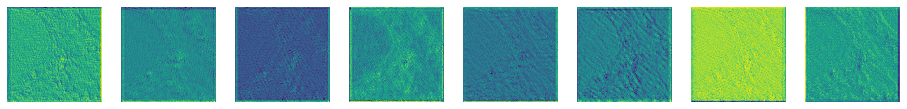

INFO [2019-11-03 01:54:05,123]: Epoch   4: loss= 1.389361


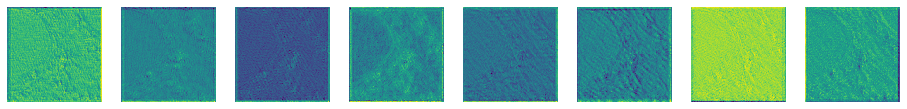

INFO [2019-11-03 01:54:09,072]: Epoch   5: loss= 1.387186
INFO [2019-11-03 01:54:12,599]: Epoch   6: loss= 1.385083
INFO [2019-11-03 01:54:15,929]: Epoch   7: loss= 1.383088
INFO [2019-11-03 01:54:19,243]: Epoch   8: loss= 1.381215
INFO [2019-11-03 01:54:23,406]: Epoch   9: loss= 1.379459
INFO [2019-11-03 01:54:27,802]: Epoch  10: loss= 1.377787


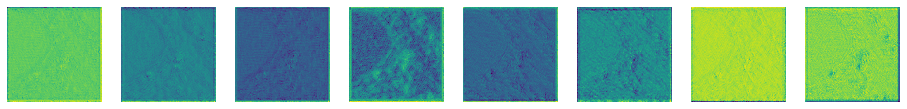

INFO [2019-11-03 01:54:31,662]: Epoch  11: loss= 1.376144
INFO [2019-11-03 01:54:35,282]: Epoch  12: loss= 1.374469
INFO [2019-11-03 01:54:39,669]: Epoch  13: loss= 1.372692
INFO [2019-11-03 01:54:43,229]: Epoch  14: loss= 1.370725
INFO [2019-11-03 01:54:47,290]: Epoch  15: loss= 1.368442
INFO [2019-11-03 01:54:51,270]: Epoch  16: loss= 1.365688
INFO [2019-11-03 01:54:55,873]: Epoch  17: loss= 1.362296
INFO [2019-11-03 01:54:59,561]: Epoch  18: loss= 1.358100
INFO [2019-11-03 01:55:03,292]: Epoch  19: loss= 1.352946
INFO [2019-11-03 01:55:08,230]: Epoch  20: loss= 1.346699


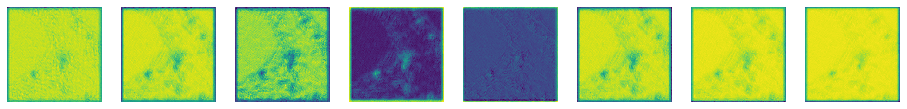

INFO [2019-11-03 01:55:13,808]: Epoch  21: loss= 1.339288
INFO [2019-11-03 01:55:17,757]: Epoch  22: loss= 1.330762
INFO [2019-11-03 01:55:21,317]: Epoch  23: loss= 1.321344
INFO [2019-11-03 01:55:24,841]: Epoch  24: loss= 1.311457
INFO [2019-11-03 01:55:28,353]: Epoch  25: loss= 1.301644
INFO [2019-11-03 01:55:32,702]: Epoch  26: loss= 1.292405
INFO [2019-11-03 01:55:36,913]: Epoch  27: loss= 1.284040
INFO [2019-11-03 01:55:41,388]: Epoch  28: loss= 1.276597
INFO [2019-11-03 01:55:45,323]: Epoch  29: loss= 1.269930
INFO [2019-11-03 01:55:49,065]: Epoch  30: loss= 1.263819


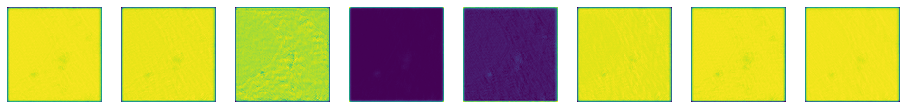

INFO [2019-11-03 01:55:52,997]: Epoch  31: loss= 1.258048
INFO [2019-11-03 01:55:56,755]: Epoch  32: loss= 1.252442
INFO [2019-11-03 01:56:00,425]: Epoch  33: loss= 1.246862
INFO [2019-11-03 01:56:04,133]: Epoch  34: loss= 1.241175
INFO [2019-11-03 01:56:08,179]: Epoch  35: loss= 1.235241
INFO [2019-11-03 01:56:11,859]: Epoch  36: loss= 1.228903
INFO [2019-11-03 01:56:15,526]: Epoch  37: loss= 1.222001
INFO [2019-11-03 01:56:19,282]: Epoch  38: loss= 1.214396
INFO [2019-11-03 01:56:23,031]: Epoch  39: loss= 1.206024
INFO [2019-11-03 01:56:26,788]: Epoch  40: loss= 1.196951


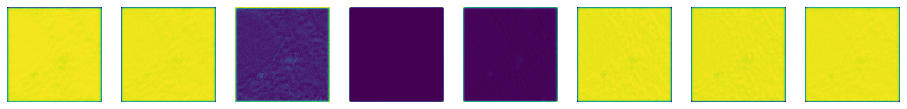

INFO [2019-11-03 01:56:30,831]: Epoch  41: loss= 1.187412
INFO [2019-11-03 01:56:34,494]: Epoch  42: loss= 1.177816
INFO [2019-11-03 01:56:38,301]: Epoch  43: loss= 1.168682
INFO [2019-11-03 01:56:42,051]: Epoch  44: loss= 1.160507
INFO [2019-11-03 01:56:45,794]: Epoch  45: loss= 1.153623
INFO [2019-11-03 01:56:49,546]: Epoch  46: loss= 1.148128
INFO [2019-11-03 01:56:53,280]: Epoch  47: loss= 1.143919
INFO [2019-11-03 01:56:56,974]: Epoch  48: loss= 1.140784
INFO [2019-11-03 01:57:00,673]: Epoch  49: loss= 1.138479
INFO [2019-11-03 01:57:04,381]: Epoch  50: loss= 1.136782


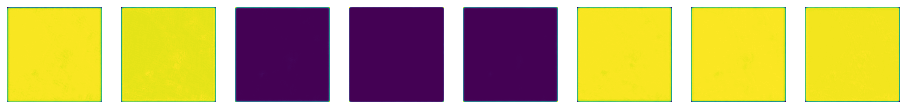

INFO [2019-11-03 01:57:08,693]: Epoch  51: loss= 1.135517
INFO [2019-11-03 01:57:12,390]: Epoch  52: loss= 1.134555
INFO [2019-11-03 01:57:16,328]: Epoch  53: loss= 1.133801
INFO [2019-11-03 01:57:21,039]: Epoch  54: loss= 1.133193
INFO [2019-11-03 01:57:26,277]: Epoch  55: loss= 1.132684
INFO [2019-11-03 01:57:31,687]: Epoch  56: loss= 1.132243
INFO [2019-11-03 01:57:36,544]: Epoch  57: loss= 1.131848
INFO [2019-11-03 01:57:40,835]: Epoch  58: loss= 1.131485
INFO [2019-11-03 01:57:45,164]: Epoch  59: loss= 1.131142
INFO [2019-11-03 01:57:49,193]: Epoch  60: loss= 1.130813


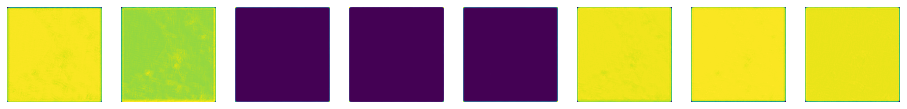

INFO [2019-11-03 01:57:53,925]: Epoch  61: loss= 1.130495
INFO [2019-11-03 01:57:58,857]: Epoch  62: loss= 1.130188
INFO [2019-11-03 01:58:02,814]: Epoch  63: loss= 1.129894
INFO [2019-11-03 01:58:06,499]: Epoch  64: loss= 1.129615
INFO [2019-11-03 01:58:09,890]: Epoch  65: loss= 1.129351
INFO [2019-11-03 01:58:14,476]: Epoch  66: loss= 1.129101
INFO [2019-11-03 01:58:19,212]: Epoch  67: loss= 1.128863
INFO [2019-11-03 01:58:24,150]: Epoch  68: loss= 1.128632
INFO [2019-11-03 01:58:28,792]: Epoch  69: loss= 1.128403
INFO [2019-11-03 01:58:33,386]: Epoch  70: loss= 1.128170


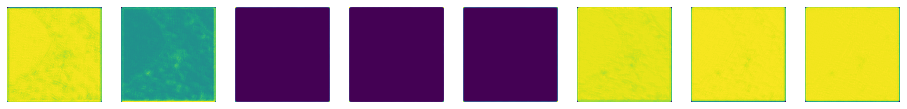

INFO [2019-11-03 01:58:37,690]: Epoch  71: loss= 1.127929
INFO [2019-11-03 01:58:42,110]: Epoch  72: loss= 1.127679
INFO [2019-11-03 01:58:46,589]: Epoch  73: loss= 1.127419
INFO [2019-11-03 01:58:51,085]: Epoch  74: loss= 1.127151
INFO [2019-11-03 01:58:55,689]: Epoch  75: loss= 1.126878
INFO [2019-11-03 01:58:59,983]: Epoch  76: loss= 1.126603
INFO [2019-11-03 01:59:04,160]: Epoch  77: loss= 1.126329
INFO [2019-11-03 01:59:08,496]: Epoch  78: loss= 1.126058
INFO [2019-11-03 01:59:13,127]: Epoch  79: loss= 1.125788
INFO [2019-11-03 01:59:17,513]: Epoch  80: loss= 1.125511


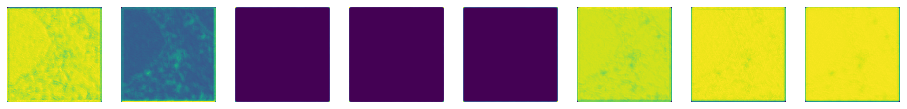

INFO [2019-11-03 01:59:22,236]: Epoch  81: loss= 1.125220
INFO [2019-11-03 01:59:26,394]: Epoch  82: loss= 1.124909
INFO [2019-11-03 01:59:30,904]: Epoch  83: loss= 1.124586
INFO [2019-11-03 01:59:35,119]: Epoch  84: loss= 1.124263
INFO [2019-11-03 01:59:38,761]: Epoch  85: loss= 1.123949
INFO [2019-11-03 01:59:42,421]: Epoch  86: loss= 1.123641
INFO [2019-11-03 01:59:46,136]: Epoch  87: loss= 1.123330
INFO [2019-11-03 01:59:49,887]: Epoch  88: loss= 1.123006
INFO [2019-11-03 01:59:54,079]: Epoch  89: loss= 1.122657
INFO [2019-11-03 01:59:58,990]: Epoch  90: loss= 1.122277


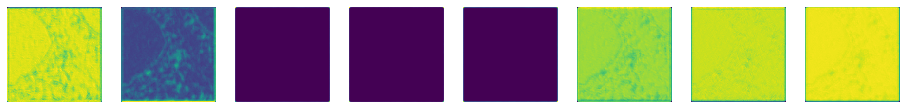

INFO [2019-11-03 01:00:03,698]: Epoch  91: loss= 1.121865
INFO [2019-11-03 01:00:08,161]: Epoch  92: loss= 1.121422
INFO [2019-11-03 01:00:12,324]: Epoch  93: loss= 1.120953
INFO [2019-11-03 01:00:16,159]: Epoch  94: loss= 1.120460
INFO [2019-11-03 01:00:19,806]: Epoch  95: loss= 1.119944
INFO [2019-11-03 01:00:24,923]: Epoch  96: loss= 1.119403
INFO [2019-11-03 01:00:29,318]: Epoch  97: loss= 1.118835
INFO [2019-11-03 01:00:34,063]: Epoch  98: loss= 1.118238
INFO [2019-11-03 01:00:38,522]: Epoch  99: loss= 1.117619
INFO [2019-11-03 01:00:42,889]: Epoch 100: loss= 1.116984


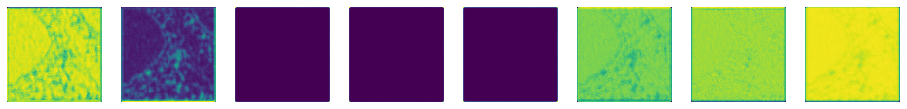

INFO [2019-11-03 01:00:47,250]: Epoch 101: loss= 1.116340
INFO [2019-11-03 01:00:50,962]: Epoch 102: loss= 1.115680
INFO [2019-11-03 01:00:54,654]: Epoch 103: loss= 1.114986
INFO [2019-11-03 01:00:58,348]: Epoch 104: loss= 1.114243
INFO [2019-11-03 01:01:02,211]: Epoch 105: loss= 1.113446
INFO [2019-11-03 01:01:05,940]: Epoch 106: loss= 1.112606
INFO [2019-11-03 01:01:09,611]: Epoch 107: loss= 1.111758
INFO [2019-11-03 01:01:13,767]: Epoch 108: loss= 1.110925
INFO [2019-11-03 01:01:19,081]: Epoch 109: loss= 1.110078
INFO [2019-11-03 01:01:24,034]: Epoch 110: loss= 1.109162


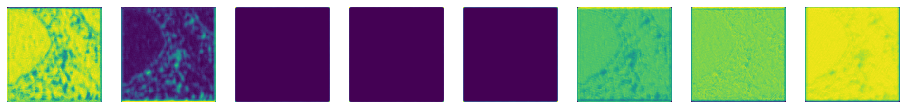

INFO [2019-11-03 01:01:27,876]: Epoch 111: loss= 1.108156
INFO [2019-11-03 01:01:33,219]: Epoch 112: loss= 1.107075
INFO [2019-11-03 01:01:37,189]: Epoch 113: loss= 1.105949
INFO [2019-11-03 01:01:41,073]: Epoch 114: loss= 1.104775
INFO [2019-11-03 01:01:46,033]: Epoch 115: loss= 1.103533
INFO [2019-11-03 01:01:49,957]: Epoch 116: loss= 1.102202
INFO [2019-11-03 01:01:54,150]: Epoch 117: loss= 1.100779
INFO [2019-11-03 01:01:57,867]: Epoch 118: loss= 1.099281
INFO [2019-11-03 01:02:02,606]: Epoch 119: loss= 1.097726
INFO [2019-11-03 01:02:06,366]: Epoch 120: loss= 1.096109


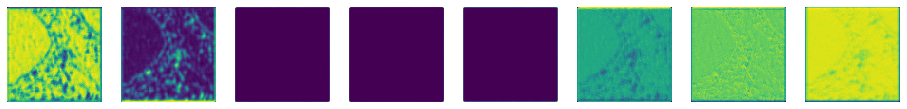

INFO [2019-11-03 01:02:10,837]: Epoch 121: loss= 1.094402
INFO [2019-11-03 01:02:14,525]: Epoch 122: loss= 1.092560
INFO [2019-11-03 01:02:18,483]: Epoch 123: loss= 1.090558
INFO [2019-11-03 01:02:22,300]: Epoch 124: loss= 1.088388
INFO [2019-11-03 01:02:26,041]: Epoch 125: loss= 1.086062
INFO [2019-11-03 01:02:29,784]: Epoch 126: loss= 1.083591
INFO [2019-11-03 01:02:33,986]: Epoch 127: loss= 1.080973
INFO [2019-11-03 01:02:37,654]: Epoch 128: loss= 1.078176
INFO [2019-11-03 01:02:41,239]: Epoch 129: loss= 1.075166
INFO [2019-11-03 01:02:45,128]: Epoch 130: loss= 1.071918


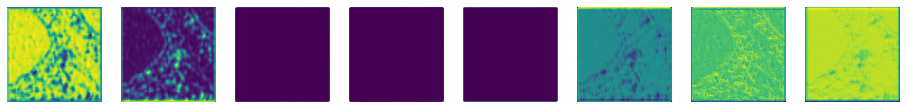

INFO [2019-11-03 01:02:49,328]: Epoch 131: loss= 1.068426
INFO [2019-11-03 01:02:54,524]: Epoch 132: loss= 1.064672
INFO [2019-11-03 01:02:59,231]: Epoch 133: loss= 1.060625
INFO [2019-11-03 01:03:03,080]: Epoch 134: loss= 1.056255
INFO [2019-11-03 01:03:07,136]: Epoch 135: loss= 1.051535
INFO [2019-11-03 01:03:11,003]: Epoch 136: loss= 1.046453
INFO [2019-11-03 01:03:14,634]: Epoch 137: loss= 1.041005
INFO [2019-11-03 01:03:18,268]: Epoch 138: loss= 1.035192
INFO [2019-11-03 01:03:22,482]: Epoch 139: loss= 1.029031
INFO [2019-11-03 01:03:27,076]: Epoch 140: loss= 1.022602


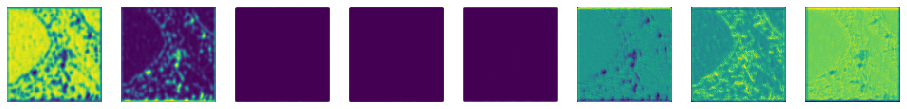

INFO [2019-11-03 01:03:31,247]: Epoch 141: loss= 1.016096
INFO [2019-11-03 01:03:35,024]: Epoch 142: loss= 1.009422
INFO [2019-11-03 01:03:38,875]: Epoch 143: loss= 1.002229
INFO [2019-11-03 01:03:42,583]: Epoch 144: loss= 0.994517
INFO [2019-11-03 01:03:46,289]: Epoch 145: loss= 0.986555
INFO [2019-11-03 01:03:49,982]: Epoch 146: loss= 0.978417
INFO [2019-11-03 01:03:53,791]: Epoch 147: loss= 0.970080
INFO [2019-11-03 01:03:57,541]: Epoch 148: loss= 0.961611
INFO [2019-11-03 01:04:01,296]: Epoch 149: loss= 0.953061
INFO [2019-11-03 01:04:05,011]: Epoch 150: loss= 0.944444


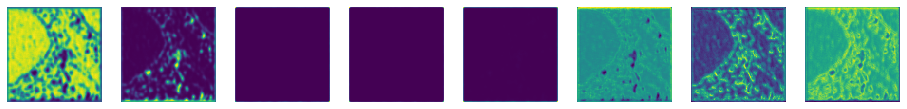

INFO [2019-11-03 01:04:09,238]: Epoch 151: loss= 0.935840
INFO [2019-11-03 01:04:12,876]: Epoch 152: loss= 0.927323
INFO [2019-11-03 01:04:16,927]: Epoch 153: loss= 0.918918
INFO [2019-11-03 01:04:20,585]: Epoch 154: loss= 0.910649
INFO [2019-11-03 01:04:24,462]: Epoch 155: loss= 0.902709
INFO [2019-11-03 01:04:28,349]: Epoch 156: loss= 0.897676
INFO [2019-11-03 01:04:32,656]: Epoch 157: loss= 0.928589
INFO [2019-11-03 01:04:36,918]: Epoch 158: loss= 1.318508
INFO [2019-11-03 01:04:41,119]: Epoch 159: loss= 0.948505
INFO [2019-11-03 01:04:44,901]: Epoch 160: loss= 1.651403


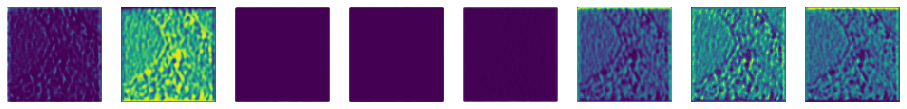

INFO [2019-11-03 01:04:48,781]: Epoch 161: loss= 1.089988
INFO [2019-11-03 01:04:52,448]: Epoch 162: loss= 1.156660
INFO [2019-11-03 01:04:56,401]: Epoch 163: loss= 1.086885
INFO [2019-11-03 01:05:00,088]: Epoch 164: loss= 1.079133
INFO [2019-11-03 01:05:03,751]: Epoch 165: loss= 1.076261
INFO [2019-11-03 01:05:07,388]: Epoch 166: loss= 1.078541
INFO [2019-11-03 01:05:10,977]: Epoch 167: loss= 1.067596
INFO [2019-11-03 01:05:14,721]: Epoch 168: loss= 1.073283
INFO [2019-11-03 01:05:18,528]: Epoch 169: loss= 1.063409
INFO [2019-11-03 01:05:22,085]: Epoch 170: loss= 1.064961


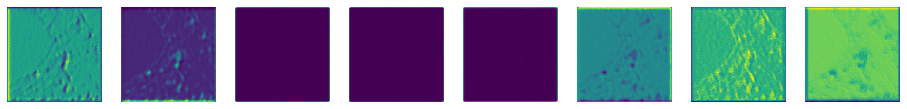

INFO [2019-11-03 01:05:26,266]: Epoch 171: loss= 1.055316
INFO [2019-11-03 01:05:29,996]: Epoch 172: loss= 1.056427
INFO [2019-11-03 01:05:34,116]: Epoch 173: loss= 1.042282
INFO [2019-11-03 01:05:37,919]: Epoch 174: loss= 1.035232
INFO [2019-11-03 01:05:41,688]: Epoch 175: loss= 1.030827
INFO [2019-11-03 01:05:45,289]: Epoch 176: loss= 1.021100
INFO [2019-11-03 01:05:49,023]: Epoch 177: loss= 1.013012
INFO [2019-11-03 01:05:52,739]: Epoch 178: loss= 1.004976
INFO [2019-11-03 01:05:56,594]: Epoch 179: loss= 0.999480
INFO [2019-11-03 01:06:00,591]: Epoch 180: loss= 0.988751


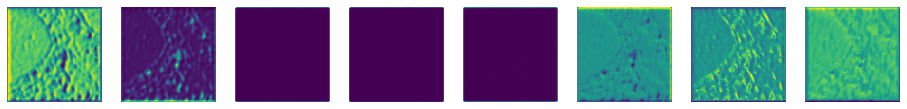

INFO [2019-11-03 01:06:05,796]: Epoch 181: loss= 0.984050
INFO [2019-11-03 01:06:10,003]: Epoch 182: loss= 0.981670


KeyboardInterrupt: 

In [108]:
# def extreme_loss(logpx, px_true):
#     with torch.enable_grad():
#         px = torch.exp(logpx)
#         true_idx = px_true > 0.5
#         return -(torch.mean(logpx[true_idx]) - torch.mean(px[~true_idx]))
#         n_logpx = logpx[true_idx].shape[0] + logpx[~true_idx].shape[0]
#         return -(torch.sum(logpx[true_idx]) - torch.sum(px[~true_idx])) / n_logpx
#         return -torch.mean(px_true * logpx + (1 - px_true) * torch.log(1 - px))
#         return torch.mean(c_px) + torch.mean(nc_px)  # TODO: BCELoss?

EPS = 1e-4
def extreme_loss(logpx, px_true):
    n_classes = logpx.shape[1]
    logpx = logpx - torch.logsumexp(logpx, 1, keepdim=True).repeat(1, n_classes, 1, 1)
    with torch.enable_grad():
        sum_class = 0.0
        for c in range(n_classes):
            lpx = logpx[:, c, ...]
            pxtc = px_true[:, c, ...]
            if pxtc.sum() < EPS:
                continue
#             true_idx = px_true[:, c, ...] > 0.5
#             if true_idx.sum() == 0:
#                 continue
#             sum_class += -(torch.mean(lpx[true_idx]) - torch.mean(torch.exp(lpx[~true_idx])))
            sum_class += -(pxtc * lpx).sum() / (pxtc.sum()) \
                        + ((1-pxtc) * torch.exp(lpx)).sum() / ((1-pxtc).sum())
    return sum_class / n_classes


def px2pc(px):
    n_batch, n_classes, n = px.shape
    pc = px.reshape(n_batch, n_classes, -1).mean(-1)
    pc_total = pc.sum(-1)
    return pc / pc_total


# EPS = 1e-4
# def extreme_loss(logpx, px_true):
#     n_batch, n_classes, nh, nw = logpx.shape
#     logpx = logpx.reshape(n_batch, n_classes, -1)
#     px_true = px_true.reshape(n_batch, n_classes, -1)
#     logpx = logpx - torch.logsumexp(logpx, 1, keepdim=True)
#     with torch.enable_grad():
#         px = torch.exp(logpx)
#         print(logpx[0, :, :5])
#         print(px_true[0, :, :5])
#         pc = px2pc(px)
#         pc_true = px2pc(px_true)
#         print(list(pc))
#         print(list(pc_true))
#         pct_ok = pc_true > EPS
#         pxt_ok = px_true > EPS
        
        
#         # class density KL(q(c) || p(c))
# #         sum_class = (pc_true[pct_ok] * torch.log(pc_true[pct_ok] / pc[pct_ok])).sum(-1).mean(-1)
# #         sum_class = -(pc_true[pct_ok] * torch.log(pc[pct_ok])).mean(-1).mean(-1)
# #         sum_class = -(pc_true * torch.log(pc + EPS)).sum(-1).mean(-1)
#         sum_class = torch.zeros(1)
        
#         # class distribution over image KL(q(x | c) || p(x | c))
# #         sum_dist = (pc_true[pct_ok]
# #                     * (px_true[pxt_ok] * torch.log(px_true[pxt_ok] / px[pxt_ok])).sum(-1)).sum(-1).mean(-1)
# #         sum_dist = -(pc_true
# #                     * (px_true * logpx).mean(-1)).sum(-1).mean(-1)
#         sum_dist = -((px_true * logpx).sum(-1)).mean(0)
# #         print(sum_dist)
#         sum_dist = sum_dist.mean(-1)
# #         sum_dist = -(pc_true * (px_true * logpx).sum(-1)).sum(-1).mean(-1)

#         # KL(q(x, c) || p(x, c))
#         total = (sum_class + sum_dist)
#         print(total.item(), sum_class.item(), sum_dist.item())
#     return total


NEPOCH = 500
LR = 0.003
optimizer = optim.SGD(segnet.parameters(), lr=LR, momentum=0.9)
for epoch in range(NEPOCH):
    optimizer.zero_grad()
    logpx = segnet(ximg_dsr_t)
    loss = extreme_loss(logpx, yprob_dsr_t)
    loss.backward()
    optimizer.step()
    
    logger.info('Epoch %3d: loss= %f' % (epoch, loss.item()))
    if epoch < 5 or epoch % 10 == 0 or epoch == NEPOCH-1:
        show_pred(logpx[0].detach().numpy())
        plt.show()

In [93]:
segnet.load_state_dict(torch.load('/home/mixs/Documents/research/neuode/dump/model/segnetall_overfit_2.pth'))

<All keys matched successfully>

In [77]:
torch.save(segnet.state_dict(), '/home/mixs/Documensts/research/neuode/dump/model/segnetall_overfit_2.pth')

torch.Size([1, 8, 100, 100])


/home/mixs/anaconda3/envs/mseg/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in log
  


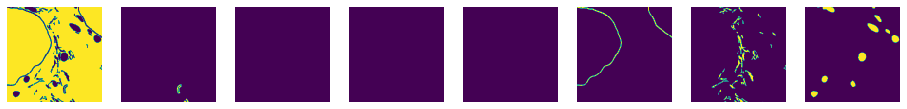

In [73]:
print(yprob_dsr_t.shape)
show_pred(np.log(yprob_dsr_t[0]))

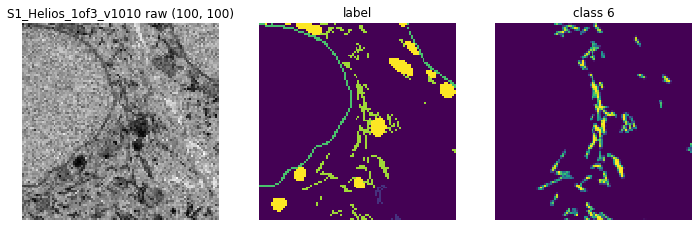

In [41]:
show_triplet(ximg_dsr, ylabel_dsr, yprob_dsr)

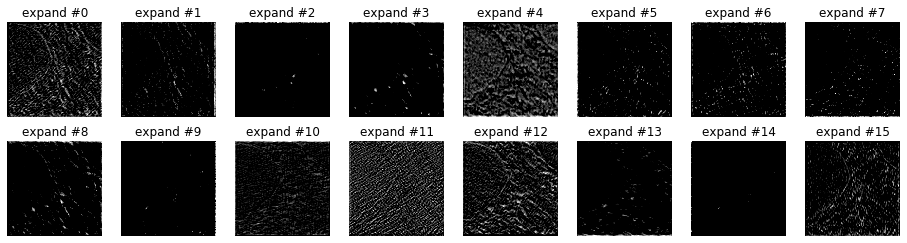

In [42]:
with torch.no_grad():
    ximg_exp = segnet.expand_cfn(ximg_dsr_t)[0, ...].detach().numpy()

C, EXDIM, M, SZ = 6, 16, 8, 2.0
N = (EXDIM - 1) // M + 1
fig, axes = plt.subplots(nrows=N, ncols=M, figsize=(M*SZ, N*SZ)); axes = axes.flatten()
for ax, i in zip(axes, range(EXDIM)):
    ax.imshow(ximg_exp[i], cmap='gray')
    ax.set_title(f'expand #{i}')
    ax.axis('off')

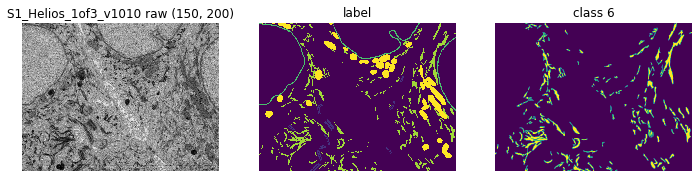

In [422]:
x, y, px = extract_window(1600, 4000, 1600, 4800, 8, dsr=16)
show_triplet(x, y, px)

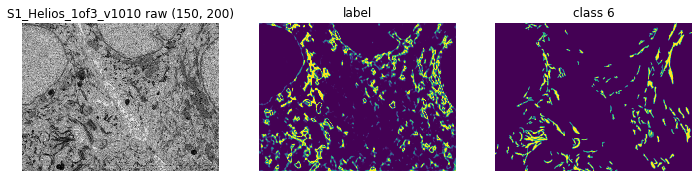

In [49]:
with torch.no_grad():
    logpx = segnet(torch.Tensor(x)[None, None, ...]).detach().numpy()
show_triplet(x, np.exp(logpx[0, 6]), px)

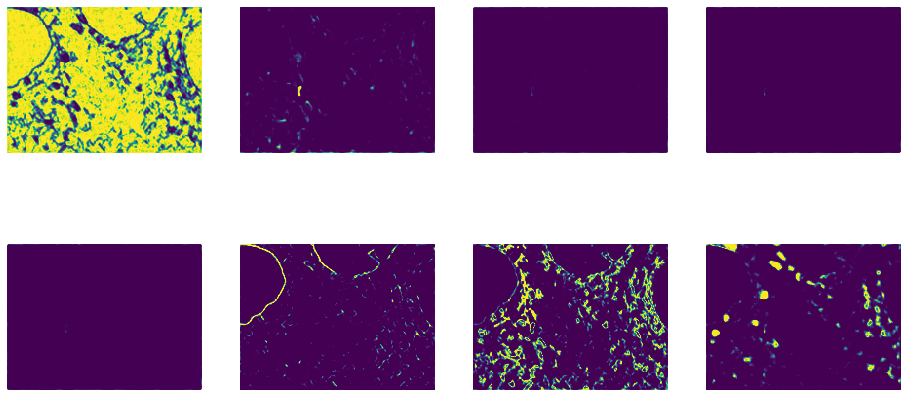

In [50]:
show_pred(logpx[0], M=4, SZ=4)

/home/mixs/anaconda3/envs/mseg/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: divide by zero encountered in log
  """Entry point for launching an IPython kernel.


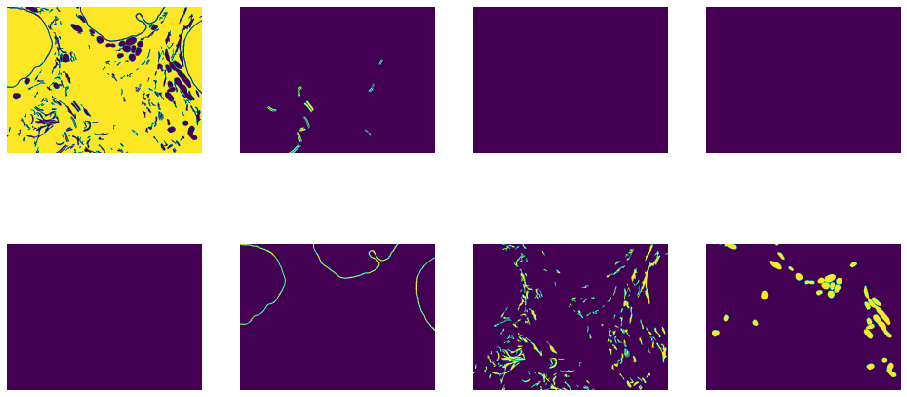

In [184]:
show_pred(np.log(px), M=4, SZ=4)

### UNet + ODE Net

(1600, 1600) (1600, 1600) (8, 1600, 1600)


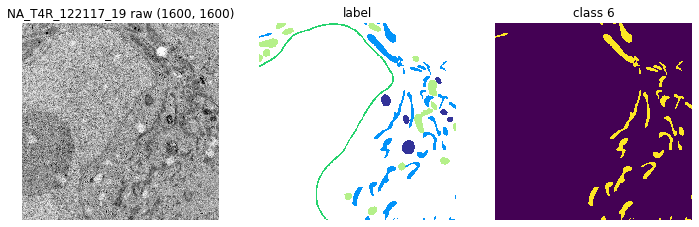

In [31]:
# ximg_sel, ylabel_sel, yprob_sel = extract_window(2300, 2940, 2300, 2940, 8)
ximg_sel, ylabel_sel, yprob_sel = extract_window(1600, 3200, 1600, 3200, 8)
print(ximg_sel.shape, ylabel_sel.shape, yprob_sel.shape)
show_triplet(ximg_sel, -ylabel_sel**1, yprob_sel, DSR=8, cmap='terrain')

(8, 25, 25)
(8, 50, 50)
(8, 100, 100)


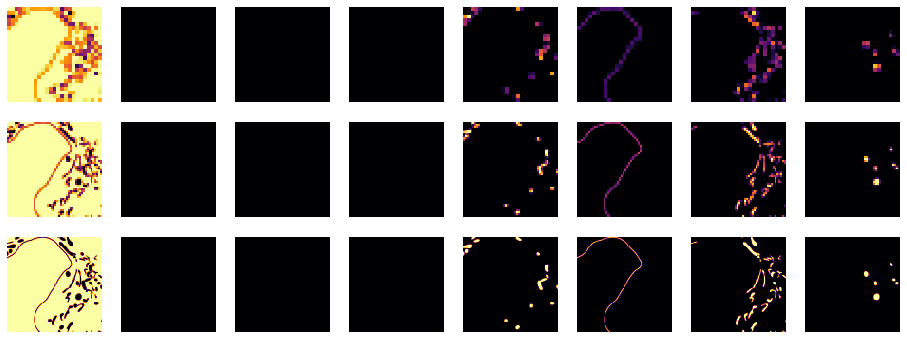

In [32]:
DSR_L = [64, 32, 16]
# DSR_L = [64, 16, 4, 1]
ximg_sel = ximg_sel[::DSR_L[-1], ::DSR_L[-1]]
yprob_sel_dsrs = make_hierarichical_dsr(yprob_sel, DSR_L)
for li in yprob_sel_dsrs:
    print(li.shape)

DSR = 1
N, M, SZ = len(yprob_sel_dsrs), 8, 2
fig, axes = plt.subplots(ncols=M, nrows=N, figsize=(M*SZ, N*SZ))
for axs, li in zip(axes, yprob_sel_dsrs):
    for ax, c in zip(axs, range(8)):
        ax.imshow(li[c, ::DSR, ::DSR], vmax=1.0, vmin=0.0, cmap='inferno')
        ax.axis('off')

In [21]:
def print_shape_list(l, prefix=''):
    if isinstance(l, list) or isinstance(l, tuple):
        lines = [f'length= {len(l)}, type= {type(l)}']
        for li in l:
            lines.append(print_shape_list(li, prefix=prefix + '   '))
        return '\n'.join(lines)
    return prefix + f'{l.shape}'

In [33]:
class MultiResDownsample(nn.Module):
    
    def __init__(self, num_res, scale_factor):
        super(MultiResDownsample, self).__init__()
        self.num_res = num_res
        self.downsample = torch.nn.AvgPool2d(scale_factor, stride=scale_factor)
#         self.downsample = torch.nn.MaxPool2d(scale_factor, stride=scale_factor)
        
        
    def forward(self, x):
        y = []
        for _ in range(self.num_res):
            y.append(x)
            x = self.downsample(x)
        return y[::-1]


class MultiResDMap(DynamicMap):
    
    def __init__(self, num_res, dim_latent, scale_factor):
        super(MultiResDMap, self).__init__()
        
        # gradient function for each resolution
        MIDDIM = dim_latent * 4
        self.mres_nets = nn.ModuleList()
        for _ in range(num_res):
            self.mres_nets.append(SequentialListDMap([
                ConcatSquashConv2d(2*dim_latent, MIDDIM, actfn=ActivationFn.TANH),
                ConcatSquashConv2d(MIDDIM, MIDDIM, actfn=ActivationFn.TANH),
                ConcatSquashConv2d(MIDDIM, dim_latent, actfn=ActivationFn.NONE),
            ]))
        
        # upsampling the gradient
        self.upsample = nn.Upsample(scale_factor=scale_factor, mode='nearest')
        
        
    def forward(self, t, x):
        dxdt = []
        prev_xi = torch.zeros(x[0].shape)
        for net, xi in zip(self.mres_nets, x):
            cat_xi = torch.cat([xi, prev_xi], 1)
            dxidt = net(t, cat_xi)
            prev_xi = self.upsample(dxidt)
            dxdt.append(dxidt)
        return dxdt


class MultiResMLP(nn.Module):
    
    def __init__(self, num_res, dim_in, dim_out):
        super(MultiResMLP, self).__init__()
        
        # separate mlp for each resolution
        MIDDIM = dim_in * 2
        self.mres_nets = nn.ModuleList()
        for _ in range(num_res):
            self.mres_nets.append(nn.Sequential(
                nn.Conv2d(dim_in, MIDDIM, kernel_size=1, stride=1, padding=0),
                actfn2nn(ActivationFn.RELU),
                nn.Conv2d(MIDDIM, dim_out, kernel_size=1, stride=1, padding=0),
            ))
        
        
    def forward(self, x):
        logits = []
        for net, xi in zip(self.mres_nets, x):
            logit = net(xi)
            logits.append(logit)
        return logits


class UNOdeMSegNet(nn.Module):
    
    def __init__(self, dim_in, n_classes, dim_latent, num_res, scale_factor):
        super(UNOdeMSegNet, self).__init__()
        self.num_res = num_res
        
        # expand from image to higher-dim feature maps
        self.expand_cfn = nn.Sequential(
            nn.Conv2d(dim_in, dim_latent, kernel_size=3, stride=1, padding=1),
            actfn2nn(ActivationFn.RELU),
            nn.Conv2d(dim_latent, dim_latent, kernel_size=3, stride=1, padding=1),
            actfn2nn(ActivationFn.RELU),
        )
        
        # downsample to coarser resolution
        self.downsample = MultiResDownsample(num_res, scale_factor)

        # dynamics for each resolution
        mres_cdfn = MultiResDMap(num_res, dim_latent, scale_factor)
        self.cdfn_block = ODEBlock(
            mres_cdfn,
            ODEBlockSpec(use_adjoint=True)
        )
    
        # classify the multi-res feature
        self.classifier = MultiResMLP(num_res, dim_latent, n_classes)
    
    
    def forward(self, x):
        # lift to higher-dim feature and prepend with latent variables
        x = self.expand_cfn(x)
        x = self.downsample(x)
        x = self.cdfn_block(x)
        x = self.classifier(x)
        
        return x

In [34]:
# mrsegnet = UNOdeMSegNet(1, 8, 16, 3, 2)
mrsegnet = UNOdeMSegNet(1, 8, 64, 3, 2)

# mrsegnet = UNOdeMSegNet(1, 8, 32, 4, 4)

torch.Size([1, 1, 100, 100])
[(8, 25, 25), (8, 50, 50), (8, 100, 100)]
[(8, 25, 25), (8, 50, 50), (8, 100, 100)]


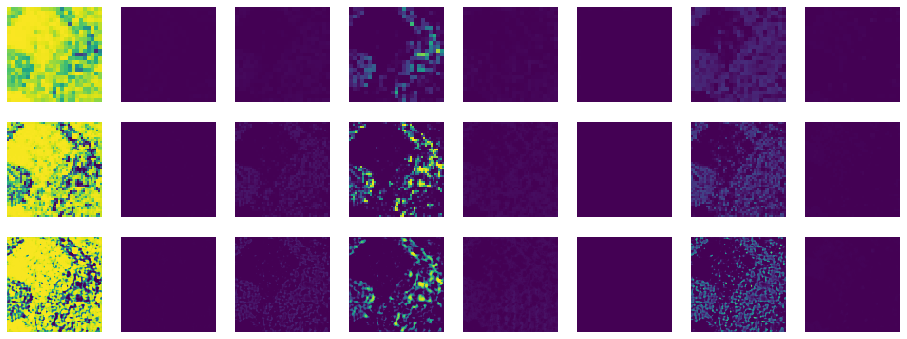

In [36]:
def normalize_image(img):
    return (img - np.mean(img)) / np.std(img)

def logits2px(logits):
    pl = np.exp(logits)
    return pl / np.tile(pl.sum(0)[None, ...], (pl.shape[0], 1, 1))


def mlogits_pick_sample(mlogits, idx=0):
    return [logits.detach().numpy()[idx] for logits in mlogits]
    

def show_pred_mpx(mpx, SZ=2):
    N = len(mpx)
    M = mpx[0].shape[0]
    fig, axes = plt.subplots(nrows=N, ncols=M, figsize=(SZ*M, SZ*N))
    for axs, px in zip(axes, mpx):
        for ax, pxi in zip(axs, px):
            ax.imshow(pxi, vmin=0.0, vmax=1.0)
            ax.axis('off')
            

ximg_dsr_t = torch.Tensor(normalize_image(ximg_sel))[None, None, ...]
yprob_dsr_t = [torch.Tensor(ypi)[None, ...] for ypi in yprob_sel_dsrs]

with torch.no_grad():
    mlogits = mrsegnet(ximg_dsr_t)
    mlogits = mlogits_pick_sample(mlogits)
show_pred_mpx([logits2px(logits) for logits in mlogits])
print(ximg_dsr_t.shape)
print([logits.shape for logits in mlogits])
print([ypi.shape for ypi in yprob_sel_dsrs])

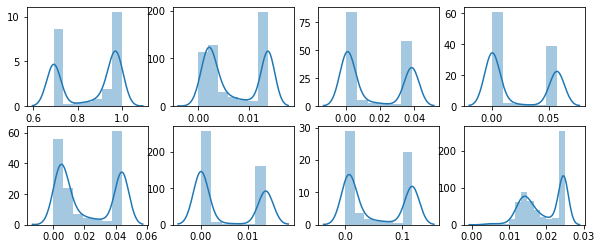

In [53]:
fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(10, 4)); axes = axes.flatten()
for ax, logits in zip(axes, logits2px(mlogits[1])):
    sns.distplot(logits.flatten(), ax=ax)

In [65]:
mlogits_2 = mlogits

In [35]:
mrsegnet.load_state_dict(torch.load('/home/mixs/Documents/research/microseg/dump/gmbs_model_432_0.1432.pth', map_location=torch.device('cpu')))
# mrsegnet.load_state_dict(torch.load('/home/mixs/Documents/research/microseg/dump/greq_model_123_0.1635.pth', map_location=torch.device('cpu')))

<All keys matched successfully>

INFO [2019-11-04 21:40:35,506]: Epoch   0: loss= 0.648183


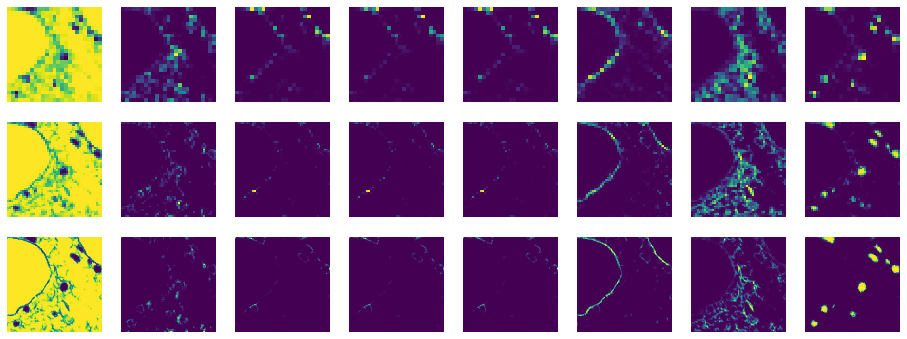

INFO [2019-11-04 21:40:40,372]: Epoch   1: loss= 0.648159


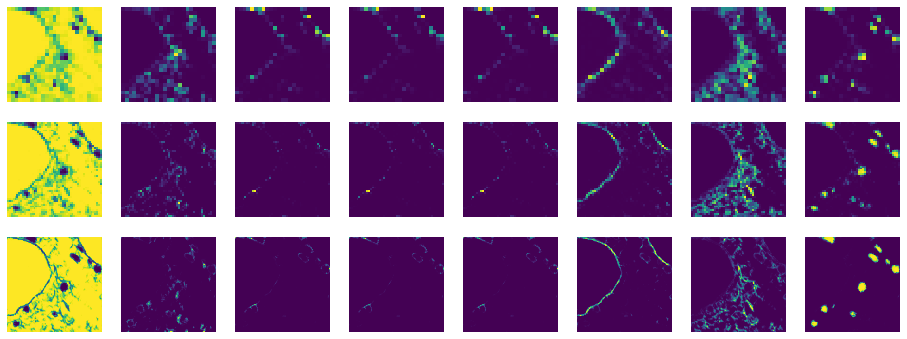

INFO [2019-11-04 21:40:45,049]: Epoch   2: loss= 0.648116


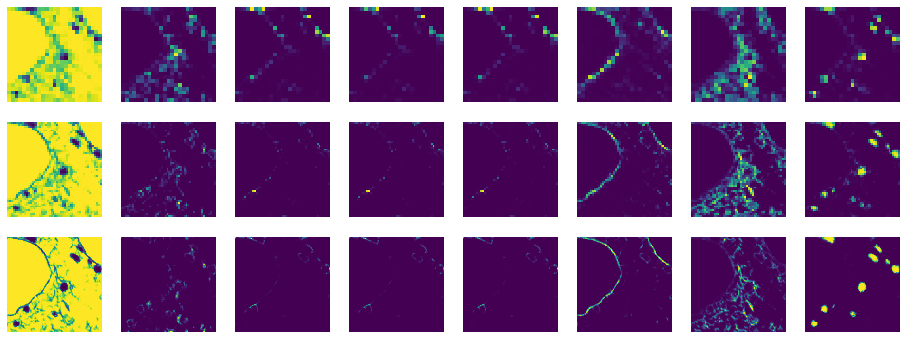

INFO [2019-11-04 21:40:49,488]: Epoch   3: loss= 0.648054


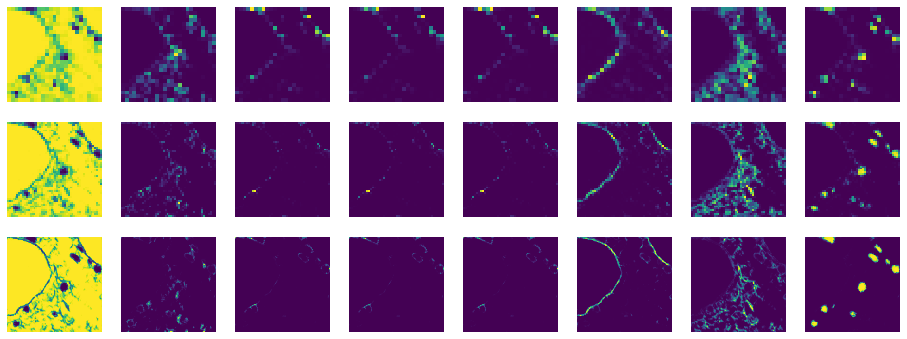

INFO [2019-11-04 21:40:53,226]: Epoch   4: loss= 0.647976


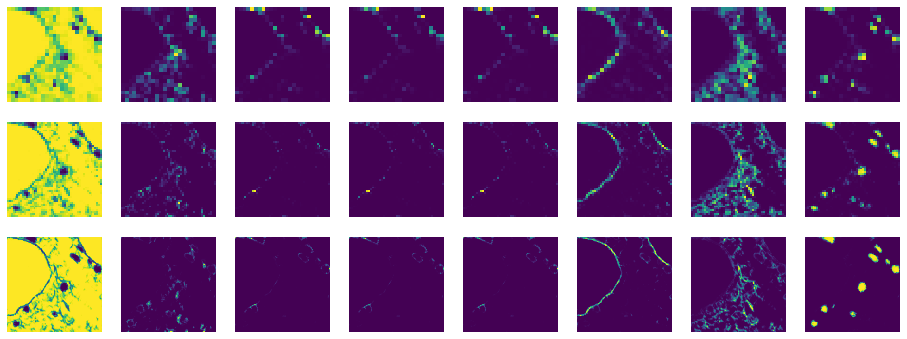

INFO [2019-11-04 21:40:56,912]: Epoch   5: loss= 0.647884
INFO [2019-11-04 21:40:59,902]: Epoch   6: loss= 0.647778
INFO [2019-11-04 21:41:02,992]: Epoch   7: loss= 0.647661
INFO [2019-11-04 21:41:06,072]: Epoch   8: loss= 0.647534
INFO [2019-11-04 21:41:09,337]: Epoch   9: loss= 0.647398
INFO [2019-11-04 21:41:14,004]: Epoch  10: loss= 0.647253


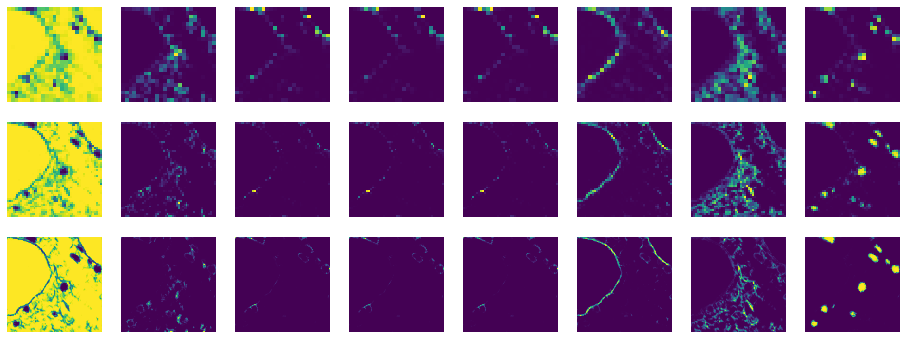

INFO [2019-11-04 21:41:21,359]: Epoch  11: loss= 0.647102
INFO [2019-11-04 21:41:25,300]: Epoch  12: loss= 0.646943
INFO [2019-11-04 21:41:30,305]: Epoch  13: loss= 0.646780
INFO [2019-11-04 21:41:33,835]: Epoch  14: loss= 0.646611
INFO [2019-11-04 21:41:37,494]: Epoch  15: loss= 0.646437
INFO [2019-11-04 21:41:40,836]: Epoch  16: loss= 0.646259
INFO [2019-11-04 21:41:44,564]: Epoch  17: loss= 0.646078
INFO [2019-11-04 21:41:48,597]: Epoch  18: loss= 0.645893
INFO [2019-11-04 21:41:52,827]: Epoch  19: loss= 0.645705
INFO [2019-11-04 21:41:56,260]: Epoch  20: loss= 0.645514


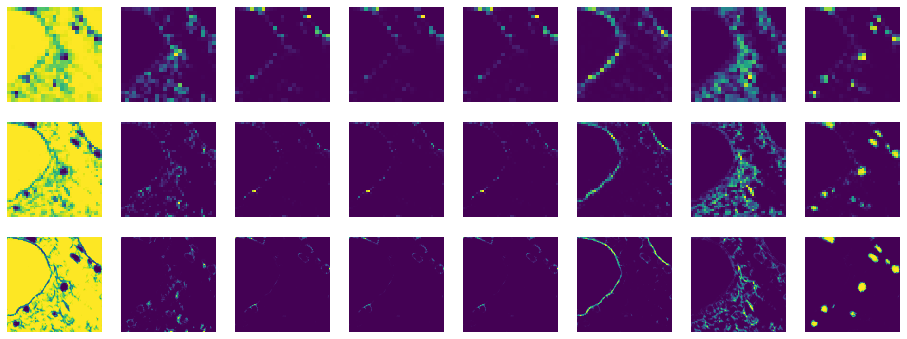

INFO [2019-11-04 21:42:00,930]: Epoch  21: loss= 0.645321
INFO [2019-11-04 21:42:04,113]: Epoch  22: loss= 0.645126
INFO [2019-11-04 21:42:07,095]: Epoch  23: loss= 0.644929
INFO [2019-11-04 21:42:10,562]: Epoch  24: loss= 0.644731
INFO [2019-11-04 21:42:13,938]: Epoch  25: loss= 0.644532
INFO [2019-11-04 21:42:17,597]: Epoch  26: loss= 0.644331
INFO [2019-11-04 21:42:21,798]: Epoch  27: loss= 0.644130
INFO [2019-11-04 21:42:26,512]: Epoch  28: loss= 0.643928
INFO [2019-11-04 21:42:30,354]: Epoch  29: loss= 0.643725
INFO [2019-11-04 21:42:34,253]: Epoch  30: loss= 0.643521


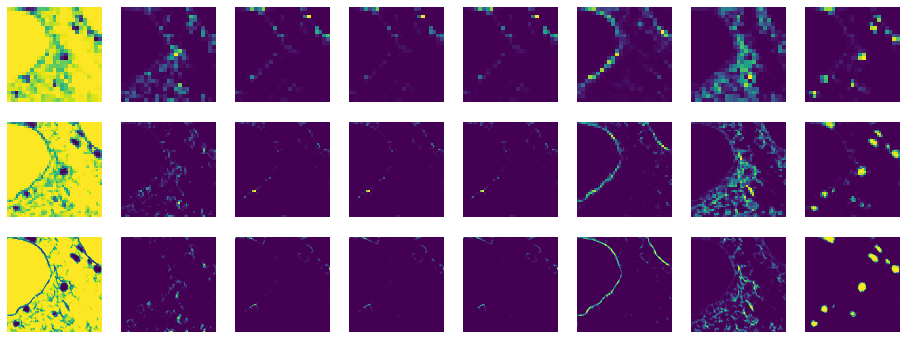

INFO [2019-11-04 21:42:39,153]: Epoch  31: loss= 0.643317
INFO [2019-11-04 21:42:43,761]: Epoch  32: loss= 0.643113
INFO [2019-11-04 21:42:47,879]: Epoch  33: loss= 0.642909
INFO [2019-11-04 21:42:51,012]: Epoch  34: loss= 0.642705
INFO [2019-11-04 21:42:54,357]: Epoch  35: loss= 0.642501
INFO [2019-11-04 21:42:57,879]: Epoch  36: loss= 0.642297
INFO [2019-11-04 21:43:03,188]: Epoch  37: loss= 0.642093
INFO [2019-11-04 21:43:09,304]: Epoch  38: loss= 0.641889
INFO [2019-11-04 21:43:14,326]: Epoch  39: loss= 0.641684
INFO [2019-11-04 21:43:18,112]: Epoch  40: loss= 0.641480


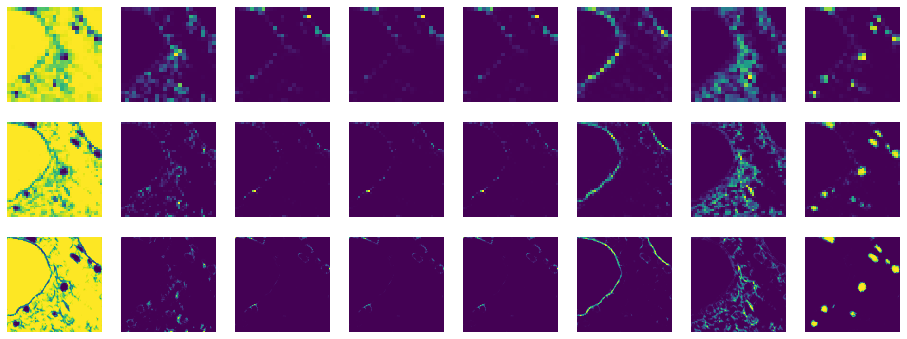

INFO [2019-11-04 21:43:22,358]: Epoch  41: loss= 0.641276
INFO [2019-11-04 21:43:28,146]: Epoch  42: loss= 0.641071
INFO [2019-11-04 21:43:31,656]: Epoch  43: loss= 0.640867
INFO [2019-11-04 21:43:34,979]: Epoch  44: loss= 0.640664
INFO [2019-11-04 21:43:37,992]: Epoch  45: loss= 0.640460
INFO [2019-11-04 21:43:41,116]: Epoch  46: loss= 0.640256
INFO [2019-11-04 21:43:44,156]: Epoch  47: loss= 0.640052
INFO [2019-11-04 21:43:47,348]: Epoch  48: loss= 0.639849
INFO [2019-11-04 21:43:50,439]: Epoch  49: loss= 0.639646
INFO [2019-11-04 21:43:53,446]: Epoch  50: loss= 0.639443


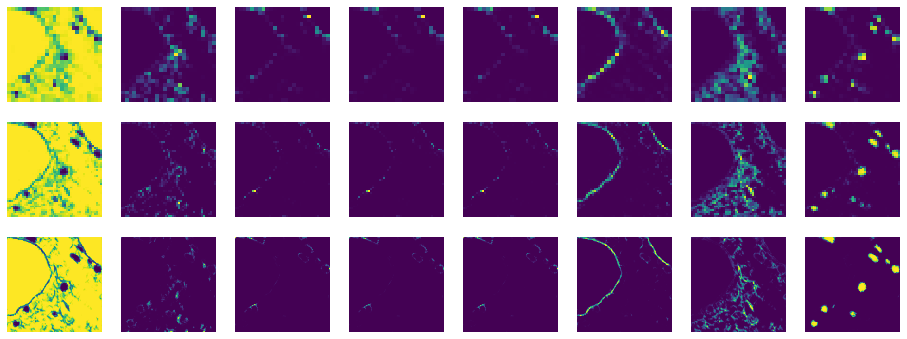

INFO [2019-11-04 21:43:57,138]: Epoch  51: loss= 0.639241
INFO [2019-11-04 21:44:00,277]: Epoch  52: loss= 0.639039
INFO [2019-11-04 21:44:03,340]: Epoch  53: loss= 0.638837
INFO [2019-11-04 21:44:08,705]: Epoch  54: loss= 0.638635
INFO [2019-11-04 21:44:13,352]: Epoch  55: loss= 0.638433
INFO [2019-11-04 21:44:17,984]: Epoch  56: loss= 0.638232
INFO [2019-11-04 21:44:22,219]: Epoch  57: loss= 0.638031
INFO [2019-11-04 21:44:26,478]: Epoch  58: loss= 0.637831
INFO [2019-11-04 21:44:30,725]: Epoch  59: loss= 0.637630
INFO [2019-11-04 21:44:34,989]: Epoch  60: loss= 0.637429


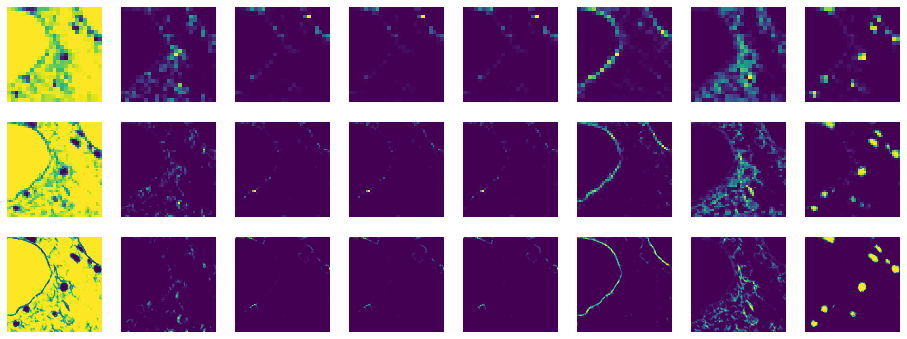

INFO [2019-11-04 21:44:40,083]: Epoch  61: loss= 0.637228
INFO [2019-11-04 21:44:45,165]: Epoch  62: loss= 0.637028
INFO [2019-11-04 21:44:49,442]: Epoch  63: loss= 0.636828
INFO [2019-11-04 21:44:53,612]: Epoch  64: loss= 0.636629
INFO [2019-11-04 21:44:57,792]: Epoch  65: loss= 0.636429
INFO [2019-11-04 21:45:03,022]: Epoch  66: loss= 0.636231
INFO [2019-11-04 21:45:08,062]: Epoch  67: loss= 0.636032
INFO [2019-11-04 21:45:13,456]: Epoch  68: loss= 0.635834
INFO [2019-11-04 21:45:18,972]: Epoch  69: loss= 0.635636
INFO [2019-11-04 21:45:23,268]: Epoch  70: loss= 0.635438


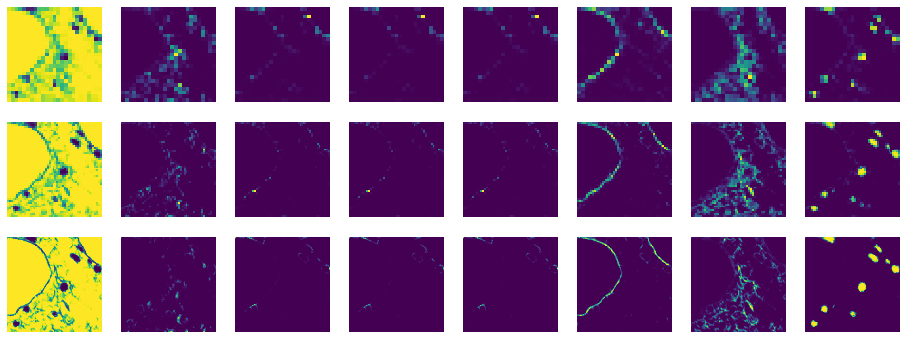

INFO [2019-11-04 21:45:29,134]: Epoch  71: loss= 0.635241
INFO [2019-11-04 21:45:32,959]: Epoch  72: loss= 0.635043
INFO [2019-11-04 21:45:36,585]: Epoch  73: loss= 0.634846
INFO [2019-11-04 21:45:40,787]: Epoch  74: loss= 0.634649
INFO [2019-11-04 21:45:44,855]: Epoch  75: loss= 0.634453
INFO [2019-11-04 21:45:49,452]: Epoch  76: loss= 0.634257
INFO [2019-11-04 21:45:54,278]: Epoch  77: loss= 0.634061
INFO [2019-11-04 21:45:57,427]: Epoch  78: loss= 0.633866
INFO [2019-11-04 21:46:00,428]: Epoch  79: loss= 0.633671
INFO [2019-11-04 21:46:03,433]: Epoch  80: loss= 0.633477


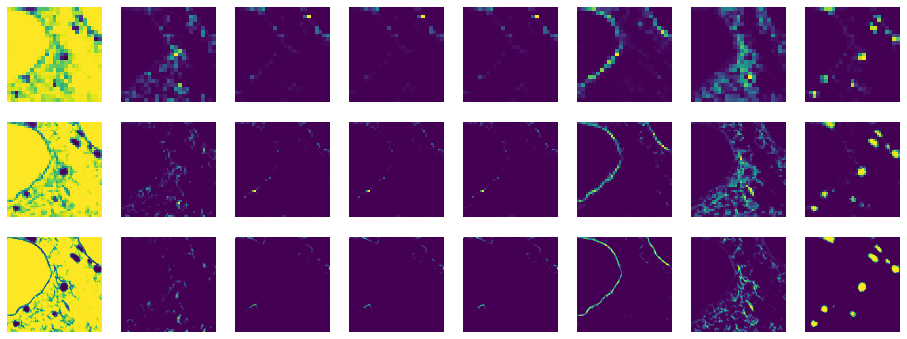

INFO [2019-11-04 21:46:07,023]: Epoch  81: loss= 0.633283
INFO [2019-11-04 21:46:10,193]: Epoch  82: loss= 0.633089
INFO [2019-11-04 21:46:13,150]: Epoch  83: loss= 0.632896
INFO [2019-11-04 21:46:16,135]: Epoch  84: loss= 0.632704
INFO [2019-11-04 21:46:19,328]: Epoch  85: loss= 0.632512
INFO [2019-11-04 21:46:24,002]: Epoch  86: loss= 0.632321
INFO [2019-11-04 21:46:29,002]: Epoch  87: loss= 0.632130
INFO [2019-11-04 21:46:32,362]: Epoch  88: loss= 0.631939
INFO [2019-11-04 21:46:36,018]: Epoch  89: loss= 0.631749
INFO [2019-11-04 21:46:40,616]: Epoch  90: loss= 0.631559


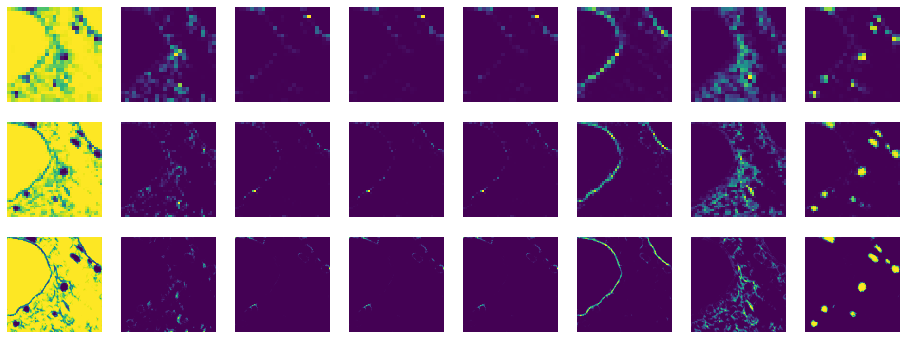

INFO [2019-11-04 21:46:45,280]: Epoch  91: loss= 0.631370
INFO [2019-11-04 21:46:49,529]: Epoch  92: loss= 0.631181
INFO [2019-11-04 21:46:53,254]: Epoch  93: loss= 0.630992
INFO [2019-11-04 21:46:57,145]: Epoch  94: loss= 0.630804
INFO [2019-11-04 21:47:00,147]: Epoch  95: loss= 0.630617
INFO [2019-11-04 21:47:03,602]: Epoch  96: loss= 0.630429
INFO [2019-11-04 21:47:07,006]: Epoch  97: loss= 0.630242
INFO [2019-11-04 21:47:10,011]: Epoch  98: loss= 0.630054
INFO [2019-11-04 21:47:14,753]: Epoch  99: loss= 0.629868
INFO [2019-11-04 21:47:19,016]: Epoch 100: loss= 0.629681


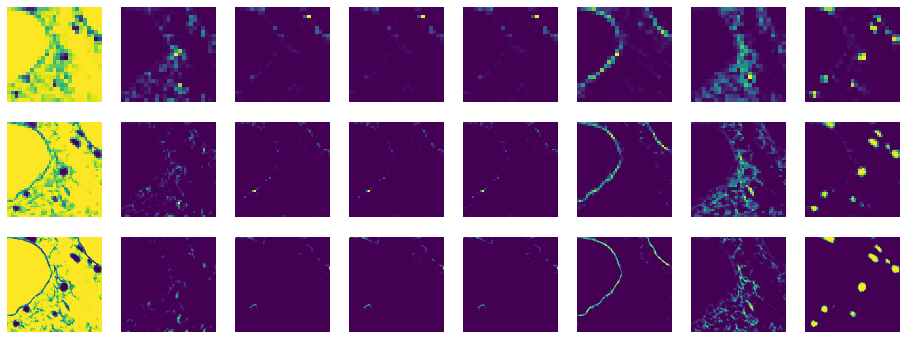

INFO [2019-11-04 21:47:24,771]: Epoch 101: loss= 0.629494
INFO [2019-11-04 21:47:28,842]: Epoch 102: loss= 0.629308
INFO [2019-11-04 21:47:32,467]: Epoch 103: loss= 0.629122
INFO [2019-11-04 21:47:35,585]: Epoch 104: loss= 0.628936
INFO [2019-11-04 21:47:39,021]: Epoch 105: loss= 0.628750
INFO [2019-11-04 21:47:43,101]: Epoch 106: loss= 0.628564
INFO [2019-11-04 21:47:46,436]: Epoch 107: loss= 0.628378
INFO [2019-11-04 21:47:50,190]: Epoch 108: loss= 0.628193
INFO [2019-11-04 21:47:53,811]: Epoch 109: loss= 0.628007
INFO [2019-11-04 21:47:56,849]: Epoch 110: loss= 0.627822


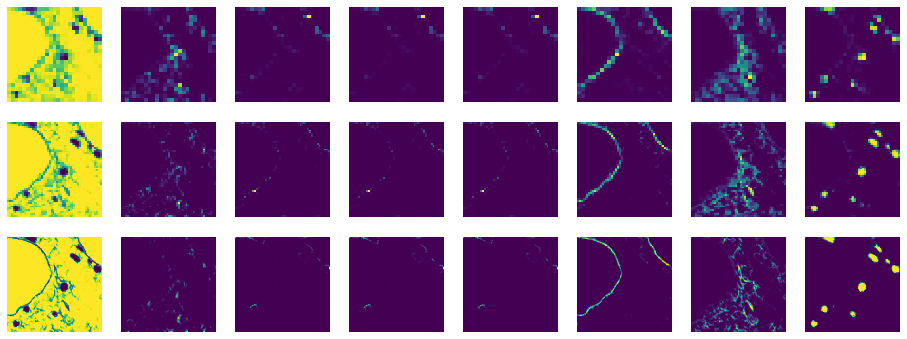

INFO [2019-11-04 21:48:00,730]: Epoch 111: loss= 0.627638
INFO [2019-11-04 21:48:04,004]: Epoch 112: loss= 0.627454
INFO [2019-11-04 21:48:07,116]: Epoch 113: loss= 0.627269
INFO [2019-11-04 21:48:10,992]: Epoch 114: loss= 0.627086
INFO [2019-11-04 21:48:15,306]: Epoch 115: loss= 0.626903
INFO [2019-11-04 21:48:19,229]: Epoch 116: loss= 0.626719
INFO [2019-11-04 21:48:22,846]: Epoch 117: loss= 0.626537
INFO [2019-11-04 21:48:26,449]: Epoch 118: loss= 0.626354
INFO [2019-11-04 21:48:30,017]: Epoch 119: loss= 0.626172
INFO [2019-11-04 21:48:33,485]: Epoch 120: loss= 0.625990


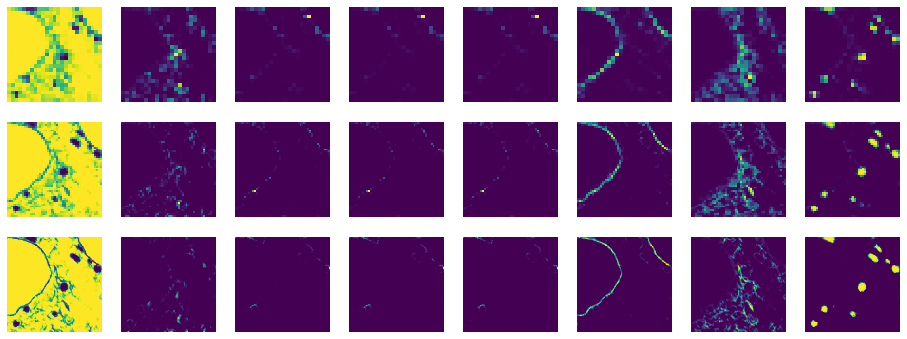

INFO [2019-11-04 21:48:38,397]: Epoch 121: loss= 0.625808
INFO [2019-11-04 21:48:42,871]: Epoch 122: loss= 0.625626
INFO [2019-11-04 21:48:47,006]: Epoch 123: loss= 0.625445
INFO [2019-11-04 21:48:51,182]: Epoch 124: loss= 0.625264
INFO [2019-11-04 21:48:55,285]: Epoch 125: loss= 0.625082
INFO [2019-11-04 21:48:59,205]: Epoch 126: loss= 0.624901
INFO [2019-11-04 21:49:04,042]: Epoch 127: loss= 0.624720
INFO [2019-11-04 21:49:09,995]: Epoch 128: loss= 0.624539
INFO [2019-11-04 21:49:14,466]: Epoch 129: loss= 0.624358
INFO [2019-11-04 21:49:19,372]: Epoch 130: loss= 0.624177


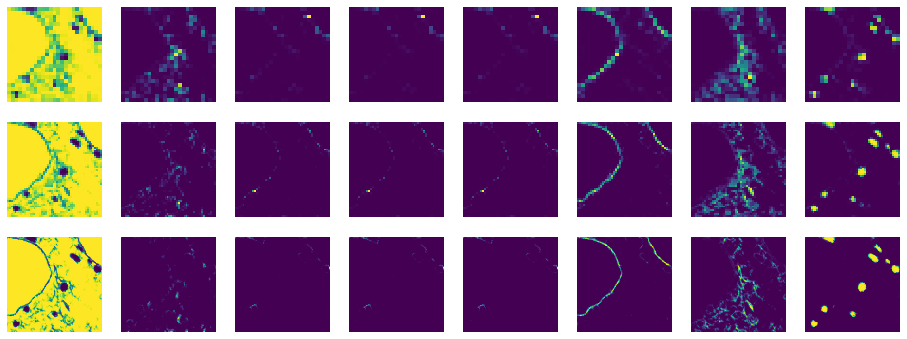

INFO [2019-11-04 21:49:24,747]: Epoch 131: loss= 0.623997
INFO [2019-11-04 21:49:28,992]: Epoch 132: loss= 0.623817
INFO [2019-11-04 21:49:32,956]: Epoch 133: loss= 0.623637
INFO [2019-11-04 21:49:36,881]: Epoch 134: loss= 0.623457
INFO [2019-11-04 21:49:40,259]: Epoch 135: loss= 0.623277
INFO [2019-11-04 21:49:43,385]: Epoch 136: loss= 0.623097
INFO [2019-11-04 21:49:46,444]: Epoch 137: loss= 0.622916
INFO [2019-11-04 21:49:49,447]: Epoch 138: loss= 0.622736
INFO [2019-11-04 21:49:52,440]: Epoch 139: loss= 0.622558
INFO [2019-11-04 21:49:55,482]: Epoch 140: loss= 0.622380


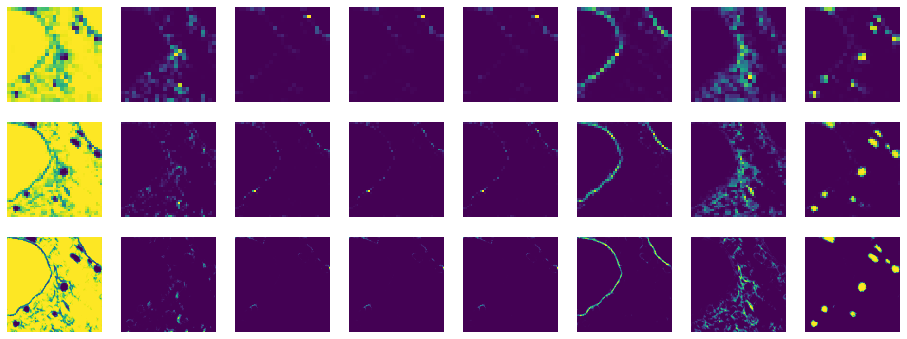

INFO [2019-11-04 21:49:59,146]: Epoch 141: loss= 0.622211
INFO [2019-11-04 21:50:02,301]: Epoch 142: loss= 0.622049
INFO [2019-11-04 21:50:05,330]: Epoch 143: loss= 0.621910
INFO [2019-11-04 21:50:08,578]: Epoch 144: loss= 0.621821
INFO [2019-11-04 21:50:11,836]: Epoch 145: loss= 0.621757
INFO [2019-11-04 21:50:15,176]: Epoch 146: loss= 0.621852
INFO [2019-11-04 21:50:18,289]: Epoch 147: loss= 0.621973
INFO [2019-11-04 21:50:21,985]: Epoch 148: loss= 0.622661
INFO [2019-11-04 21:50:25,465]: Epoch 149: loss= 0.622883
INFO [2019-11-04 21:50:28,977]: Epoch 150: loss= 0.624540


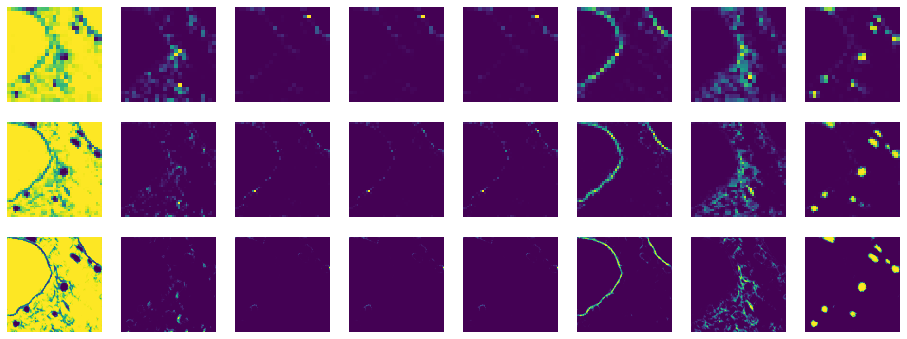

INFO [2019-11-04 21:50:33,689]: Epoch 151: loss= 0.623442
INFO [2019-11-04 21:50:36,810]: Epoch 152: loss= 0.623358
INFO [2019-11-04 21:50:39,816]: Epoch 153: loss= 0.620847
INFO [2019-11-04 21:50:43,276]: Epoch 154: loss= 0.620050
INFO [2019-11-04 21:50:46,491]: Epoch 155: loss= 0.620800
INFO [2019-11-04 21:50:49,801]: Epoch 156: loss= 0.620637
INFO [2019-11-04 21:50:52,862]: Epoch 157: loss= 0.619803
INFO [2019-11-04 21:50:55,869]: Epoch 158: loss= 0.619402
INFO [2019-11-04 21:50:59,789]: Epoch 159: loss= 0.619761
INFO [2019-11-04 21:51:04,153]: Epoch 160: loss= 0.619731


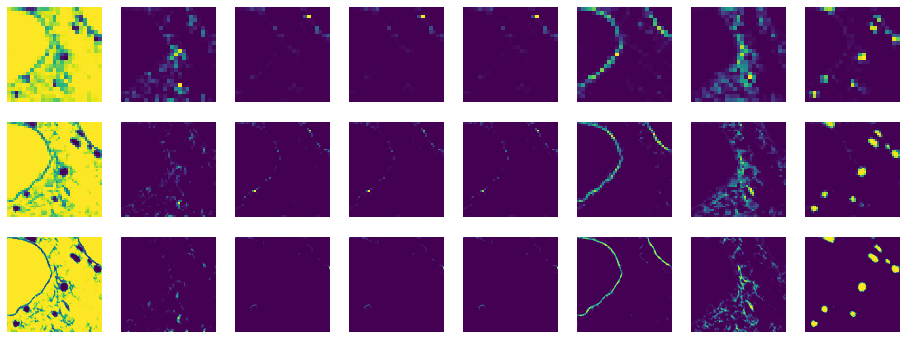

INFO [2019-11-04 21:51:09,009]: Epoch 161: loss= 0.618878
INFO [2019-11-04 21:51:12,434]: Epoch 162: loss= 0.618850
INFO [2019-11-04 21:51:15,838]: Epoch 163: loss= 0.619197
INFO [2019-11-04 21:51:19,475]: Epoch 164: loss= 0.618593
INFO [2019-11-04 21:51:22,662]: Epoch 165: loss= 0.618065
INFO [2019-11-04 21:51:27,382]: Epoch 166: loss= 0.618120
INFO [2019-11-04 21:51:31,081]: Epoch 167: loss= 0.618135
INFO [2019-11-04 21:51:34,184]: Epoch 168: loss= 0.617823
INFO [2019-11-04 21:51:38,038]: Epoch 169: loss= 0.617338
INFO [2019-11-04 21:51:42,635]: Epoch 170: loss= 0.617167


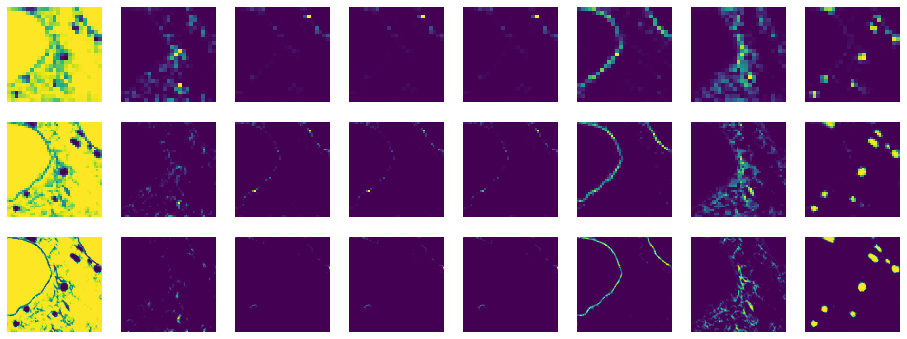

INFO [2019-11-04 21:51:48,883]: Epoch 171: loss= 0.617223
INFO [2019-11-04 21:51:52,588]: Epoch 172: loss= 0.617114
INFO [2019-11-04 21:51:55,621]: Epoch 173: loss= 0.616862
INFO [2019-11-04 21:51:58,921]: Epoch 174: loss= 0.616461
INFO [2019-11-04 21:52:02,033]: Epoch 175: loss= 0.616162
INFO [2019-11-04 21:52:05,293]: Epoch 176: loss= 0.615997
INFO [2019-11-04 21:52:08,289]: Epoch 177: loss= 0.615932
INFO [2019-11-04 21:52:11,330]: Epoch 178: loss= 0.615937
INFO [2019-11-04 21:52:15,409]: Epoch 179: loss= 0.615913
INFO [2019-11-04 21:52:19,285]: Epoch 180: loss= 0.616118


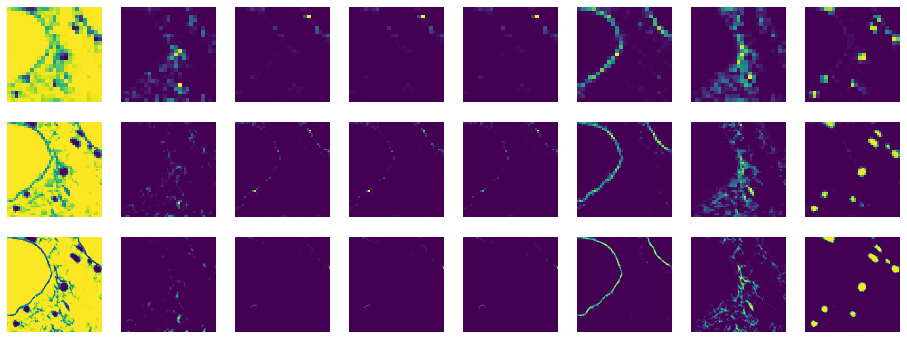

INFO [2019-11-04 21:52:24,525]: Epoch 181: loss= 0.616240
INFO [2019-11-04 21:52:27,562]: Epoch 182: loss= 0.617278
INFO [2019-11-04 21:52:30,617]: Epoch 183: loss= 0.617874
INFO [2019-11-04 21:52:33,621]: Epoch 184: loss= 0.621347
INFO [2019-11-04 21:52:36,618]: Epoch 185: loss= 0.621762
INFO [2019-11-04 21:52:39,837]: Epoch 186: loss= 0.626741
INFO [2019-11-04 21:52:43,249]: Epoch 187: loss= 0.619763
INFO [2019-11-04 21:52:46,492]: Epoch 188: loss= 0.614857
INFO [2019-11-04 21:52:50,141]: Epoch 189: loss= 0.615307
INFO [2019-11-04 21:52:53,493]: Epoch 190: loss= 0.616776


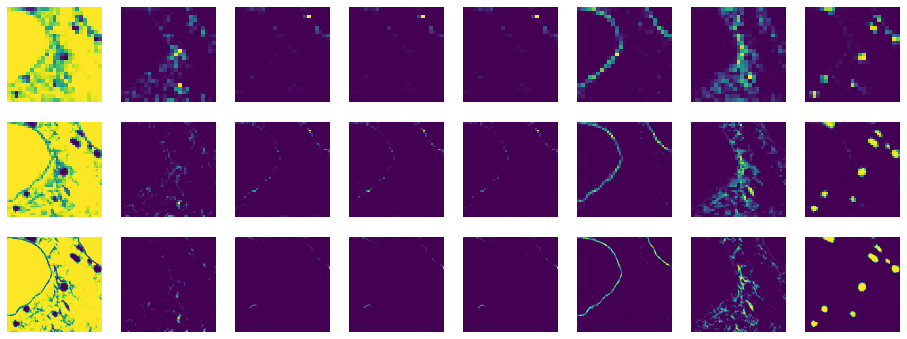

INFO [2019-11-04 21:52:57,495]: Epoch 191: loss= 0.614540
INFO [2019-11-04 21:53:00,882]: Epoch 192: loss= 0.614333
INFO [2019-11-04 21:53:04,011]: Epoch 193: loss= 0.615342
INFO [2019-11-04 21:53:07,551]: Epoch 194: loss= 0.613579
INFO [2019-11-04 21:53:10,890]: Epoch 195: loss= 0.613904
INFO [2019-11-04 21:53:14,657]: Epoch 196: loss= 0.614012
INFO [2019-11-04 21:53:17,599]: Epoch 197: loss= 0.612772
INFO [2019-11-04 21:53:21,114]: Epoch 198: loss= 0.613291
INFO [2019-11-04 21:53:25,483]: Epoch 199: loss= 0.612736
INFO [2019-11-04 21:53:28,972]: Epoch 200: loss= 0.612182


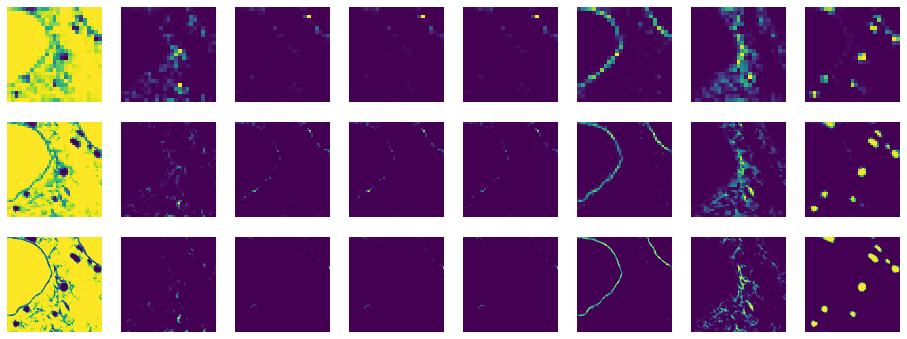

INFO [2019-11-04 21:53:33,539]: Epoch 201: loss= 0.612536
INFO [2019-11-04 21:53:37,274]: Epoch 202: loss= 0.611843
INFO [2019-11-04 21:53:40,501]: Epoch 203: loss= 0.611659
INFO [2019-11-04 21:53:43,963]: Epoch 204: loss= 0.611787
INFO [2019-11-04 21:53:47,165]: Epoch 205: loss= 0.611165
INFO [2019-11-04 21:53:50,282]: Epoch 206: loss= 0.610971
INFO [2019-11-04 21:53:53,410]: Epoch 207: loss= 0.611085
INFO [2019-11-04 21:53:57,202]: Epoch 208: loss= 0.610654
INFO [2019-11-04 21:54:00,373]: Epoch 209: loss= 0.610261
INFO [2019-11-04 21:54:03,532]: Epoch 210: loss= 0.610229


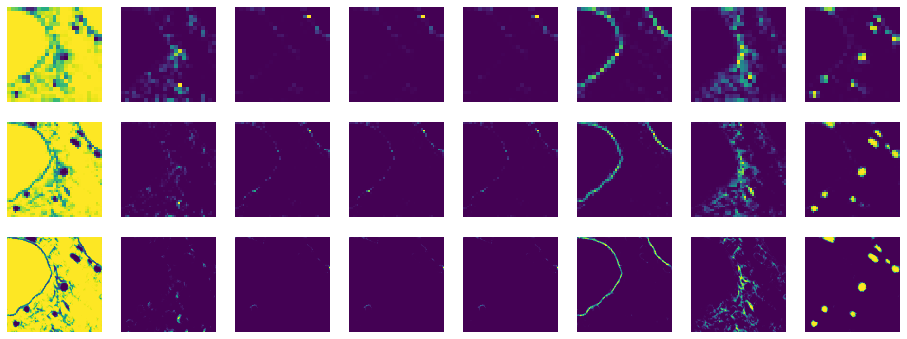

INFO [2019-11-04 21:54:07,520]: Epoch 211: loss= 0.610156
INFO [2019-11-04 21:54:10,800]: Epoch 212: loss= 0.609881
INFO [2019-11-04 21:54:14,410]: Epoch 213: loss= 0.609496
INFO [2019-11-04 21:54:17,643]: Epoch 214: loss= 0.609298
INFO [2019-11-04 21:54:20,915]: Epoch 215: loss= 0.609253
INFO [2019-11-04 21:54:24,563]: Epoch 216: loss= 0.609139
INFO [2019-11-04 21:54:28,080]: Epoch 217: loss= 0.608965
INFO [2019-11-04 21:54:31,421]: Epoch 218: loss= 0.608678
INFO [2019-11-04 21:54:34,794]: Epoch 219: loss= 0.608418
INFO [2019-11-04 21:54:38,015]: Epoch 220: loss= 0.608176


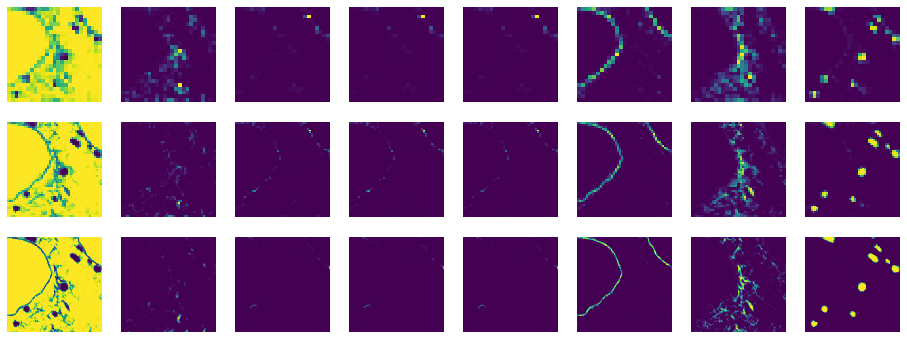

INFO [2019-11-04 21:54:41,802]: Epoch 221: loss= 0.607966
INFO [2019-11-04 21:54:45,591]: Epoch 222: loss= 0.607774
INFO [2019-11-04 21:54:49,176]: Epoch 223: loss= 0.607593
INFO [2019-11-04 21:54:52,476]: Epoch 224: loss= 0.607426
INFO [2019-11-04 21:54:55,580]: Epoch 225: loss= 0.607296
INFO [2019-11-04 21:54:59,275]: Epoch 226: loss= 0.607273
INFO [2019-11-04 21:55:02,562]: Epoch 227: loss= 0.607552
INFO [2019-11-04 21:55:05,568]: Epoch 228: loss= 0.609254
INFO [2019-11-04 21:55:08,571]: Epoch 229: loss= 0.614963
INFO [2019-11-04 21:55:11,567]: Epoch 230: loss= 0.646445


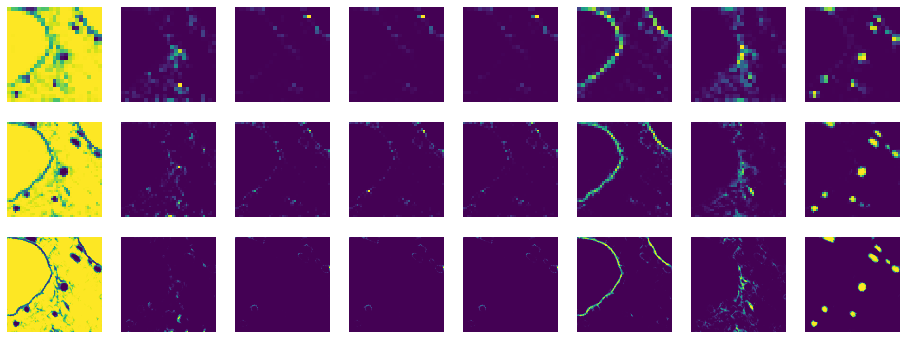

INFO [2019-11-04 21:55:15,299]: Epoch 231: loss= 0.700580
INFO [2019-11-04 21:55:18,421]: Epoch 232: loss= 0.816403
INFO [2019-11-04 21:55:21,940]: Epoch 233: loss= 0.693254
INFO [2019-11-04 21:55:25,920]: Epoch 234: loss= 0.678961
INFO [2019-11-04 21:55:29,760]: Epoch 235: loss= 0.702298
INFO [2019-11-04 21:55:33,373]: Epoch 236: loss= 0.639693
INFO [2019-11-04 21:55:36,899]: Epoch 237: loss= 0.661927
INFO [2019-11-04 21:55:40,637]: Epoch 238: loss= 0.676587
INFO [2019-11-04 21:55:44,521]: Epoch 239: loss= 0.664270
INFO [2019-11-04 21:55:48,323]: Epoch 240: loss= 0.645704


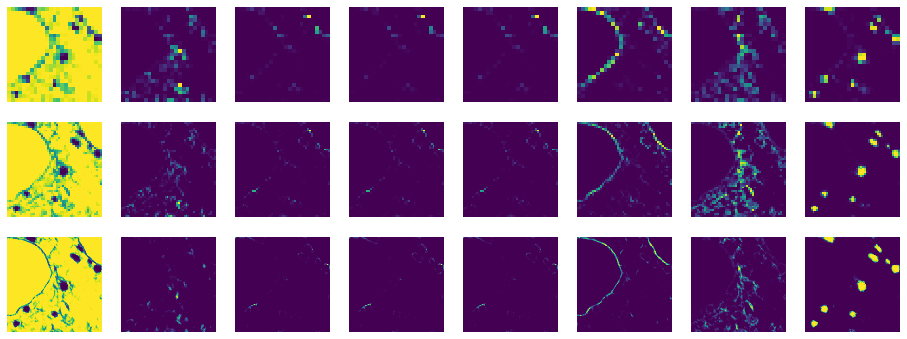

INFO [2019-11-04 21:55:52,646]: Epoch 241: loss= 0.647166
INFO [2019-11-04 21:55:56,578]: Epoch 242: loss= 0.657758
INFO [2019-11-04 21:55:59,844]: Epoch 243: loss= 0.651141
INFO [2019-11-04 21:56:03,703]: Epoch 244: loss= 0.640642
INFO [2019-11-04 21:56:06,968]: Epoch 245: loss= 0.638955
INFO [2019-11-04 21:56:10,062]: Epoch 246: loss= 0.641210
INFO [2019-11-04 21:56:13,140]: Epoch 247: loss= 0.641653
INFO [2019-11-04 21:56:16,155]: Epoch 248: loss= 0.638846
INFO [2019-11-04 21:56:19,180]: Epoch 249: loss= 0.634245
INFO [2019-11-04 21:56:22,522]: Epoch 250: loss= 0.629871


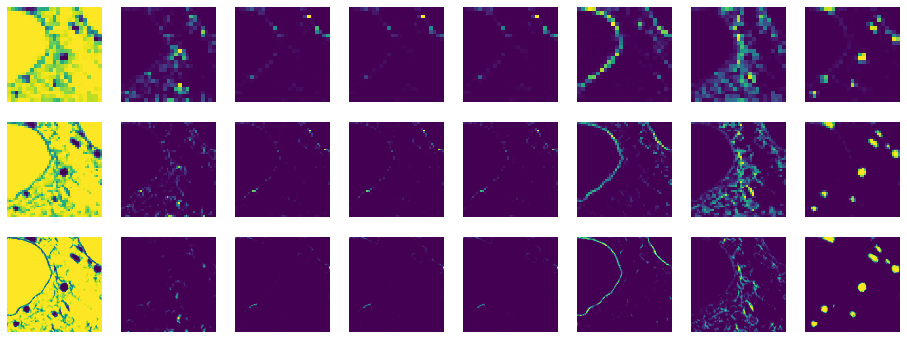

INFO [2019-11-04 21:56:26,800]: Epoch 251: loss= 0.629894
INFO [2019-11-04 21:56:30,276]: Epoch 252: loss= 0.632870
INFO [2019-11-04 21:56:33,721]: Epoch 253: loss= 0.633361
INFO [2019-11-04 21:56:37,286]: Epoch 254: loss= 0.629682
INFO [2019-11-04 21:56:40,519]: Epoch 255: loss= 0.625176
INFO [2019-11-04 21:56:44,365]: Epoch 256: loss= 0.624121
INFO [2019-11-04 21:56:47,899]: Epoch 257: loss= 0.626019
INFO [2019-11-04 21:56:51,188]: Epoch 258: loss= 0.626794
INFO [2019-11-04 21:56:55,405]: Epoch 259: loss= 0.625131
INFO [2019-11-04 21:56:58,829]: Epoch 260: loss= 0.623106


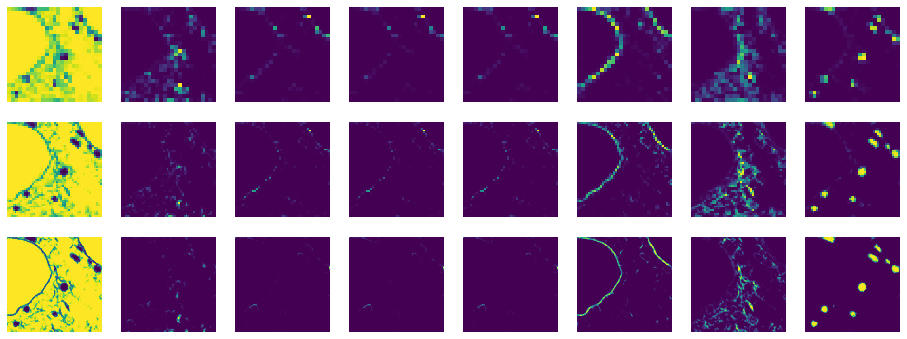

INFO [2019-11-04 21:57:03,272]: Epoch 261: loss= 0.622153
INFO [2019-11-04 21:57:06,700]: Epoch 262: loss= 0.621886
INFO [2019-11-04 21:57:10,213]: Epoch 263: loss= 0.621686
INFO [2019-11-04 21:57:13,881]: Epoch 264: loss= 0.621409
INFO [2019-11-04 21:57:17,313]: Epoch 265: loss= 0.620729
INFO [2019-11-04 21:57:20,612]: Epoch 266: loss= 0.619513
INFO [2019-11-04 21:57:23,702]: Epoch 267: loss= 0.618523
INFO [2019-11-04 21:57:26,785]: Epoch 268: loss= 0.618235
INFO [2019-11-04 21:57:30,000]: Epoch 269: loss= 0.618155
INFO [2019-11-04 21:57:33,286]: Epoch 270: loss= 0.617702


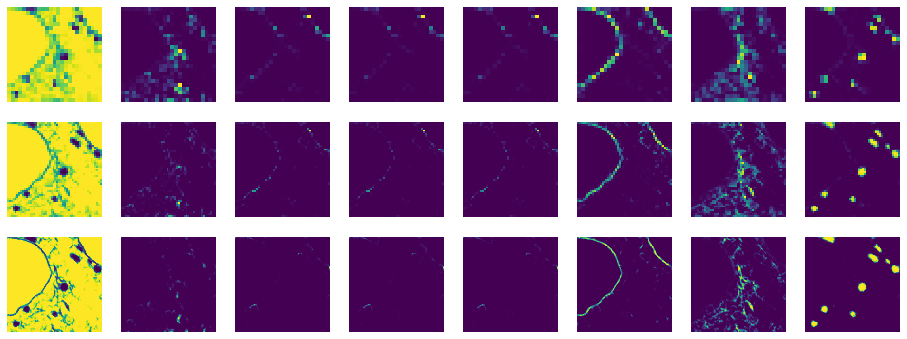

INFO [2019-11-04 21:57:37,288]: Epoch 271: loss= 0.616958
INFO [2019-11-04 21:57:40,673]: Epoch 272: loss= 0.616331
INFO [2019-11-04 21:57:43,900]: Epoch 273: loss= 0.615921
INFO [2019-11-04 21:57:47,174]: Epoch 274: loss= 0.615589
INFO [2019-11-04 21:57:50,534]: Epoch 275: loss= 0.615247
INFO [2019-11-04 21:57:54,229]: Epoch 276: loss= 0.614812
INFO [2019-11-04 21:57:57,436]: Epoch 277: loss= 0.614325
INFO [2019-11-04 21:58:00,786]: Epoch 278: loss= 0.613976
INFO [2019-11-04 21:58:04,174]: Epoch 279: loss= 0.613744
INFO [2019-11-04 21:58:08,050]: Epoch 280: loss= 0.613364


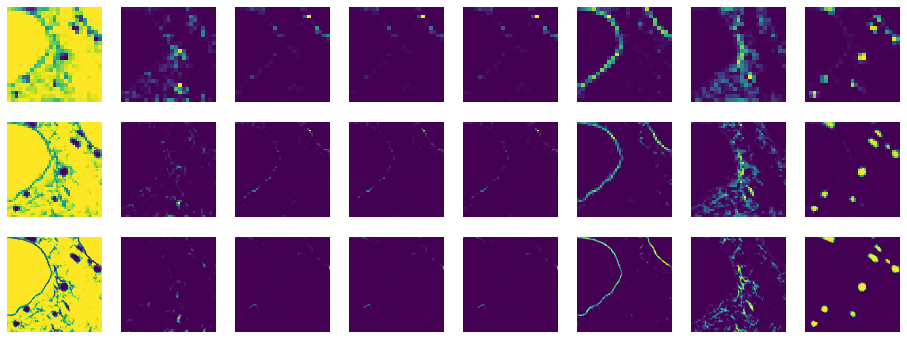

INFO [2019-11-04 21:58:11,952]: Epoch 281: loss= 0.612793
INFO [2019-11-04 21:58:15,397]: Epoch 282: loss= 0.612329
INFO [2019-11-04 21:58:18,907]: Epoch 283: loss= 0.612098
INFO [2019-11-04 21:58:22,435]: Epoch 284: loss= 0.611894
INFO [2019-11-04 21:58:25,978]: Epoch 285: loss= 0.611566
INFO [2019-11-04 21:58:29,471]: Epoch 286: loss= 0.611149
INFO [2019-11-04 21:58:32,629]: Epoch 287: loss= 0.610745
INFO [2019-11-04 21:58:35,789]: Epoch 288: loss= 0.610459
INFO [2019-11-04 21:58:39,001]: Epoch 289: loss= 0.610236
INFO [2019-11-04 21:58:42,083]: Epoch 290: loss= 0.609934


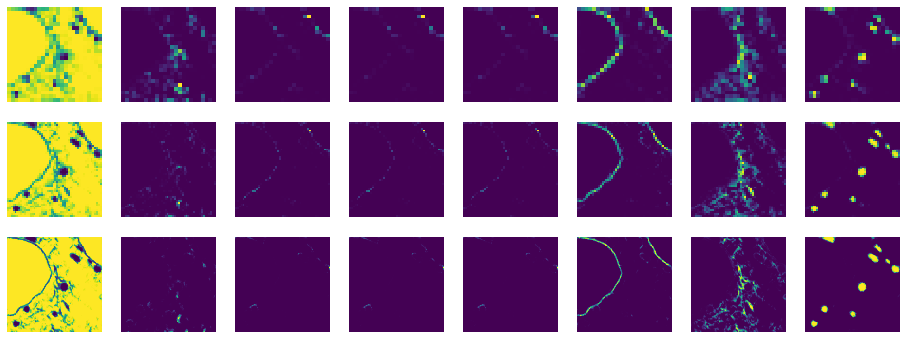

INFO [2019-11-04 21:58:46,230]: Epoch 291: loss= 0.609587
INFO [2019-11-04 21:58:49,326]: Epoch 292: loss= 0.609299
INFO [2019-11-04 21:58:52,857]: Epoch 293: loss= 0.609041
INFO [2019-11-04 21:58:56,151]: Epoch 294: loss= 0.608758
INFO [2019-11-04 21:58:59,440]: Epoch 295: loss= 0.608477
INFO [2019-11-04 21:59:02,472]: Epoch 296: loss= 0.608205
INFO [2019-11-04 21:59:05,521]: Epoch 297: loss= 0.607943
INFO [2019-11-04 21:59:08,643]: Epoch 298: loss= 0.607711
INFO [2019-11-04 21:59:11,897]: Epoch 299: loss= 0.607468
INFO [2019-11-04 21:59:14,954]: Epoch 300: loss= 0.607197


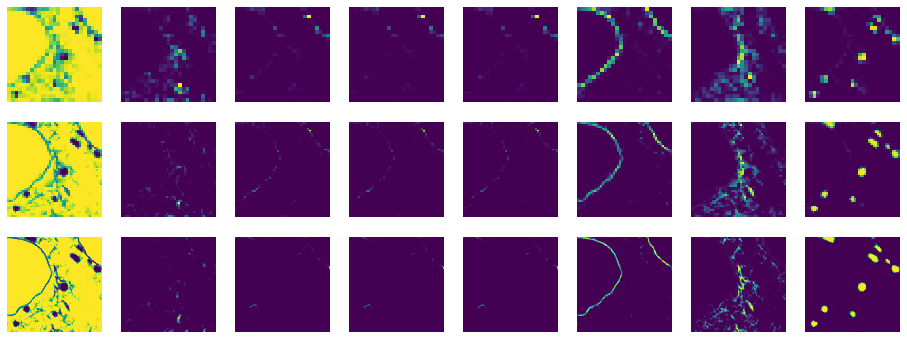

INFO [2019-11-04 21:59:18,802]: Epoch 301: loss= 0.606951
INFO [2019-11-04 21:59:22,010]: Epoch 302: loss= 0.606738
INFO [2019-11-04 21:59:25,258]: Epoch 303: loss= 0.606521
INFO [2019-11-04 21:59:28,926]: Epoch 304: loss= 0.606280
INFO [2019-11-04 21:59:32,258]: Epoch 305: loss= 0.606042
INFO [2019-11-04 21:59:35,367]: Epoch 306: loss= 0.605828
INFO [2019-11-04 21:59:38,399]: Epoch 307: loss= 0.605627
INFO [2019-11-04 21:59:41,407]: Epoch 308: loss= 0.605417
INFO [2019-11-04 21:59:44,497]: Epoch 309: loss= 0.605199
INFO [2019-11-04 21:59:47,506]: Epoch 310: loss= 0.605001


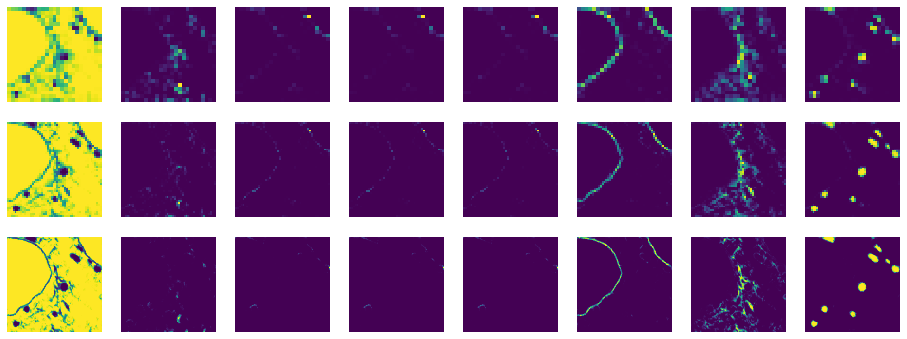

INFO [2019-11-04 21:59:51,125]: Epoch 311: loss= 0.604809
INFO [2019-11-04 21:59:54,185]: Epoch 312: loss= 0.604610
INFO [2019-11-04 21:59:57,199]: Epoch 313: loss= 0.604411
INFO [2019-11-04 22:00:00,237]: Epoch 314: loss= 0.604222
INFO [2019-11-04 22:00:03,312]: Epoch 315: loss= 0.604040
INFO [2019-11-04 22:00:06,318]: Epoch 316: loss= 0.603858
INFO [2019-11-04 22:00:09,321]: Epoch 317: loss= 0.603672
INFO [2019-11-04 22:00:12,362]: Epoch 318: loss= 0.603492
INFO [2019-11-04 22:00:15,476]: Epoch 319: loss= 0.603321
INFO [2019-11-04 22:00:18,481]: Epoch 320: loss= 0.603148


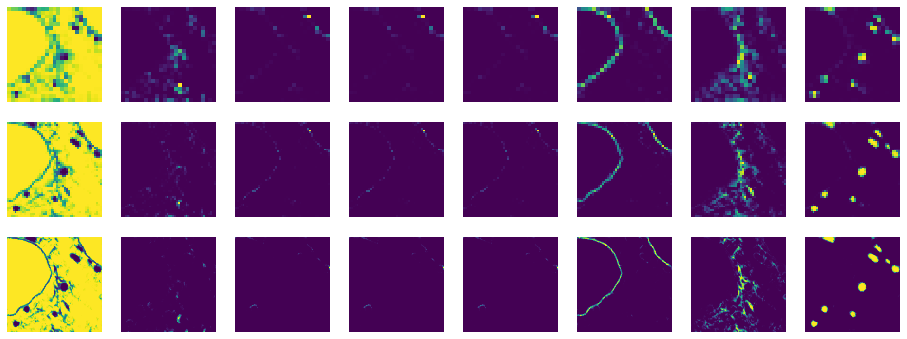

INFO [2019-11-04 22:00:22,175]: Epoch 321: loss= 0.602976
INFO [2019-11-04 22:00:25,214]: Epoch 322: loss= 0.602808
INFO [2019-11-04 22:00:28,246]: Epoch 323: loss= 0.602645
INFO [2019-11-04 22:00:31,262]: Epoch 324: loss= 0.602483
INFO [2019-11-04 22:00:34,302]: Epoch 325: loss= 0.602320
INFO [2019-11-04 22:00:37,322]: Epoch 326: loss= 0.602162
INFO [2019-11-04 22:00:40,342]: Epoch 327: loss= 0.602007
INFO [2019-11-04 22:00:43,509]: Epoch 328: loss= 0.601852
INFO [2019-11-04 22:00:46,925]: Epoch 329: loss= 0.601699
INFO [2019-11-04 22:00:50,096]: Epoch 330: loss= 0.601548


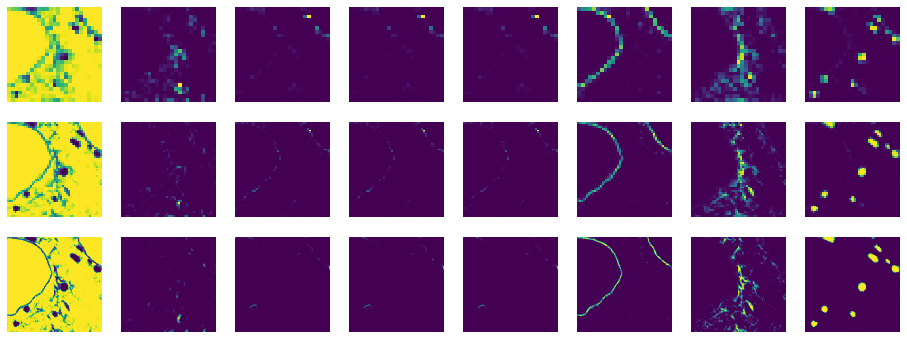

INFO [2019-11-04 22:00:53,694]: Epoch 331: loss= 0.601400
INFO [2019-11-04 22:00:56,724]: Epoch 332: loss= 0.601253
INFO [2019-11-04 22:00:59,771]: Epoch 333: loss= 0.601107
INFO [2019-11-04 22:01:02,801]: Epoch 334: loss= 0.600962
INFO [2019-11-04 22:01:05,867]: Epoch 335: loss= 0.600819
INFO [2019-11-04 22:01:08,984]: Epoch 336: loss= 0.600678
INFO [2019-11-04 22:01:12,014]: Epoch 337: loss= 0.600537
INFO [2019-11-04 22:01:15,079]: Epoch 338: loss= 0.600398
INFO [2019-11-04 22:01:18,128]: Epoch 339: loss= 0.600261
INFO [2019-11-04 22:01:21,176]: Epoch 340: loss= 0.600125


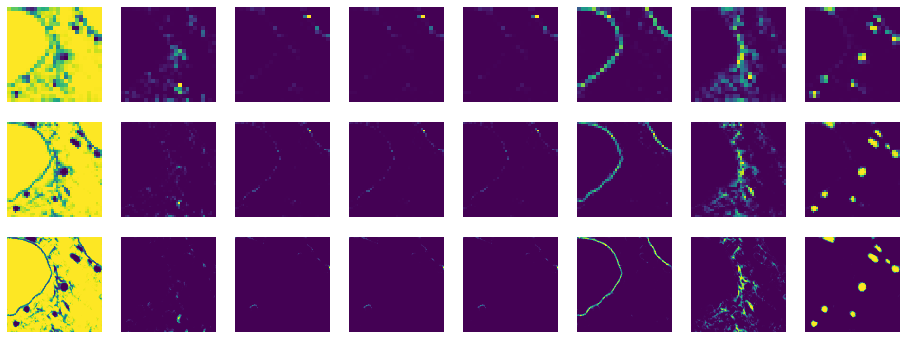

INFO [2019-11-04 22:01:24,836]: Epoch 341: loss= 0.599989
INFO [2019-11-04 22:01:27,861]: Epoch 342: loss= 0.599855
INFO [2019-11-04 22:01:30,914]: Epoch 343: loss= 0.599723
INFO [2019-11-04 22:01:34,128]: Epoch 344: loss= 0.599591
INFO [2019-11-04 22:01:37,267]: Epoch 345: loss= 0.599461
INFO [2019-11-04 22:01:40,252]: Epoch 346: loss= 0.599331
INFO [2019-11-04 22:01:43,322]: Epoch 347: loss= 0.599204
INFO [2019-11-04 22:01:46,362]: Epoch 348: loss= 0.599077
INFO [2019-11-04 22:01:49,370]: Epoch 349: loss= 0.598951
INFO [2019-11-04 22:01:52,397]: Epoch 350: loss= 0.598826


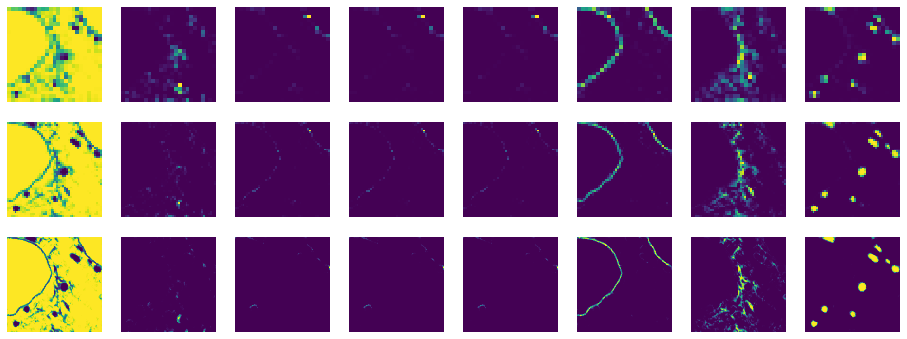

INFO [2019-11-04 22:01:56,054]: Epoch 351: loss= 0.598703
INFO [2019-11-04 22:01:59,060]: Epoch 352: loss= 0.598580
INFO [2019-11-04 22:02:02,111]: Epoch 353: loss= 0.598458
INFO [2019-11-04 22:02:05,233]: Epoch 354: loss= 0.598338
INFO [2019-11-04 22:02:08,246]: Epoch 355: loss= 0.598218
INFO [2019-11-04 22:02:11,276]: Epoch 356: loss= 0.598100
INFO [2019-11-04 22:02:14,401]: Epoch 357: loss= 0.597983
INFO [2019-11-04 22:02:17,392]: Epoch 358: loss= 0.597867
INFO [2019-11-04 22:02:20,416]: Epoch 359: loss= 0.597752
INFO [2019-11-04 22:02:23,402]: Epoch 360: loss= 0.597638


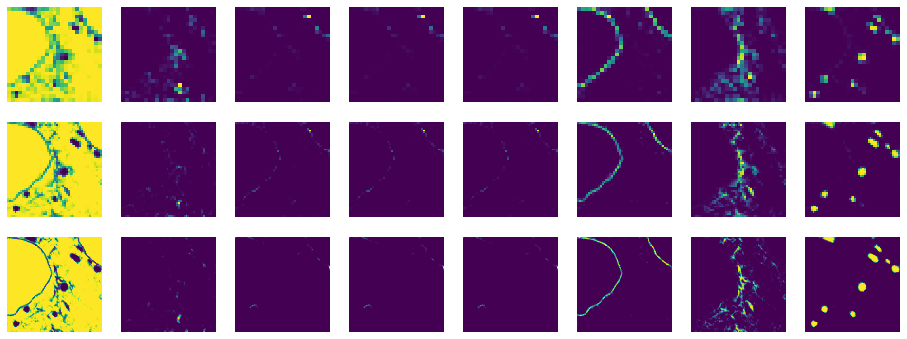

INFO [2019-11-04 22:02:27,028]: Epoch 361: loss= 0.597524
INFO [2019-11-04 22:02:30,022]: Epoch 362: loss= 0.597412
INFO [2019-11-04 22:02:33,262]: Epoch 363: loss= 0.597300
INFO [2019-11-04 22:02:36,323]: Epoch 364: loss= 0.597189
INFO [2019-11-04 22:02:39,441]: Epoch 365: loss= 0.597079
INFO [2019-11-04 22:02:42,443]: Epoch 366: loss= 0.596970
INFO [2019-11-04 22:02:46,183]: Epoch 367: loss= 0.596862
INFO [2019-11-04 22:02:49,227]: Epoch 368: loss= 0.596754
INFO [2019-11-04 22:02:52,301]: Epoch 369: loss= 0.596647
INFO [2019-11-04 22:02:55,273]: Epoch 370: loss= 0.596541


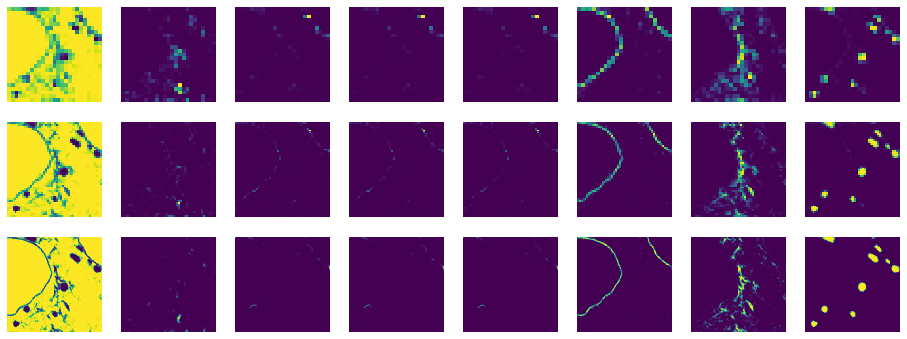

INFO [2019-11-04 22:02:58,965]: Epoch 371: loss= 0.596435
INFO [2019-11-04 22:03:02,030]: Epoch 372: loss= 0.596331
INFO [2019-11-04 22:03:05,091]: Epoch 373: loss= 0.596227
INFO [2019-11-04 22:03:08,107]: Epoch 374: loss= 0.596123
INFO [2019-11-04 22:03:11,128]: Epoch 375: loss= 0.596020
INFO [2019-11-04 22:03:14,155]: Epoch 376: loss= 0.595917
INFO [2019-11-04 22:03:17,143]: Epoch 377: loss= 0.595815
INFO [2019-11-04 22:03:20,136]: Epoch 378: loss= 0.595713
INFO [2019-11-04 22:03:23,134]: Epoch 379: loss= 0.595612
INFO [2019-11-04 22:03:26,128]: Epoch 380: loss= 0.595512


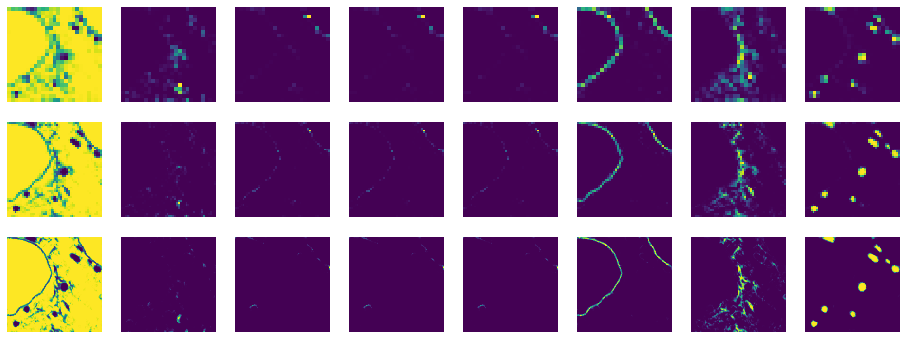

INFO [2019-11-04 22:03:29,886]: Epoch 381: loss= 0.595412
INFO [2019-11-04 22:03:32,938]: Epoch 382: loss= 0.595313
INFO [2019-11-04 22:03:35,959]: Epoch 383: loss= 0.595215
INFO [2019-11-04 22:03:38,953]: Epoch 384: loss= 0.595117
INFO [2019-11-04 22:03:41,969]: Epoch 385: loss= 0.595019
INFO [2019-11-04 22:03:45,016]: Epoch 386: loss= 0.594922
INFO [2019-11-04 22:03:48,048]: Epoch 387: loss= 0.594825
INFO [2019-11-04 22:03:51,029]: Epoch 388: loss= 0.594730
INFO [2019-11-04 22:03:54,044]: Epoch 389: loss= 0.594635
INFO [2019-11-04 22:03:57,096]: Epoch 390: loss= 0.594540


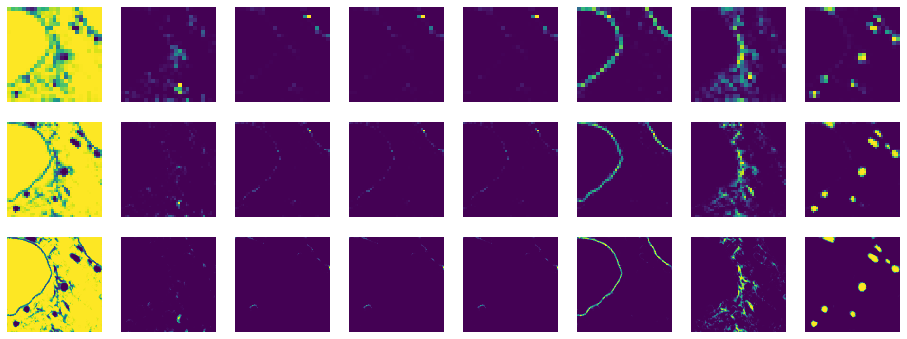

INFO [2019-11-04 22:04:00,752]: Epoch 391: loss= 0.594446
INFO [2019-11-04 22:04:03,777]: Epoch 392: loss= 0.594352
INFO [2019-11-04 22:04:06,805]: Epoch 393: loss= 0.594259
INFO [2019-11-04 22:04:09,840]: Epoch 394: loss= 0.594167
INFO [2019-11-04 22:04:12,949]: Epoch 395: loss= 0.594075
INFO [2019-11-04 22:04:16,000]: Epoch 396: loss= 0.593983
INFO [2019-11-04 22:04:19,022]: Epoch 397: loss= 0.593893
INFO [2019-11-04 22:04:22,051]: Epoch 398: loss= 0.593803
INFO [2019-11-04 22:04:25,050]: Epoch 399: loss= 0.593713
INFO [2019-11-04 22:04:28,173]: Epoch 400: loss= 0.593624


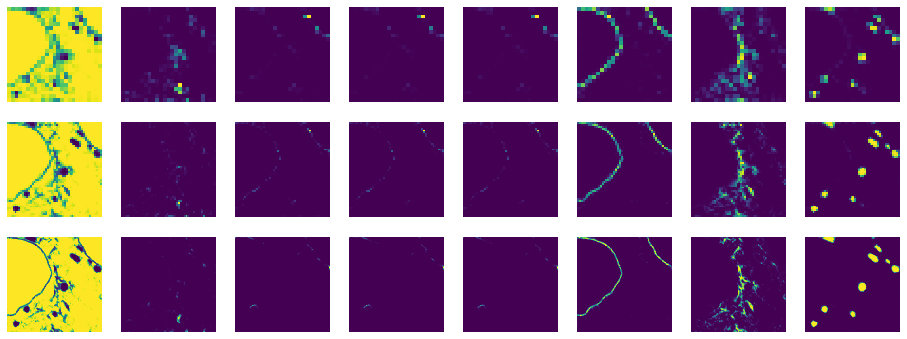

INFO [2019-11-04 22:04:31,877]: Epoch 401: loss= 0.593535
INFO [2019-11-04 22:04:34,918]: Epoch 402: loss= 0.593447
INFO [2019-11-04 22:04:37,985]: Epoch 403: loss= 0.593359
INFO [2019-11-04 22:04:40,981]: Epoch 404: loss= 0.593272
INFO [2019-11-04 22:04:44,236]: Epoch 405: loss= 0.593185
INFO [2019-11-04 22:04:47,549]: Epoch 406: loss= 0.593098
INFO [2019-11-04 22:04:50,642]: Epoch 407: loss= 0.593013
INFO [2019-11-04 22:04:53,717]: Epoch 408: loss= 0.592927
INFO [2019-11-04 22:04:56,701]: Epoch 409: loss= 0.592842
INFO [2019-11-04 22:04:59,735]: Epoch 410: loss= 0.592757


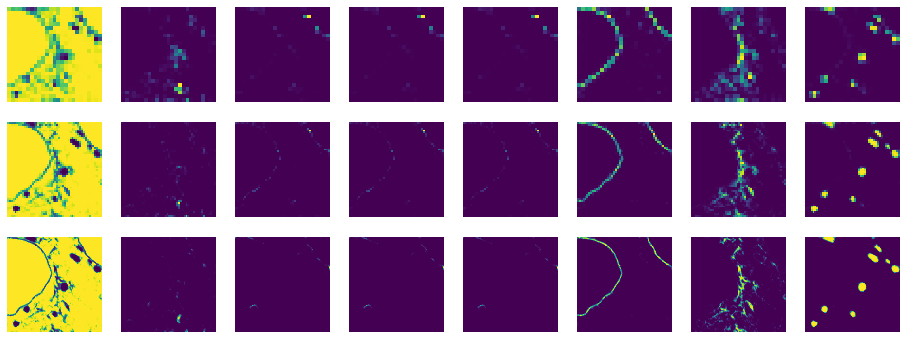

INFO [2019-11-04 22:05:03,383]: Epoch 411: loss= 0.592672
INFO [2019-11-04 22:05:06,541]: Epoch 412: loss= 0.592588
INFO [2019-11-04 22:05:09,595]: Epoch 413: loss= 0.592505
INFO [2019-11-04 22:05:12,700]: Epoch 414: loss= 0.592421
INFO [2019-11-04 22:05:15,734]: Epoch 415: loss= 0.592339
INFO [2019-11-04 22:05:18,823]: Epoch 416: loss= 0.592256
INFO [2019-11-04 22:05:21,887]: Epoch 417: loss= 0.592175
INFO [2019-11-04 22:05:24,893]: Epoch 418: loss= 0.592093
INFO [2019-11-04 22:05:27,932]: Epoch 419: loss= 0.592012
INFO [2019-11-04 22:05:30,950]: Epoch 420: loss= 0.591930


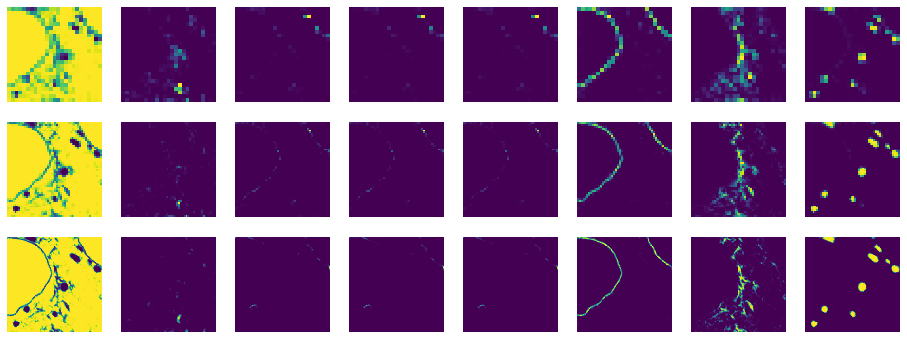

INFO [2019-11-04 22:05:34,609]: Epoch 421: loss= 0.591850
INFO [2019-11-04 22:05:37,621]: Epoch 422: loss= 0.591770
INFO [2019-11-04 22:05:40,664]: Epoch 423: loss= 0.591691
INFO [2019-11-04 22:05:43,683]: Epoch 424: loss= 0.591611
INFO [2019-11-04 22:05:46,736]: Epoch 425: loss= 0.591532
INFO [2019-11-04 22:05:49,861]: Epoch 426: loss= 0.591453
INFO [2019-11-04 22:05:52,933]: Epoch 427: loss= 0.591374
INFO [2019-11-04 22:05:55,973]: Epoch 428: loss= 0.591297
INFO [2019-11-04 22:05:58,972]: Epoch 429: loss= 0.591219
INFO [2019-11-04 22:06:02,033]: Epoch 430: loss= 0.591142


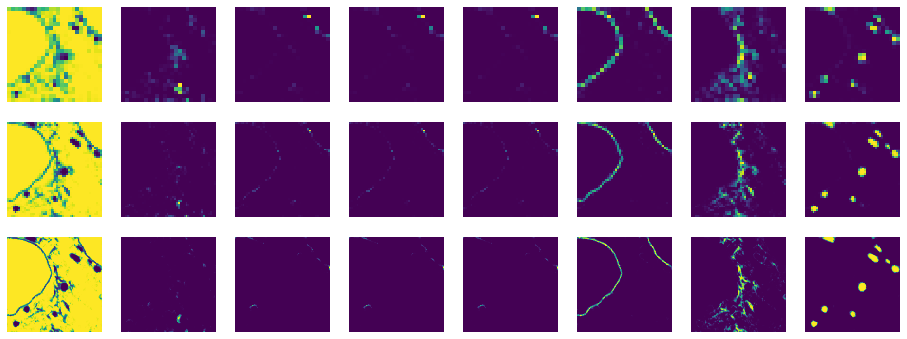

INFO [2019-11-04 22:06:05,751]: Epoch 431: loss= 0.591065
INFO [2019-11-04 22:06:08,778]: Epoch 432: loss= 0.590988
INFO [2019-11-04 22:06:11,789]: Epoch 433: loss= 0.590912
INFO [2019-11-04 22:06:14,832]: Epoch 434: loss= 0.590836
INFO [2019-11-04 22:06:17,893]: Epoch 435: loss= 0.590760
INFO [2019-11-04 22:06:20,916]: Epoch 436: loss= 0.590684
INFO [2019-11-04 22:06:23,966]: Epoch 437: loss= 0.590609
INFO [2019-11-04 22:06:26,987]: Epoch 438: loss= 0.590535
INFO [2019-11-04 22:06:30,063]: Epoch 439: loss= 0.590460
INFO [2019-11-04 22:06:33,121]: Epoch 440: loss= 0.590386


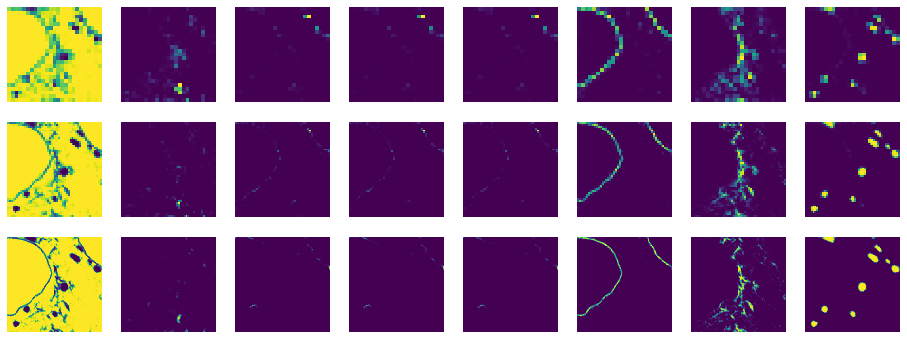

INFO [2019-11-04 22:06:36,772]: Epoch 441: loss= 0.590312
INFO [2019-11-04 22:06:39,810]: Epoch 442: loss= 0.590239
INFO [2019-11-04 22:06:42,881]: Epoch 443: loss= 0.590166
INFO [2019-11-04 22:06:46,804]: Epoch 444: loss= 0.590093
INFO [2019-11-04 22:06:49,938]: Epoch 445: loss= 0.590022
INFO [2019-11-04 22:06:53,124]: Epoch 446: loss= 0.589951
INFO [2019-11-04 22:06:56,149]: Epoch 447: loss= 0.589881
INFO [2019-11-04 22:06:59,169]: Epoch 448: loss= 0.589811
INFO [2019-11-04 22:07:02,223]: Epoch 449: loss= 0.589741
INFO [2019-11-04 22:07:05,244]: Epoch 450: loss= 0.589670


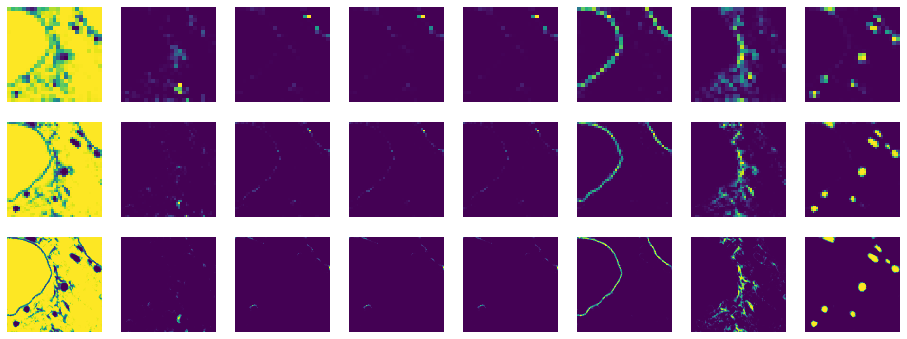

INFO [2019-11-04 22:07:08,941]: Epoch 451: loss= 0.589600
INFO [2019-11-04 22:07:11,961]: Epoch 452: loss= 0.589528
INFO [2019-11-04 22:07:14,968]: Epoch 453: loss= 0.589457
INFO [2019-11-04 22:07:17,984]: Epoch 454: loss= 0.589386
INFO [2019-11-04 22:07:21,013]: Epoch 455: loss= 0.589316
INFO [2019-11-04 22:07:24,050]: Epoch 456: loss= 0.589248
INFO [2019-11-04 22:07:27,055]: Epoch 457: loss= 0.589181
INFO [2019-11-04 22:07:30,078]: Epoch 458: loss= 0.589116
INFO [2019-11-04 22:07:33,153]: Epoch 459: loss= 0.589053
INFO [2019-11-04 22:07:36,225]: Epoch 460: loss= 0.588992


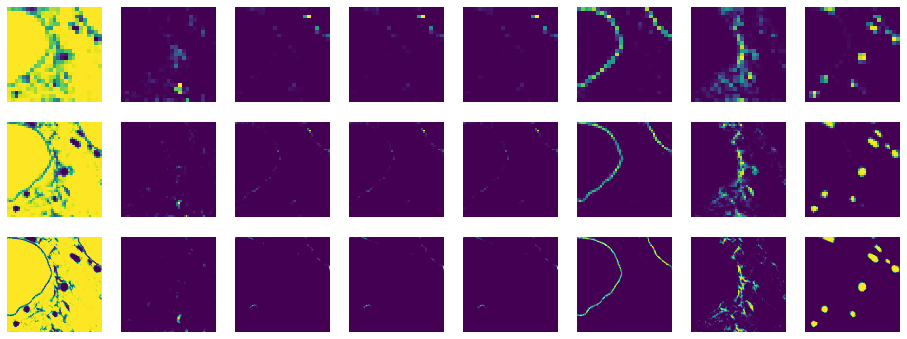

INFO [2019-11-04 22:07:39,929]: Epoch 461: loss= 0.588935
INFO [2019-11-04 22:07:42,939]: Epoch 462: loss= 0.588885
INFO [2019-11-04 22:07:45,974]: Epoch 463: loss= 0.588845
INFO [2019-11-04 22:07:49,011]: Epoch 464: loss= 0.588811
INFO [2019-11-04 22:07:52,012]: Epoch 465: loss= 0.588791
INFO [2019-11-04 22:07:55,066]: Epoch 466: loss= 0.588776
INFO [2019-11-04 22:07:58,063]: Epoch 467: loss= 0.588783
INFO [2019-11-04 22:08:01,109]: Epoch 468: loss= 0.588790
INFO [2019-11-04 22:08:04,179]: Epoch 469: loss= 0.588827
INFO [2019-11-04 22:08:07,288]: Epoch 470: loss= 0.588854


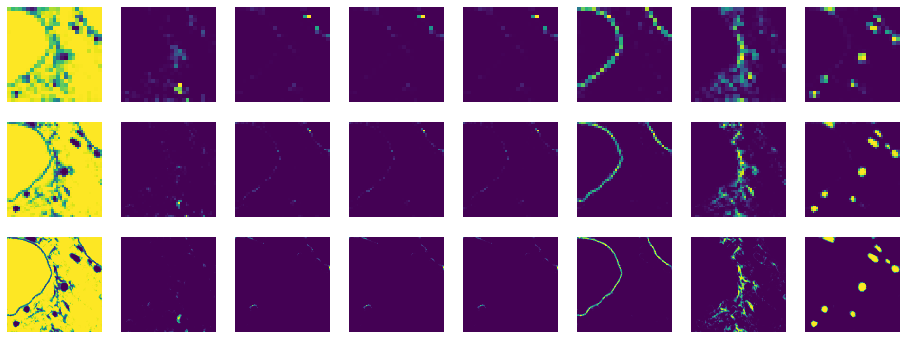

INFO [2019-11-04 22:08:10,879]: Epoch 471: loss= 0.588916
INFO [2019-11-04 22:08:13,899]: Epoch 472: loss= 0.588955
INFO [2019-11-04 22:08:16,917]: Epoch 473: loss= 0.589054
INFO [2019-11-04 22:08:19,943]: Epoch 474: loss= 0.589089
INFO [2019-11-04 22:08:22,960]: Epoch 475: loss= 0.589185
INFO [2019-11-04 22:08:25,965]: Epoch 476: loss= 0.589153
INFO [2019-11-04 22:08:28,939]: Epoch 477: loss= 0.589166
INFO [2019-11-04 22:08:31,956]: Epoch 478: loss= 0.588997
INFO [2019-11-04 22:08:34,962]: Epoch 479: loss= 0.588842
INFO [2019-11-04 22:08:37,984]: Epoch 480: loss= 0.588542


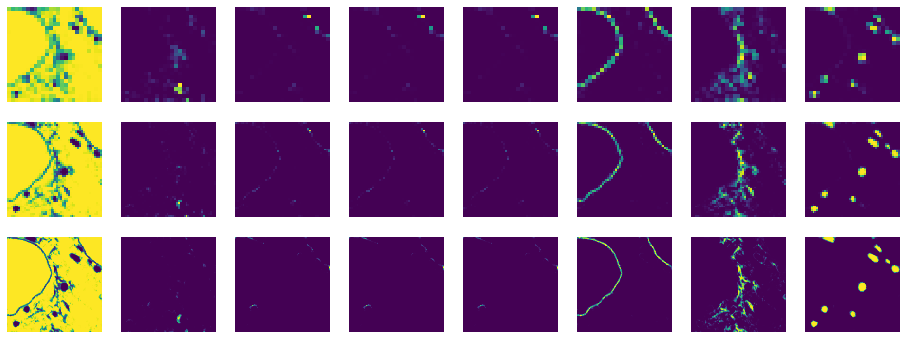

INFO [2019-11-04 22:08:41,662]: Epoch 481: loss= 0.588263
INFO [2019-11-04 22:08:44,961]: Epoch 482: loss= 0.587951
INFO [2019-11-04 22:08:48,260]: Epoch 483: loss= 0.587700
INFO [2019-11-04 22:08:51,322]: Epoch 484: loss= 0.587508
INFO [2019-11-04 22:08:54,351]: Epoch 485: loss= 0.587389
INFO [2019-11-04 22:08:57,352]: Epoch 486: loss= 0.587327
INFO [2019-11-04 22:09:00,362]: Epoch 487: loss= 0.587312
INFO [2019-11-04 22:09:04,367]: Epoch 488: loss= 0.587340
INFO [2019-11-04 22:09:09,639]: Epoch 489: loss= 0.587398
INFO [2019-11-04 22:09:12,966]: Epoch 490: loss= 0.587515


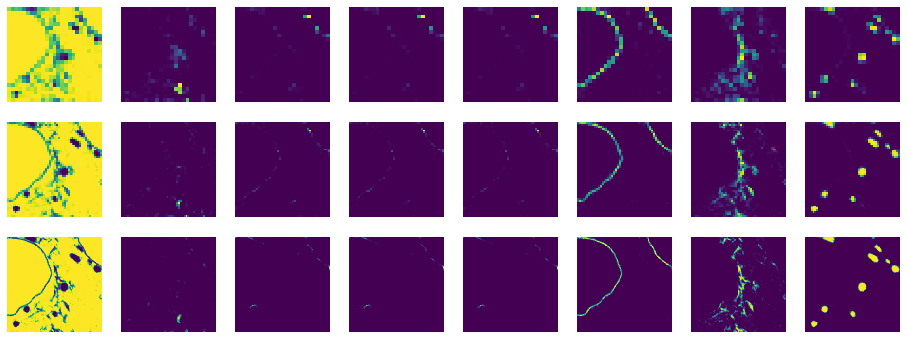

INFO [2019-11-04 22:09:17,424]: Epoch 491: loss= 0.587672
INFO [2019-11-04 22:09:20,758]: Epoch 492: loss= 0.587947
INFO [2019-11-04 22:09:24,210]: Epoch 493: loss= 0.588273
INFO [2019-11-04 22:09:29,485]: Epoch 494: loss= 0.588844
INFO [2019-11-04 22:09:32,567]: Epoch 495: loss= 0.589346
INFO [2019-11-04 22:09:35,671]: Epoch 496: loss= 0.590098
INFO [2019-11-04 22:09:38,725]: Epoch 497: loss= 0.590217
INFO [2019-11-04 22:09:41,719]: Epoch 498: loss= 0.590315
INFO [2019-11-04 22:09:44,749]: Epoch 499: loss= 0.589239
INFO [2019-11-04 22:09:50,394]: Epoch 500: loss= 0.588023


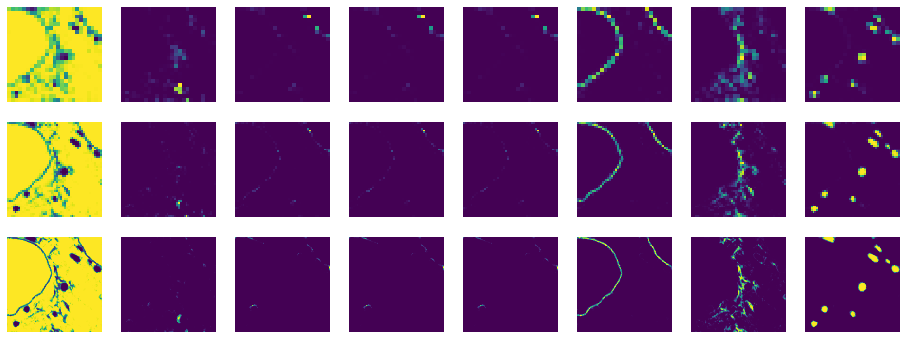

INFO [2019-11-04 22:09:55,952]: Epoch 501: loss= 0.586843
INFO [2019-11-04 22:09:59,858]: Epoch 502: loss= 0.586541
INFO [2019-11-04 22:10:03,268]: Epoch 503: loss= 0.586858
INFO [2019-11-04 22:10:07,009]: Epoch 504: loss= 0.586595
INFO [2019-11-04 22:10:10,123]: Epoch 505: loss= 0.586580
INFO [2019-11-04 22:10:13,437]: Epoch 506: loss= 0.586708
INFO [2019-11-04 22:10:16,451]: Epoch 507: loss= 0.586450
INFO [2019-11-04 22:10:19,709]: Epoch 508: loss= 0.586603
INFO [2019-11-04 22:10:23,033]: Epoch 509: loss= 0.586521
INFO [2019-11-04 22:10:26,165]: Epoch 510: loss= 0.586426


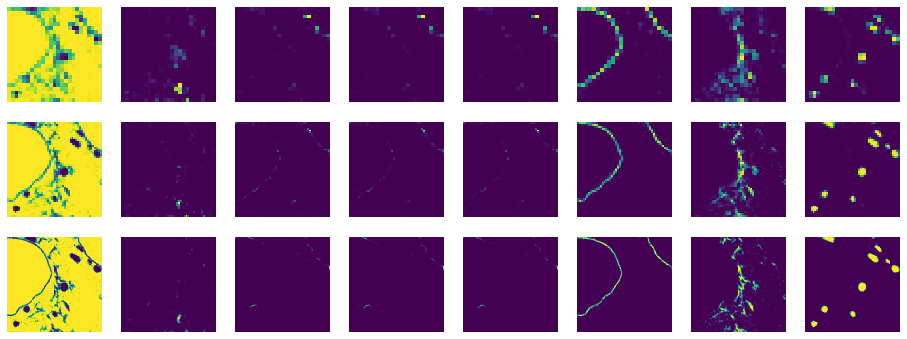

INFO [2019-11-04 22:10:30,555]: Epoch 511: loss= 0.586543
INFO [2019-11-04 22:10:34,165]: Epoch 512: loss= 0.586384
INFO [2019-11-04 22:10:37,364]: Epoch 513: loss= 0.586439
INFO [2019-11-04 22:10:40,583]: Epoch 514: loss= 0.586424
INFO [2019-11-04 22:10:44,525]: Epoch 515: loss= 0.586332
INFO [2019-11-04 22:10:47,926]: Epoch 516: loss= 0.586403
INFO [2019-11-04 22:10:51,237]: Epoch 517: loss= 0.586307
INFO [2019-11-04 22:10:54,265]: Epoch 518: loss= 0.586317
INFO [2019-11-04 22:10:57,294]: Epoch 519: loss= 0.586313
INFO [2019-11-04 22:11:00,304]: Epoch 520: loss= 0.586241


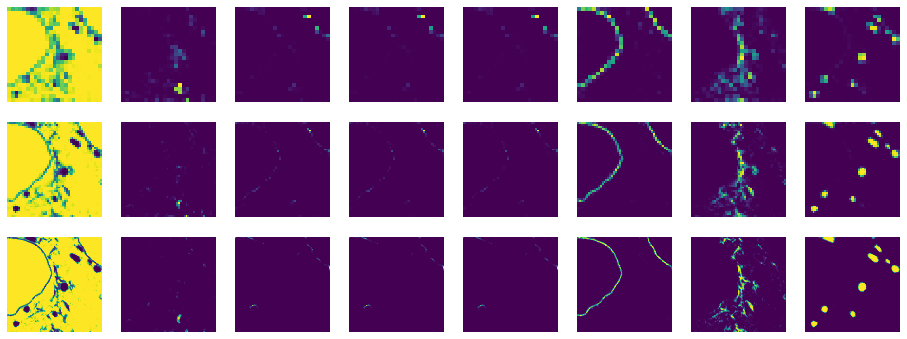

INFO [2019-11-04 22:11:03,937]: Epoch 521: loss= 0.586277
INFO [2019-11-04 22:11:07,448]: Epoch 522: loss= 0.586215
INFO [2019-11-04 22:11:11,195]: Epoch 523: loss= 0.586207
INFO [2019-11-04 22:11:14,856]: Epoch 524: loss= 0.586202
INFO [2019-11-04 22:11:18,569]: Epoch 525: loss= 0.586150
INFO [2019-11-04 22:11:22,116]: Epoch 526: loss= 0.586163
INFO [2019-11-04 22:11:25,786]: Epoch 527: loss= 0.586120
INFO [2019-11-04 22:11:29,132]: Epoch 528: loss= 0.586106
INFO [2019-11-04 22:11:32,520]: Epoch 529: loss= 0.586096
INFO [2019-11-04 22:11:35,893]: Epoch 530: loss= 0.586057


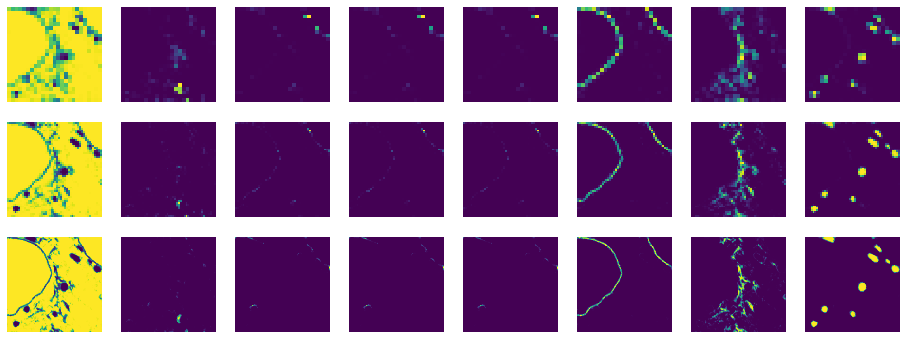

INFO [2019-11-04 22:11:39,865]: Epoch 531: loss= 0.586056
INFO [2019-11-04 22:11:43,053]: Epoch 532: loss= 0.586024
INFO [2019-11-04 22:11:46,549]: Epoch 533: loss= 0.586007
INFO [2019-11-04 22:11:49,718]: Epoch 534: loss= 0.585994
INFO [2019-11-04 22:11:54,077]: Epoch 535: loss= 0.585963
INFO [2019-11-04 22:11:59,557]: Epoch 536: loss= 0.585955
INFO [2019-11-04 22:12:03,563]: Epoch 537: loss= 0.585927
INFO [2019-11-04 22:12:07,244]: Epoch 538: loss= 0.585911
INFO [2019-11-04 22:12:11,108]: Epoch 539: loss= 0.585894
INFO [2019-11-04 22:12:15,548]: Epoch 540: loss= 0.585869


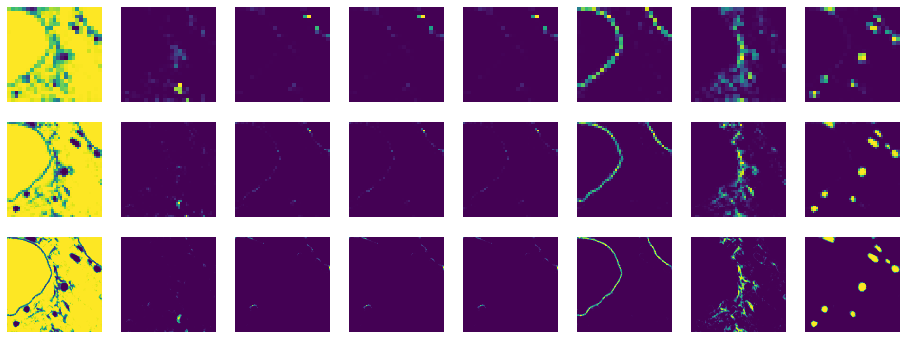

INFO [2019-11-04 22:12:21,331]: Epoch 541: loss= 0.585856
INFO [2019-11-04 22:12:25,745]: Epoch 542: loss= 0.585831
INFO [2019-11-04 22:12:28,957]: Epoch 543: loss= 0.585816
INFO [2019-11-04 22:12:32,519]: Epoch 544: loss= 0.585796
INFO [2019-11-04 22:12:36,160]: Epoch 545: loss= 0.585776
INFO [2019-11-04 22:12:39,773]: Epoch 546: loss= 0.585760
INFO [2019-11-04 22:12:43,115]: Epoch 547: loss= 0.585737
INFO [2019-11-04 22:12:47,210]: Epoch 548: loss= 0.585722
INFO [2019-11-04 22:12:51,096]: Epoch 549: loss= 0.585701
INFO [2019-11-04 22:12:54,599]: Epoch 550: loss= 0.585682


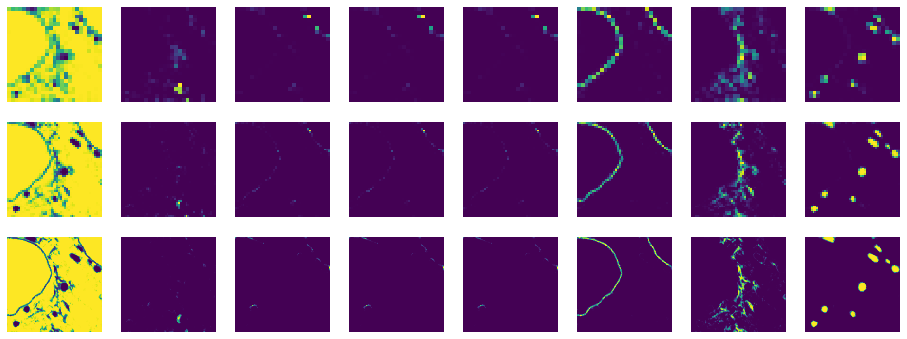

INFO [2019-11-04 22:12:58,405]: Epoch 551: loss= 0.585665
INFO [2019-11-04 22:13:01,597]: Epoch 552: loss= 0.585644
INFO [2019-11-04 22:13:04,892]: Epoch 553: loss= 0.585627
INFO [2019-11-04 22:13:08,791]: Epoch 554: loss= 0.585607
INFO [2019-11-04 22:13:12,270]: Epoch 555: loss= 0.585589
INFO [2019-11-04 22:13:15,667]: Epoch 556: loss= 0.585570
INFO [2019-11-04 22:13:19,251]: Epoch 557: loss= 0.585551
INFO [2019-11-04 22:13:22,741]: Epoch 558: loss= 0.585534
INFO [2019-11-04 22:13:26,848]: Epoch 559: loss= 0.585514
INFO [2019-11-04 22:13:30,696]: Epoch 560: loss= 0.585496


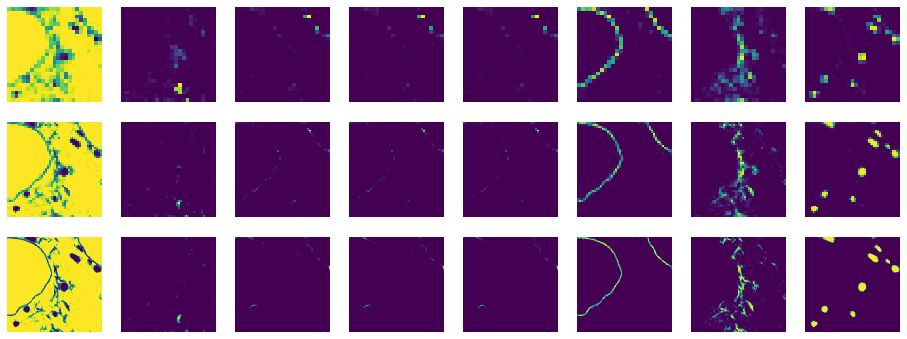

INFO [2019-11-04 22:13:34,648]: Epoch 561: loss= 0.585477
INFO [2019-11-04 22:13:37,962]: Epoch 562: loss= 0.585459
INFO [2019-11-04 22:13:41,082]: Epoch 563: loss= 0.585441
INFO [2019-11-04 22:13:44,290]: Epoch 564: loss= 0.585422
INFO [2019-11-04 22:13:48,306]: Epoch 565: loss= 0.585404
INFO [2019-11-04 22:13:51,997]: Epoch 566: loss= 0.585385
INFO [2019-11-04 22:13:55,224]: Epoch 567: loss= 0.585367
INFO [2019-11-04 22:13:58,528]: Epoch 568: loss= 0.585349
INFO [2019-11-04 22:14:02,121]: Epoch 569: loss= 0.585330
INFO [2019-11-04 22:14:05,879]: Epoch 570: loss= 0.585312


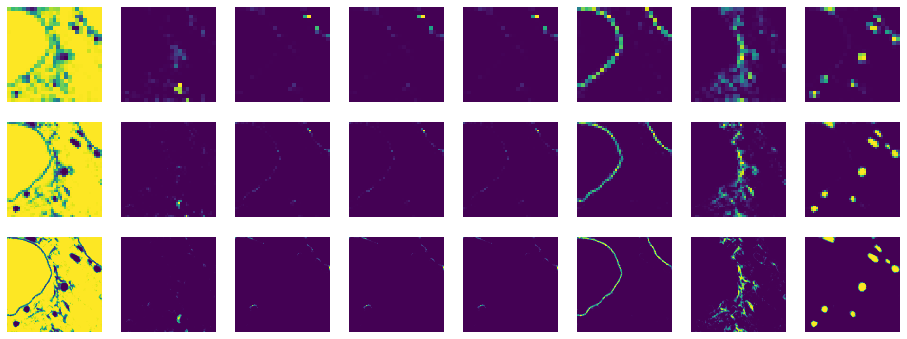

INFO [2019-11-04 22:14:10,714]: Epoch 571: loss= 0.585294
INFO [2019-11-04 22:14:14,604]: Epoch 572: loss= 0.585276
INFO [2019-11-04 22:14:18,192]: Epoch 573: loss= 0.585257
INFO [2019-11-04 22:14:21,811]: Epoch 574: loss= 0.585239
INFO [2019-11-04 22:14:25,444]: Epoch 575: loss= 0.585221
INFO [2019-11-04 22:14:29,177]: Epoch 576: loss= 0.585203
INFO [2019-11-04 22:14:32,612]: Epoch 577: loss= 0.585185
INFO [2019-11-04 22:14:37,569]: Epoch 578: loss= 0.585167
INFO [2019-11-04 22:14:41,257]: Epoch 579: loss= 0.585149
INFO [2019-11-04 22:14:44,824]: Epoch 580: loss= 0.585131


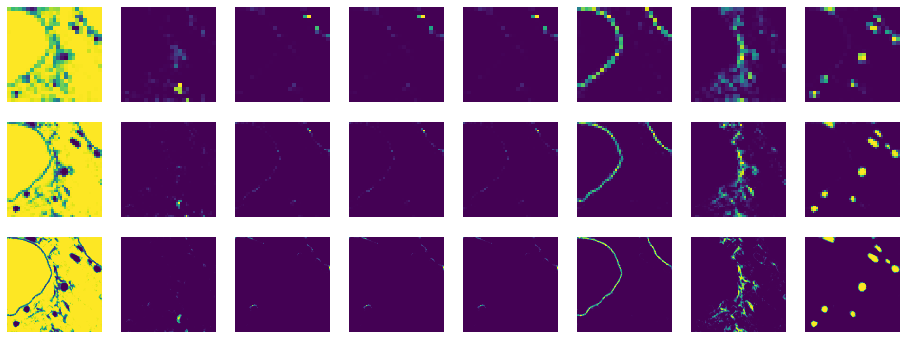

INFO [2019-11-04 22:14:49,234]: Epoch 581: loss= 0.585113
INFO [2019-11-04 22:14:52,543]: Epoch 582: loss= 0.585095
INFO [2019-11-04 22:14:57,431]: Epoch 583: loss= 0.585077
INFO [2019-11-04 22:15:03,069]: Epoch 584: loss= 0.585059
INFO [2019-11-04 22:15:08,922]: Epoch 585: loss= 0.585042
INFO [2019-11-04 22:15:14,354]: Epoch 586: loss= 0.585024
INFO [2019-11-04 22:15:18,790]: Epoch 587: loss= 0.585006
INFO [2019-11-04 22:15:23,048]: Epoch 588: loss= 0.584988
INFO [2019-11-04 22:15:27,276]: Epoch 589: loss= 0.584971
INFO [2019-11-04 22:15:31,610]: Epoch 590: loss= 0.584953


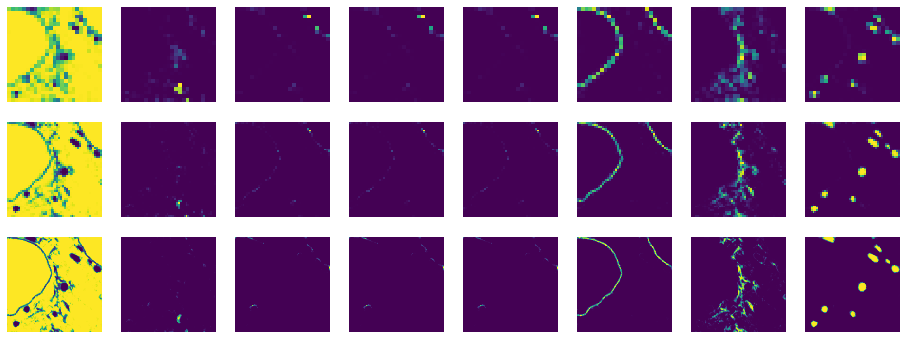

INFO [2019-11-04 22:15:36,841]: Epoch 591: loss= 0.584935
INFO [2019-11-04 22:15:41,331]: Epoch 592: loss= 0.584917
INFO [2019-11-04 22:15:45,708]: Epoch 593: loss= 0.584900
INFO [2019-11-04 22:15:50,175]: Epoch 594: loss= 0.584882
INFO [2019-11-04 22:15:54,439]: Epoch 595: loss= 0.584865
INFO [2019-11-04 22:15:58,705]: Epoch 596: loss= 0.584847
INFO [2019-11-04 22:16:03,370]: Epoch 597: loss= 0.584829
INFO [2019-11-04 22:16:07,131]: Epoch 598: loss= 0.584812
INFO [2019-11-04 22:16:12,646]: Epoch 599: loss= 0.584794
INFO [2019-11-04 22:16:17,328]: Epoch 600: loss= 0.584777


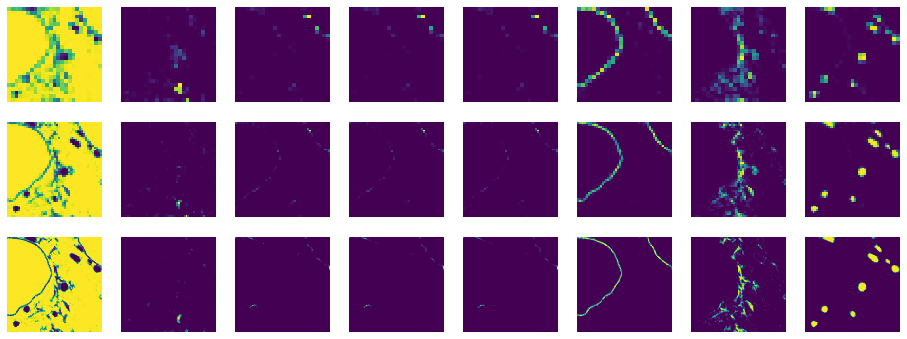

INFO [2019-11-04 22:16:22,684]: Epoch 601: loss= 0.584759
INFO [2019-11-04 22:16:26,971]: Epoch 602: loss= 0.584742
INFO [2019-11-04 22:16:31,203]: Epoch 603: loss= 0.584724
INFO [2019-11-04 22:16:35,379]: Epoch 604: loss= 0.584707
INFO [2019-11-04 22:16:39,680]: Epoch 605: loss= 0.584689
INFO [2019-11-04 22:16:43,959]: Epoch 606: loss= 0.584672
INFO [2019-11-04 22:16:49,015]: Epoch 607: loss= 0.584655
INFO [2019-11-04 22:16:53,405]: Epoch 608: loss= 0.584637
INFO [2019-11-04 22:16:57,939]: Epoch 609: loss= 0.584620
INFO [2019-11-04 22:17:02,507]: Epoch 610: loss= 0.584603


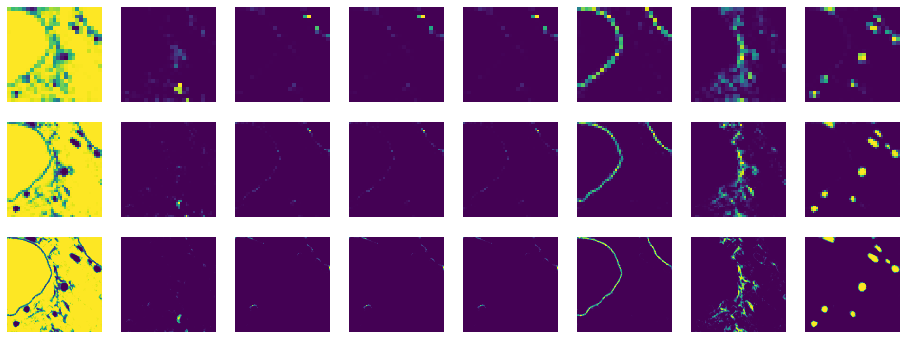

INFO [2019-11-04 22:17:07,597]: Epoch 611: loss= 0.584585
INFO [2019-11-04 22:17:11,902]: Epoch 612: loss= 0.584568
INFO [2019-11-04 22:17:16,282]: Epoch 613: loss= 0.584551
INFO [2019-11-04 22:17:20,630]: Epoch 614: loss= 0.584534
INFO [2019-11-04 22:17:24,824]: Epoch 615: loss= 0.584516
INFO [2019-11-04 22:17:29,157]: Epoch 616: loss= 0.584499
INFO [2019-11-04 22:17:33,535]: Epoch 617: loss= 0.584482
INFO [2019-11-04 22:17:38,207]: Epoch 618: loss= 0.584465
INFO [2019-11-04 22:17:42,519]: Epoch 619: loss= 0.584448
INFO [2019-11-04 22:17:47,032]: Epoch 620: loss= 0.584431


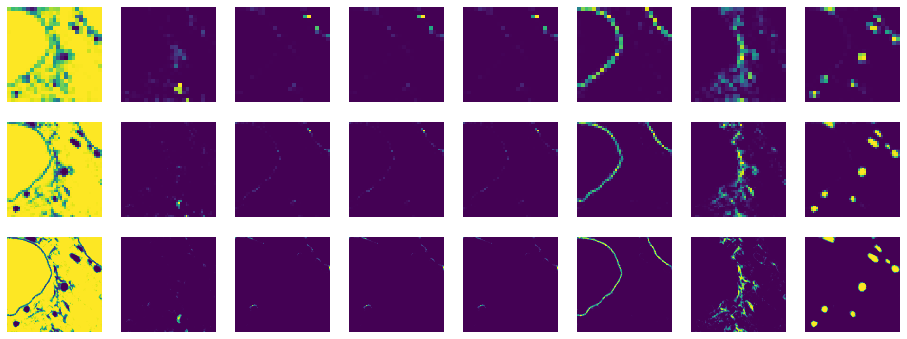

INFO [2019-11-04 22:17:52,495]: Epoch 621: loss= 0.584414
INFO [2019-11-04 22:17:56,824]: Epoch 622: loss= 0.584397
INFO [2019-11-04 22:18:01,283]: Epoch 623: loss= 0.584380
INFO [2019-11-04 22:18:05,693]: Epoch 624: loss= 0.584363
INFO [2019-11-04 22:18:09,970]: Epoch 625: loss= 0.584346
INFO [2019-11-04 22:18:14,197]: Epoch 626: loss= 0.584329
INFO [2019-11-04 22:18:18,443]: Epoch 627: loss= 0.584312
INFO [2019-11-04 22:18:22,687]: Epoch 628: loss= 0.584295
INFO [2019-11-04 22:18:26,880]: Epoch 629: loss= 0.584278
INFO [2019-11-04 22:18:31,099]: Epoch 630: loss= 0.584261


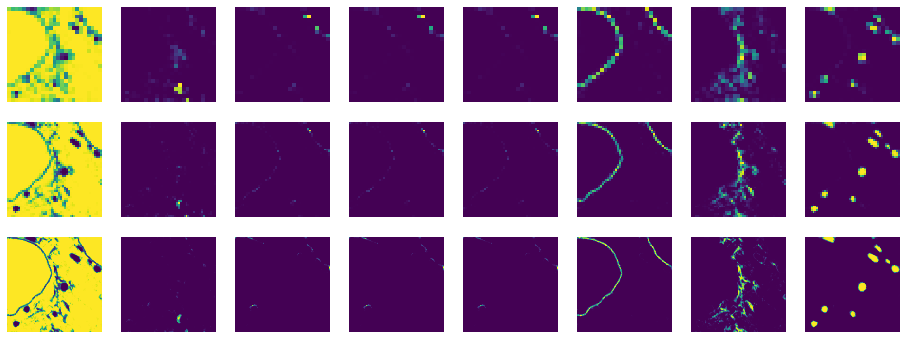

INFO [2019-11-04 22:18:37,214]: Epoch 631: loss= 0.584244
INFO [2019-11-04 22:18:41,571]: Epoch 632: loss= 0.584227
INFO [2019-11-04 22:18:45,310]: Epoch 633: loss= 0.584211
INFO [2019-11-04 22:18:48,691]: Epoch 634: loss= 0.584194
INFO [2019-11-04 22:18:52,112]: Epoch 635: loss= 0.584177
INFO [2019-11-04 22:18:55,094]: Epoch 636: loss= 0.584160
INFO [2019-11-04 22:18:58,776]: Epoch 637: loss= 0.584143
INFO [2019-11-04 22:19:01,892]: Epoch 638: loss= 0.584127
INFO [2019-11-04 22:19:04,961]: Epoch 639: loss= 0.584110
INFO [2019-11-04 22:19:08,036]: Epoch 640: loss= 0.584093


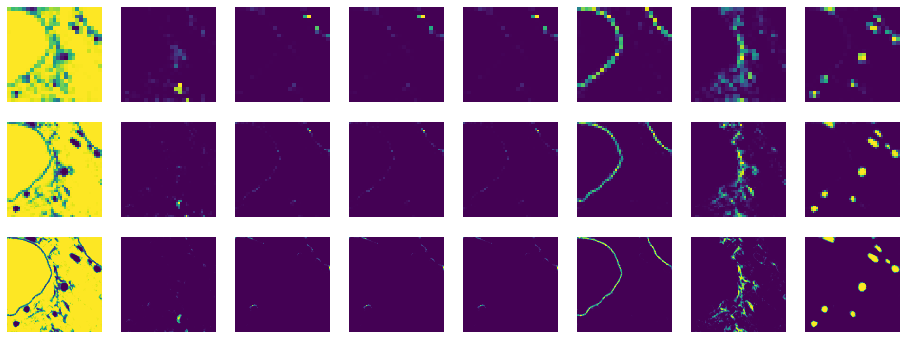

INFO [2019-11-04 22:19:11,612]: Epoch 641: loss= 0.584076
INFO [2019-11-04 22:19:14,614]: Epoch 642: loss= 0.584060
INFO [2019-11-04 22:19:18,451]: Epoch 643: loss= 0.584043
INFO [2019-11-04 22:19:22,509]: Epoch 644: loss= 0.584026
INFO [2019-11-04 22:19:25,512]: Epoch 645: loss= 0.584010
INFO [2019-11-04 22:19:28,497]: Epoch 646: loss= 0.583993
INFO [2019-11-04 22:19:31,492]: Epoch 647: loss= 0.583977
INFO [2019-11-04 22:19:34,585]: Epoch 648: loss= 0.583960
INFO [2019-11-04 22:19:39,050]: Epoch 649: loss= 0.583944
INFO [2019-11-04 22:19:43,385]: Epoch 650: loss= 0.583927


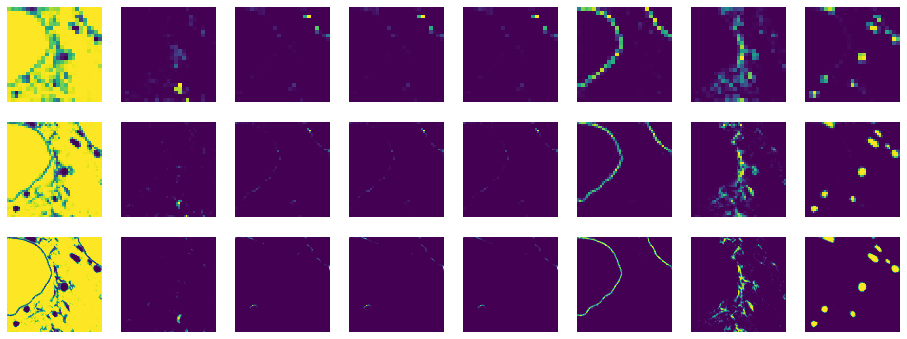

INFO [2019-11-04 22:19:49,118]: Epoch 651: loss= 0.583911
INFO [2019-11-04 22:19:52,832]: Epoch 652: loss= 0.583894
INFO [2019-11-04 22:19:55,935]: Epoch 653: loss= 0.583878
INFO [2019-11-04 22:19:59,029]: Epoch 654: loss= 0.583861
INFO [2019-11-04 22:20:02,354]: Epoch 655: loss= 0.583845
INFO [2019-11-04 22:20:05,596]: Epoch 656: loss= 0.583828
INFO [2019-11-04 22:20:09,009]: Epoch 657: loss= 0.583812
INFO [2019-11-04 22:20:12,000]: Epoch 658: loss= 0.583795
INFO [2019-11-04 22:20:14,991]: Epoch 659: loss= 0.583779
INFO [2019-11-04 22:20:18,036]: Epoch 660: loss= 0.583763


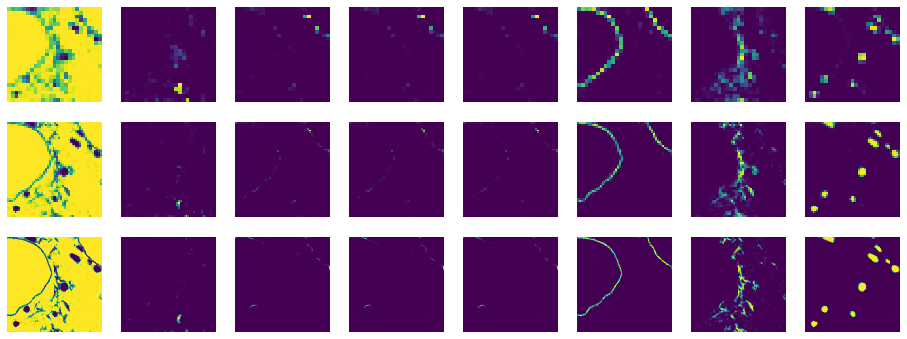

INFO [2019-11-04 22:20:21,742]: Epoch 661: loss= 0.583746
INFO [2019-11-04 22:20:25,077]: Epoch 662: loss= 0.583730
INFO [2019-11-04 22:20:28,125]: Epoch 663: loss= 0.583714
INFO [2019-11-04 22:20:31,490]: Epoch 664: loss= 0.583697
INFO [2019-11-04 22:20:35,598]: Epoch 665: loss= 0.583681
INFO [2019-11-04 22:20:39,429]: Epoch 666: loss= 0.583665
INFO [2019-11-04 22:20:43,192]: Epoch 667: loss= 0.583649
INFO [2019-11-04 22:20:47,490]: Epoch 668: loss= 0.583633
INFO [2019-11-04 22:20:51,144]: Epoch 669: loss= 0.583616
INFO [2019-11-04 22:20:54,296]: Epoch 670: loss= 0.583600


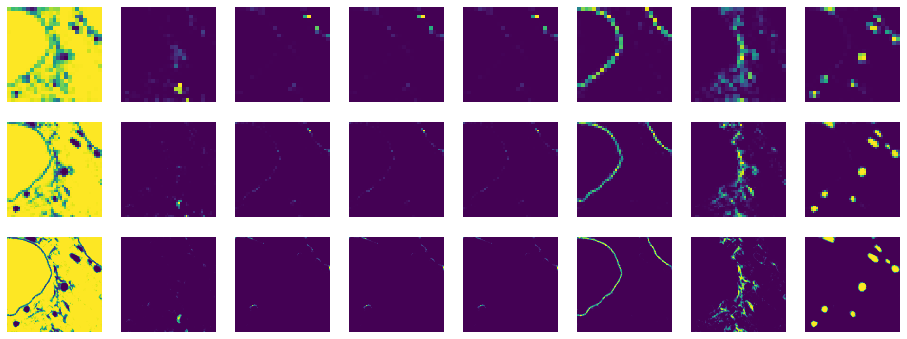

INFO [2019-11-04 22:21:01,390]: Epoch 671: loss= 0.583584
INFO [2019-11-04 22:21:07,365]: Epoch 672: loss= 0.583568
INFO [2019-11-04 22:21:11,596]: Epoch 673: loss= 0.583552
INFO [2019-11-04 22:21:15,932]: Epoch 674: loss= 0.583536
INFO [2019-11-04 22:21:19,819]: Epoch 675: loss= 0.583520
INFO [2019-11-04 22:21:23,173]: Epoch 676: loss= 0.583504
INFO [2019-11-04 22:21:26,203]: Epoch 677: loss= 0.583488
INFO [2019-11-04 22:21:29,217]: Epoch 678: loss= 0.583472
INFO [2019-11-04 22:21:33,409]: Epoch 679: loss= 0.583456
INFO [2019-11-04 22:21:38,216]: Epoch 680: loss= 0.583440


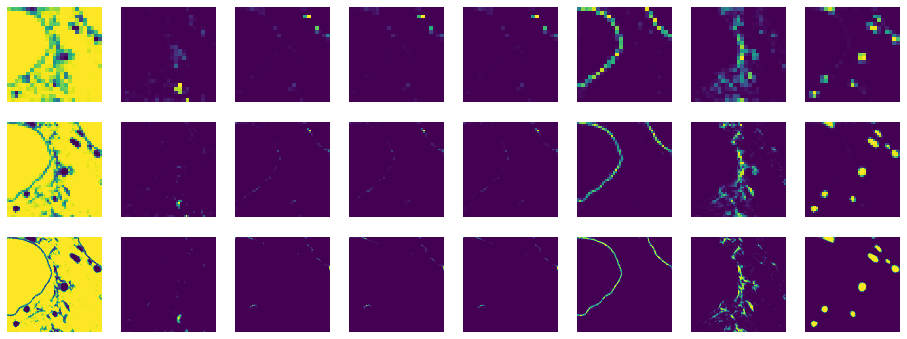

INFO [2019-11-04 22:21:42,697]: Epoch 681: loss= 0.583424
INFO [2019-11-04 22:21:45,984]: Epoch 682: loss= 0.583408
INFO [2019-11-04 22:21:49,829]: Epoch 683: loss= 0.583392
INFO [2019-11-04 22:21:55,960]: Epoch 684: loss= 0.583376
INFO [2019-11-04 22:21:59,769]: Epoch 685: loss= 0.583360
INFO [2019-11-04 22:22:03,372]: Epoch 686: loss= 0.583344
INFO [2019-11-04 22:22:07,197]: Epoch 687: loss= 0.583328
INFO [2019-11-04 22:22:10,861]: Epoch 688: loss= 0.583312
INFO [2019-11-04 22:22:14,574]: Epoch 689: loss= 0.583297
INFO [2019-11-04 22:22:19,909]: Epoch 690: loss= 0.583281


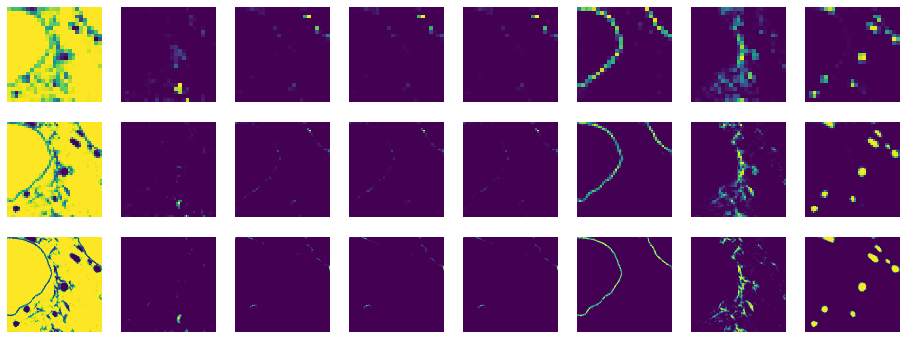

INFO [2019-11-04 22:22:24,459]: Epoch 691: loss= 0.583265
INFO [2019-11-04 22:22:29,057]: Epoch 692: loss= 0.583249
INFO [2019-11-04 22:22:34,471]: Epoch 693: loss= 0.583234
INFO [2019-11-04 22:22:37,622]: Epoch 694: loss= 0.583218
INFO [2019-11-04 22:22:41,555]: Epoch 695: loss= 0.583202
INFO [2019-11-04 22:22:44,882]: Epoch 696: loss= 0.583187
INFO [2019-11-04 22:22:48,257]: Epoch 697: loss= 0.583171
INFO [2019-11-04 22:22:51,412]: Epoch 698: loss= 0.583155
INFO [2019-11-04 22:22:54,613]: Epoch 699: loss= 0.583139
INFO [2019-11-04 22:22:57,653]: Epoch 700: loss= 0.583124


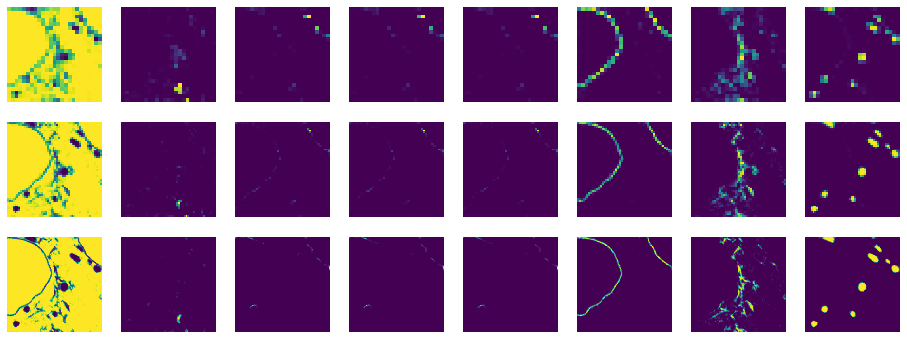

INFO [2019-11-04 22:23:01,409]: Epoch 701: loss= 0.583108
INFO [2019-11-04 22:23:04,437]: Epoch 702: loss= 0.583093
INFO [2019-11-04 22:23:07,524]: Epoch 703: loss= 0.583077
INFO [2019-11-04 22:23:10,543]: Epoch 704: loss= 0.583061
INFO [2019-11-04 22:23:13,587]: Epoch 705: loss= 0.583046
INFO [2019-11-04 22:23:16,637]: Epoch 706: loss= 0.583030
INFO [2019-11-04 22:23:21,239]: Epoch 707: loss= 0.583015
INFO [2019-11-04 22:23:27,228]: Epoch 708: loss= 0.582999
INFO [2019-11-04 22:23:32,243]: Epoch 709: loss= 0.582984
INFO [2019-11-04 22:23:35,585]: Epoch 710: loss= 0.582968


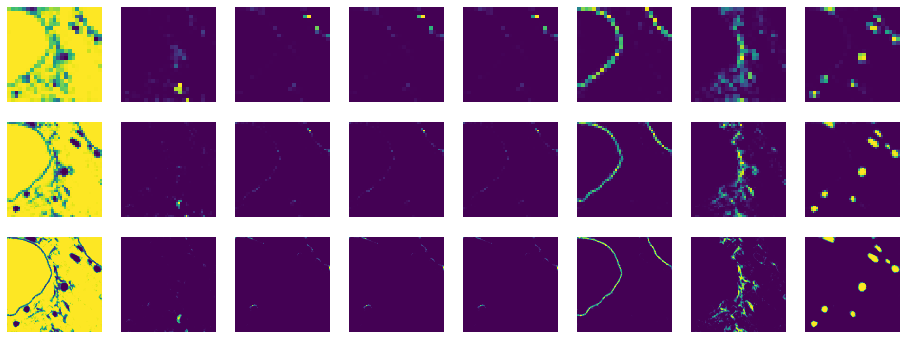

INFO [2019-11-04 22:23:39,376]: Epoch 711: loss= 0.582953
INFO [2019-11-04 22:23:42,444]: Epoch 712: loss= 0.582937
INFO [2019-11-04 22:23:45,634]: Epoch 713: loss= 0.582922
INFO [2019-11-04 22:23:50,825]: Epoch 714: loss= 0.582907
INFO [2019-11-04 22:23:56,241]: Epoch 715: loss= 0.582891
INFO [2019-11-04 22:24:00,703]: Epoch 716: loss= 0.582876
INFO [2019-11-04 22:24:04,482]: Epoch 717: loss= 0.582860
INFO [2019-11-04 22:24:08,241]: Epoch 718: loss= 0.582845
INFO [2019-11-04 22:24:12,261]: Epoch 719: loss= 0.582830
INFO [2019-11-04 22:24:16,941]: Epoch 720: loss= 0.582814


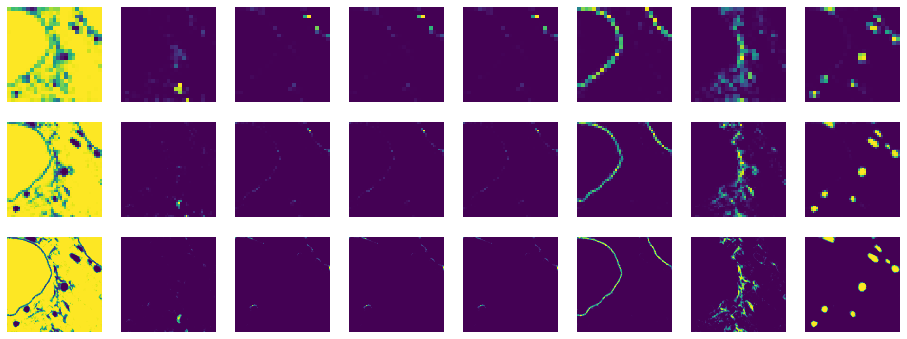

INFO [2019-11-04 22:24:20,940]: Epoch 721: loss= 0.582799
INFO [2019-11-04 22:24:24,005]: Epoch 722: loss= 0.582784
INFO [2019-11-04 22:24:27,039]: Epoch 723: loss= 0.582768
INFO [2019-11-04 22:24:30,053]: Epoch 724: loss= 0.582753
INFO [2019-11-04 22:24:33,075]: Epoch 725: loss= 0.582737
INFO [2019-11-04 22:24:36,092]: Epoch 726: loss= 0.582722
INFO [2019-11-04 22:24:39,124]: Epoch 727: loss= 0.582707
INFO [2019-11-04 22:24:42,242]: Epoch 728: loss= 0.582692
INFO [2019-11-04 22:24:46,077]: Epoch 729: loss= 0.582676
INFO [2019-11-04 22:24:50,414]: Epoch 730: loss= 0.582661


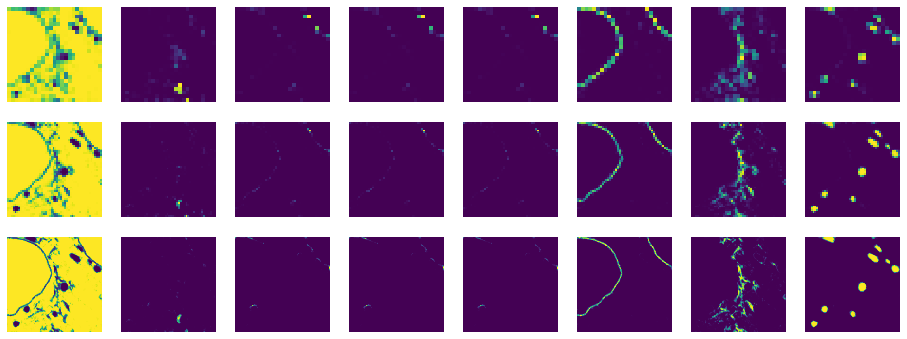

INFO [2019-11-04 22:24:55,158]: Epoch 731: loss= 0.582646
INFO [2019-11-04 22:24:59,241]: Epoch 732: loss= 0.582630
INFO [2019-11-04 22:25:03,064]: Epoch 733: loss= 0.582615
INFO [2019-11-04 22:25:06,626]: Epoch 734: loss= 0.582600
INFO [2019-11-04 22:25:10,065]: Epoch 735: loss= 0.582585
INFO [2019-11-04 22:25:13,051]: Epoch 736: loss= 0.582569
INFO [2019-11-04 22:25:16,152]: Epoch 737: loss= 0.582554
INFO [2019-11-04 22:25:19,162]: Epoch 738: loss= 0.582539
INFO [2019-11-04 22:25:22,191]: Epoch 739: loss= 0.582524
INFO [2019-11-04 22:25:25,210]: Epoch 740: loss= 0.582509


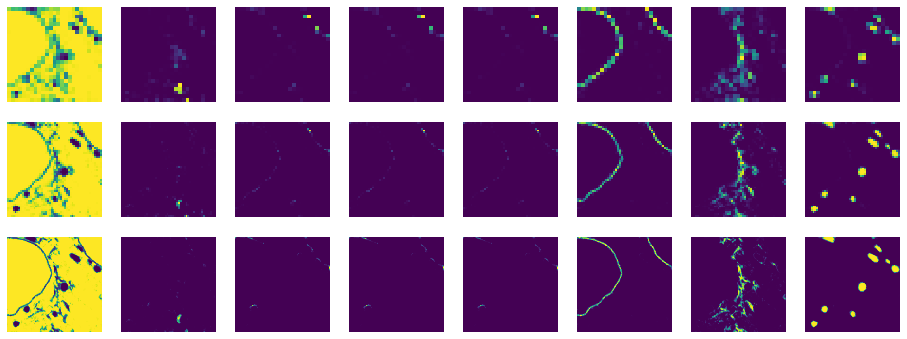

INFO [2019-11-04 22:25:28,840]: Epoch 741: loss= 0.582493
INFO [2019-11-04 22:25:31,950]: Epoch 742: loss= 0.582478
INFO [2019-11-04 22:25:34,976]: Epoch 743: loss= 0.582463
INFO [2019-11-04 22:25:38,034]: Epoch 744: loss= 0.582448
INFO [2019-11-04 22:25:41,091]: Epoch 745: loss= 0.582433
INFO [2019-11-04 22:25:44,117]: Epoch 746: loss= 0.582418
INFO [2019-11-04 22:25:47,140]: Epoch 747: loss= 0.582403
INFO [2019-11-04 22:25:50,233]: Epoch 748: loss= 0.582388
INFO [2019-11-04 22:25:53,251]: Epoch 749: loss= 0.582373
INFO [2019-11-04 22:25:56,356]: Epoch 750: loss= 0.582358


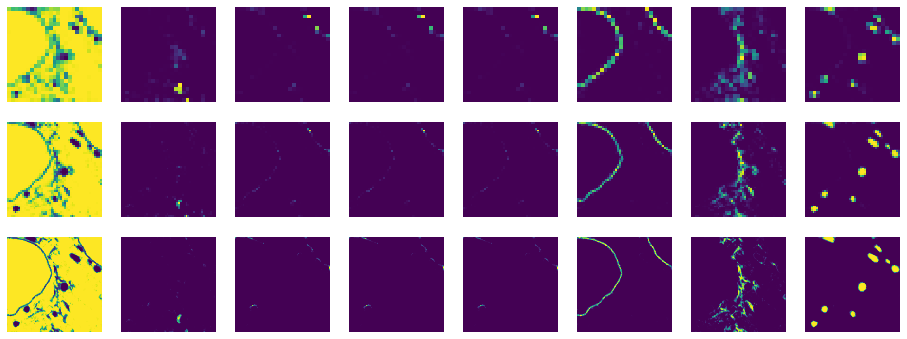

INFO [2019-11-04 22:26:00,092]: Epoch 751: loss= 0.582343
INFO [2019-11-04 22:26:03,325]: Epoch 752: loss= 0.582328
INFO [2019-11-04 22:26:06,350]: Epoch 753: loss= 0.582313
INFO [2019-11-04 22:26:09,411]: Epoch 754: loss= 0.582298
INFO [2019-11-04 22:26:12,406]: Epoch 755: loss= 0.582283
INFO [2019-11-04 22:26:15,574]: Epoch 756: loss= 0.582268
INFO [2019-11-04 22:26:18,611]: Epoch 757: loss= 0.582253
INFO [2019-11-04 22:26:21,715]: Epoch 758: loss= 0.582238
INFO [2019-11-04 22:26:24,718]: Epoch 759: loss= 0.582224
INFO [2019-11-04 22:26:27,752]: Epoch 760: loss= 0.582209


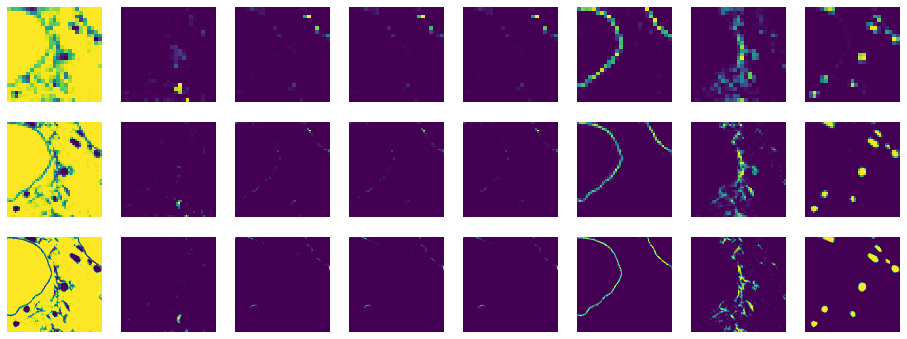

INFO [2019-11-04 22:26:31,442]: Epoch 761: loss= 0.582194
INFO [2019-11-04 22:26:34,451]: Epoch 762: loss= 0.582179
INFO [2019-11-04 22:26:37,448]: Epoch 763: loss= 0.582164
INFO [2019-11-04 22:26:40,489]: Epoch 764: loss= 0.582149
INFO [2019-11-04 22:26:43,487]: Epoch 765: loss= 0.582135
INFO [2019-11-04 22:26:47,198]: Epoch 766: loss= 0.582120
INFO [2019-11-04 22:26:50,284]: Epoch 767: loss= 0.582105
INFO [2019-11-04 22:26:53,498]: Epoch 768: loss= 0.582090
INFO [2019-11-04 22:26:56,535]: Epoch 769: loss= 0.582076
INFO [2019-11-04 22:26:59,528]: Epoch 770: loss= 0.582061


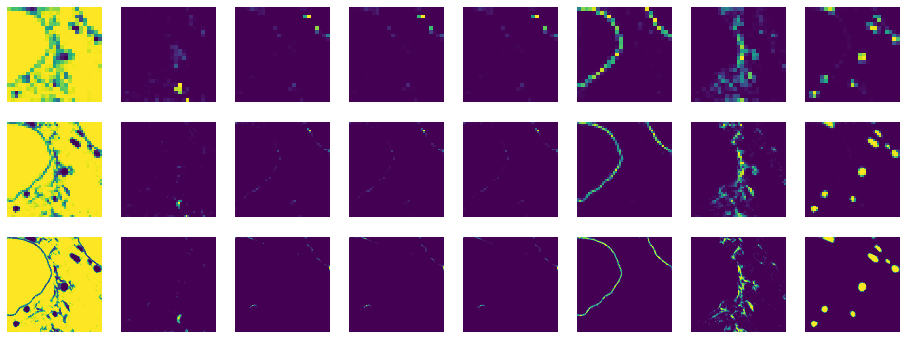

INFO [2019-11-04 22:27:03,231]: Epoch 771: loss= 0.582046
INFO [2019-11-04 22:27:06,292]: Epoch 772: loss= 0.582031
INFO [2019-11-04 22:27:09,333]: Epoch 773: loss= 0.582017
INFO [2019-11-04 22:27:12,519]: Epoch 774: loss= 0.582002
INFO [2019-11-04 22:27:15,711]: Epoch 775: loss= 0.581987
INFO [2019-11-04 22:27:18,675]: Epoch 776: loss= 0.581973
INFO [2019-11-04 22:27:21,618]: Epoch 777: loss= 0.581958
INFO [2019-11-04 22:27:24,567]: Epoch 778: loss= 0.581943
INFO [2019-11-04 22:27:27,481]: Epoch 779: loss= 0.581929
INFO [2019-11-04 22:27:30,401]: Epoch 780: loss= 0.581914


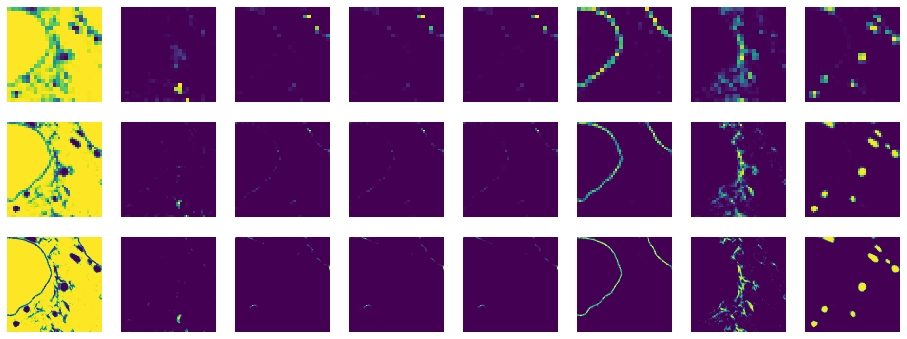

INFO [2019-11-04 22:27:34,007]: Epoch 781: loss= 0.581900
INFO [2019-11-04 22:27:36,968]: Epoch 782: loss= 0.581885
INFO [2019-11-04 22:27:39,910]: Epoch 783: loss= 0.581871
INFO [2019-11-04 22:27:42,834]: Epoch 784: loss= 0.581856
INFO [2019-11-04 22:27:45,764]: Epoch 785: loss= 0.581842
INFO [2019-11-04 22:27:48,702]: Epoch 786: loss= 0.581828
INFO [2019-11-04 22:27:51,657]: Epoch 787: loss= 0.581813
INFO [2019-11-04 22:27:54,725]: Epoch 788: loss= 0.581799
INFO [2019-11-04 22:27:57,666]: Epoch 789: loss= 0.581785
INFO [2019-11-04 22:28:00,626]: Epoch 790: loss= 0.581770


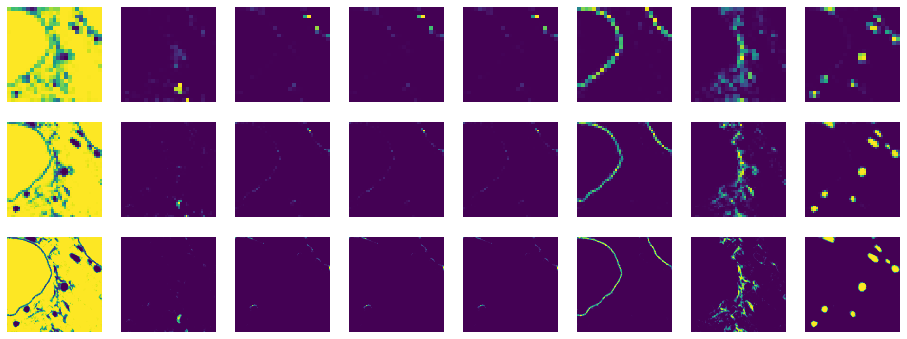

INFO [2019-11-04 22:28:04,288]: Epoch 791: loss= 0.581756
INFO [2019-11-04 22:28:07,260]: Epoch 792: loss= 0.581742
INFO [2019-11-04 22:28:10,184]: Epoch 793: loss= 0.581727
INFO [2019-11-04 22:28:13,174]: Epoch 794: loss= 0.581713
INFO [2019-11-04 22:28:16,117]: Epoch 795: loss= 0.581699
INFO [2019-11-04 22:28:19,044]: Epoch 796: loss= 0.581685
INFO [2019-11-04 22:28:21,983]: Epoch 797: loss= 0.581670
INFO [2019-11-04 22:28:24,975]: Epoch 798: loss= 0.581656
INFO [2019-11-04 22:28:27,964]: Epoch 799: loss= 0.581642
INFO [2019-11-04 22:28:31,552]: Epoch 800: loss= 0.581628


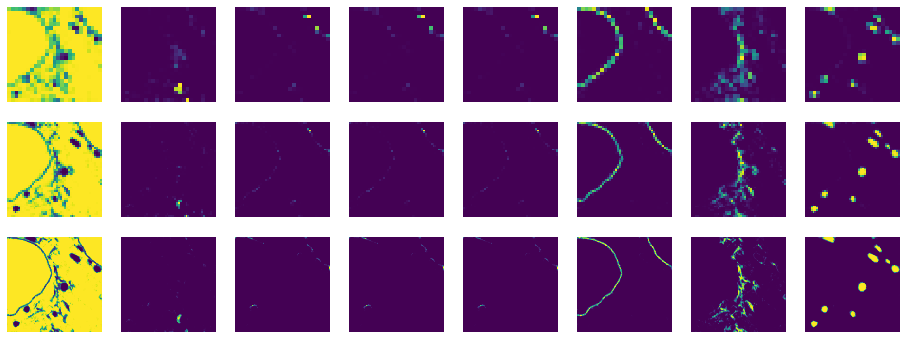

INFO [2019-11-04 22:28:35,118]: Epoch 801: loss= 0.581614
INFO [2019-11-04 22:28:38,064]: Epoch 802: loss= 0.581600
INFO [2019-11-04 22:28:41,009]: Epoch 803: loss= 0.581585
INFO [2019-11-04 22:28:43,958]: Epoch 804: loss= 0.581571
INFO [2019-11-04 22:28:47,548]: Epoch 805: loss= 0.581557
INFO [2019-11-04 22:28:50,519]: Epoch 806: loss= 0.581543
INFO [2019-11-04 22:28:53,470]: Epoch 807: loss= 0.581529
INFO [2019-11-04 22:28:56,440]: Epoch 808: loss= 0.581515
INFO [2019-11-04 22:28:59,362]: Epoch 809: loss= 0.581501
INFO [2019-11-04 22:29:02,331]: Epoch 810: loss= 0.581487


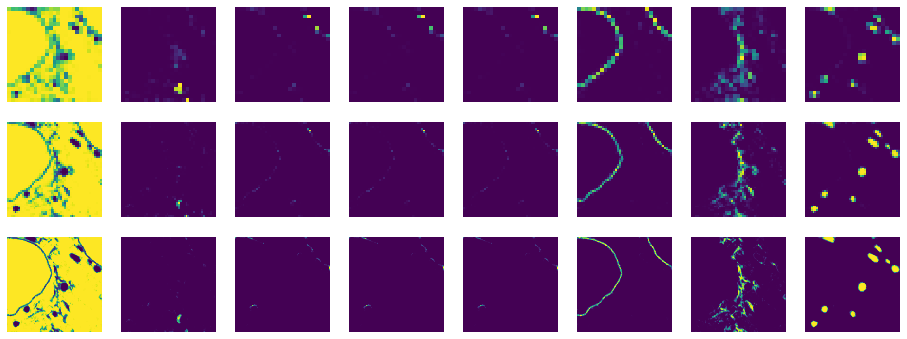

INFO [2019-11-04 22:29:06,086]: Epoch 811: loss= 0.581473
INFO [2019-11-04 22:29:09,045]: Epoch 812: loss= 0.581459
INFO [2019-11-04 22:29:12,026]: Epoch 813: loss= 0.581445
INFO [2019-11-04 22:29:15,004]: Epoch 814: loss= 0.581431
INFO [2019-11-04 22:29:17,960]: Epoch 815: loss= 0.581417
INFO [2019-11-04 22:29:20,961]: Epoch 816: loss= 0.581403
INFO [2019-11-04 22:29:23,945]: Epoch 817: loss= 0.581389
INFO [2019-11-04 22:29:26,923]: Epoch 818: loss= 0.581375
INFO [2019-11-04 22:29:29,848]: Epoch 819: loss= 0.581361
INFO [2019-11-04 22:29:32,794]: Epoch 820: loss= 0.581348


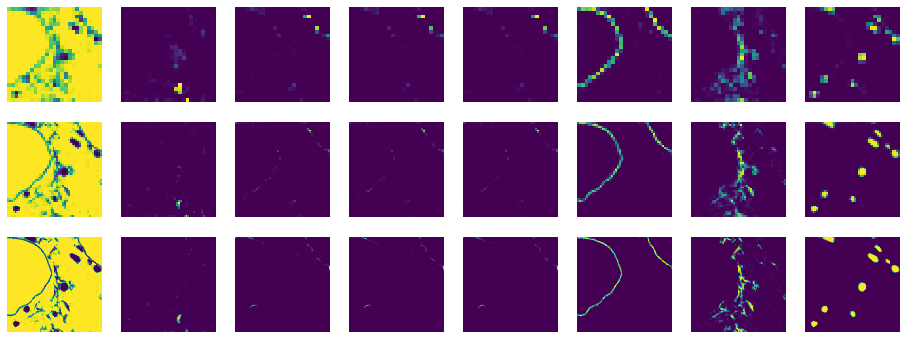

INFO [2019-11-04 22:29:36,410]: Epoch 821: loss= 0.581334
INFO [2019-11-04 22:29:39,355]: Epoch 822: loss= 0.581320
INFO [2019-11-04 22:29:42,294]: Epoch 823: loss= 0.581306
INFO [2019-11-04 22:29:45,220]: Epoch 824: loss= 0.581292
INFO [2019-11-04 22:29:48,143]: Epoch 825: loss= 0.581279
INFO [2019-11-04 22:29:51,091]: Epoch 826: loss= 0.581265
INFO [2019-11-04 22:29:54,008]: Epoch 827: loss= 0.581251
INFO [2019-11-04 22:29:56,970]: Epoch 828: loss= 0.581237
INFO [2019-11-04 22:29:59,893]: Epoch 829: loss= 0.581224
INFO [2019-11-04 22:30:02,916]: Epoch 830: loss= 0.581210


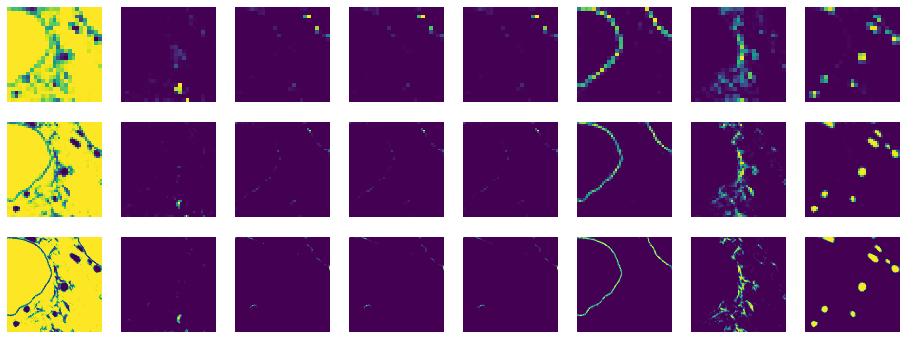

INFO [2019-11-04 22:30:06,608]: Epoch 831: loss= 0.581196
INFO [2019-11-04 22:30:09,555]: Epoch 832: loss= 0.581182
INFO [2019-11-04 22:30:12,537]: Epoch 833: loss= 0.581169
INFO [2019-11-04 22:30:15,761]: Epoch 834: loss= 0.581155
INFO [2019-11-04 22:30:20,071]: Epoch 835: loss= 0.581142
INFO [2019-11-04 22:30:23,574]: Epoch 836: loss= 0.581128
INFO [2019-11-04 22:30:27,738]: Epoch 837: loss= 0.581114
INFO [2019-11-04 22:30:32,399]: Epoch 838: loss= 0.581101
INFO [2019-11-04 22:30:36,821]: Epoch 839: loss= 0.581087
INFO [2019-11-04 22:30:40,343]: Epoch 840: loss= 0.581074


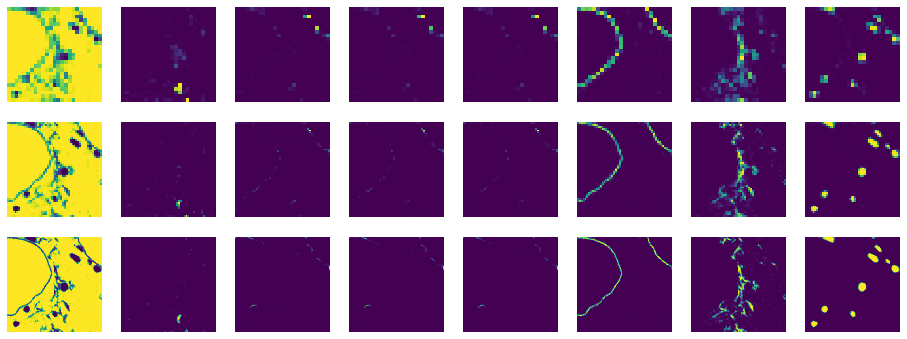

INFO [2019-11-04 22:30:45,053]: Epoch 841: loss= 0.581060
INFO [2019-11-04 22:30:49,342]: Epoch 842: loss= 0.581046
INFO [2019-11-04 22:30:52,458]: Epoch 843: loss= 0.581033
INFO [2019-11-04 22:30:55,662]: Epoch 844: loss= 0.581019
INFO [2019-11-04 22:30:59,728]: Epoch 845: loss= 0.581006
INFO [2019-11-04 22:31:05,213]: Epoch 846: loss= 0.580992
INFO [2019-11-04 22:31:12,079]: Epoch 847: loss= 0.580979
INFO [2019-11-04 22:31:18,190]: Epoch 848: loss= 0.580965
INFO [2019-11-04 22:31:24,279]: Epoch 849: loss= 0.580951
INFO [2019-11-04 22:31:30,596]: Epoch 850: loss= 0.580938


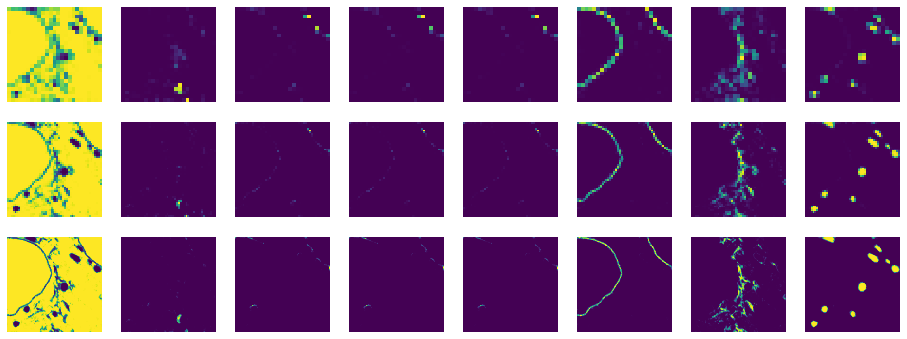

INFO [2019-11-04 22:31:34,930]: Epoch 851: loss= 0.580924
INFO [2019-11-04 22:31:38,068]: Epoch 852: loss= 0.580911
INFO [2019-11-04 22:31:41,398]: Epoch 853: loss= 0.580898
INFO [2019-11-04 22:31:44,454]: Epoch 854: loss= 0.580884
INFO [2019-11-04 22:31:47,441]: Epoch 855: loss= 0.580871
INFO [2019-11-04 22:31:50,448]: Epoch 856: loss= 0.580857
INFO [2019-11-04 22:31:53,442]: Epoch 857: loss= 0.580844
INFO [2019-11-04 22:31:56,382]: Epoch 858: loss= 0.580830
INFO [2019-11-04 22:31:59,339]: Epoch 859: loss= 0.580817
INFO [2019-11-04 22:32:02,345]: Epoch 860: loss= 0.580804


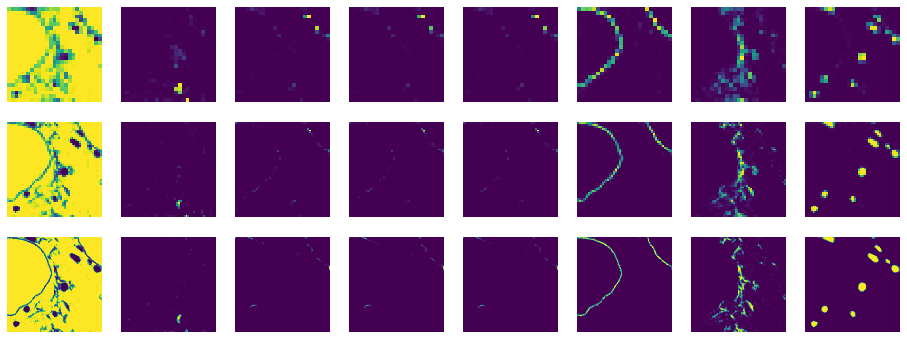

INFO [2019-11-04 22:32:05,923]: Epoch 861: loss= 0.580790
INFO [2019-11-04 22:32:08,864]: Epoch 862: loss= 0.580777
INFO [2019-11-04 22:32:11,832]: Epoch 863: loss= 0.580763
INFO [2019-11-04 22:32:14,823]: Epoch 864: loss= 0.580750
INFO [2019-11-04 22:32:17,807]: Epoch 865: loss= 0.580737
INFO [2019-11-04 22:32:20,818]: Epoch 866: loss= 0.580723
INFO [2019-11-04 22:32:23,873]: Epoch 867: loss= 0.580710
INFO [2019-11-04 22:32:26,842]: Epoch 868: loss= 0.580697
INFO [2019-11-04 22:32:29,832]: Epoch 869: loss= 0.580684
INFO [2019-11-04 22:32:32,803]: Epoch 870: loss= 0.580670


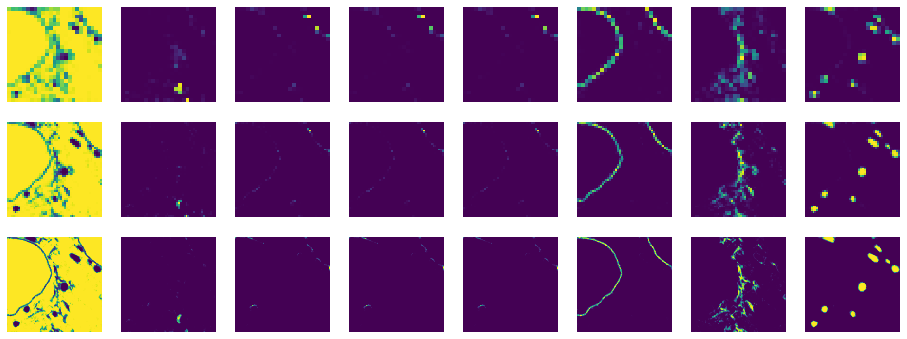

INFO [2019-11-04 22:32:36,458]: Epoch 871: loss= 0.580657
INFO [2019-11-04 22:32:39,411]: Epoch 872: loss= 0.580644
INFO [2019-11-04 22:32:42,407]: Epoch 873: loss= 0.580631
INFO [2019-11-04 22:32:45,707]: Epoch 874: loss= 0.580617
INFO [2019-11-04 22:32:48,900]: Epoch 875: loss= 0.580604
INFO [2019-11-04 22:32:51,928]: Epoch 876: loss= 0.580591
INFO [2019-11-04 22:32:54,890]: Epoch 877: loss= 0.580578
INFO [2019-11-04 22:32:57,877]: Epoch 878: loss= 0.580564
INFO [2019-11-04 22:33:00,842]: Epoch 879: loss= 0.580551
INFO [2019-11-04 22:33:03,774]: Epoch 880: loss= 0.580538


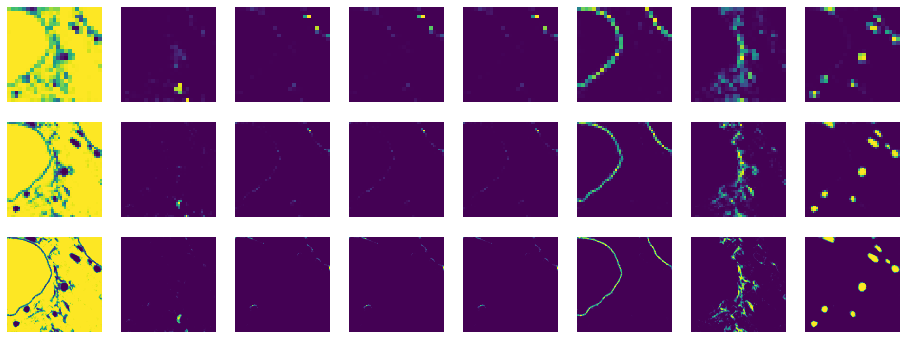

INFO [2019-11-04 22:33:07,392]: Epoch 881: loss= 0.580525
INFO [2019-11-04 22:33:10,383]: Epoch 882: loss= 0.580512
INFO [2019-11-04 22:33:13,385]: Epoch 883: loss= 0.580499
INFO [2019-11-04 22:33:16,326]: Epoch 884: loss= 0.580486
INFO [2019-11-04 22:33:19,266]: Epoch 885: loss= 0.580473
INFO [2019-11-04 22:33:22,204]: Epoch 886: loss= 0.580460
INFO [2019-11-04 22:33:25,198]: Epoch 887: loss= 0.580447
INFO [2019-11-04 22:33:28,193]: Epoch 888: loss= 0.580434
INFO [2019-11-04 22:33:31,125]: Epoch 889: loss= 0.580421
INFO [2019-11-04 22:33:34,092]: Epoch 890: loss= 0.580408


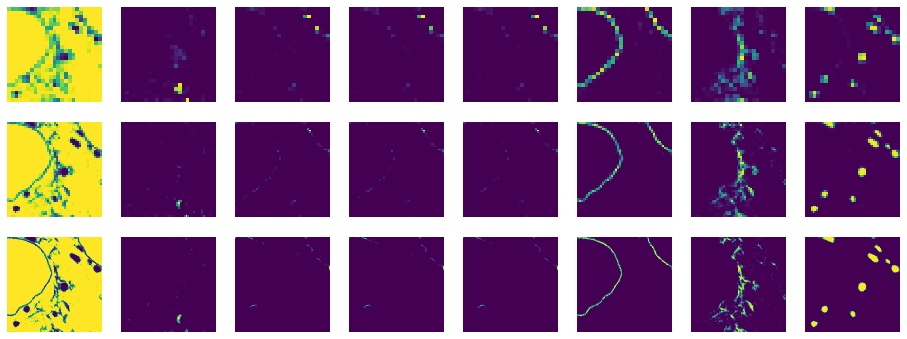

INFO [2019-11-04 22:33:37,697]: Epoch 891: loss= 0.580395
INFO [2019-11-04 22:33:40,637]: Epoch 892: loss= 0.580382
INFO [2019-11-04 22:33:43,581]: Epoch 893: loss= 0.580369
INFO [2019-11-04 22:33:46,518]: Epoch 894: loss= 0.580356
INFO [2019-11-04 22:33:49,469]: Epoch 895: loss= 0.580343
INFO [2019-11-04 22:33:52,451]: Epoch 896: loss= 0.580330
INFO [2019-11-04 22:33:55,404]: Epoch 897: loss= 0.580317
INFO [2019-11-04 22:33:58,461]: Epoch 898: loss= 0.580304
INFO [2019-11-04 22:34:01,505]: Epoch 899: loss= 0.580292
INFO [2019-11-04 22:34:04,443]: Epoch 900: loss= 0.580279


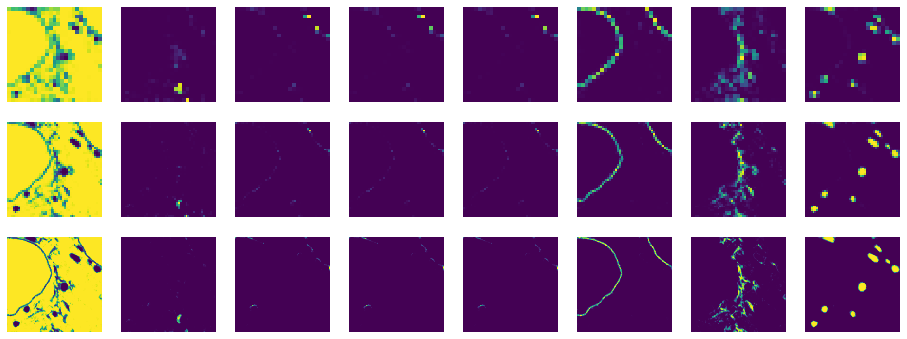

INFO [2019-11-04 22:34:08,051]: Epoch 901: loss= 0.580266
INFO [2019-11-04 22:34:10,973]: Epoch 902: loss= 0.580253
INFO [2019-11-04 22:34:13,896]: Epoch 903: loss= 0.580240
INFO [2019-11-04 22:34:16,847]: Epoch 904: loss= 0.580228
INFO [2019-11-04 22:34:19,765]: Epoch 905: loss= 0.580215
INFO [2019-11-04 22:34:22,688]: Epoch 906: loss= 0.580202
INFO [2019-11-04 22:34:25,617]: Epoch 907: loss= 0.580189
INFO [2019-11-04 22:34:28,547]: Epoch 908: loss= 0.580177
INFO [2019-11-04 22:34:31,542]: Epoch 909: loss= 0.580164
INFO [2019-11-04 22:34:34,478]: Epoch 910: loss= 0.580151


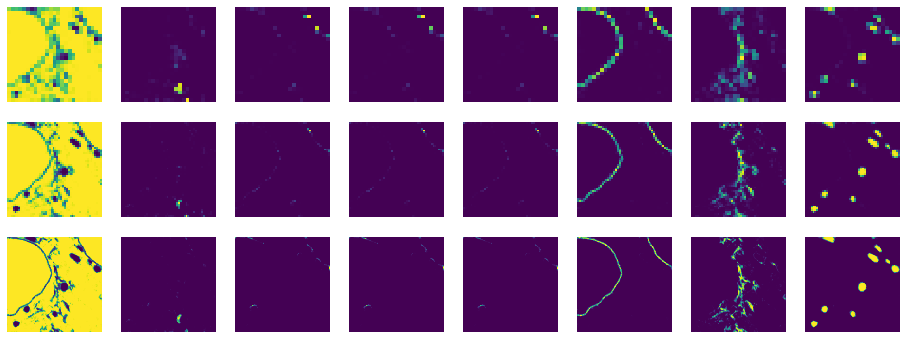

INFO [2019-11-04 22:34:37,981]: Epoch 911: loss= 0.580139
INFO [2019-11-04 22:34:40,933]: Epoch 912: loss= 0.580126
INFO [2019-11-04 22:34:43,863]: Epoch 913: loss= 0.580113
INFO [2019-11-04 22:34:47,684]: Epoch 914: loss= 0.580101
INFO [2019-11-04 22:34:50,657]: Epoch 915: loss= 0.580088
INFO [2019-11-04 22:34:53,632]: Epoch 916: loss= 0.580075
INFO [2019-11-04 22:34:56,552]: Epoch 917: loss= 0.580063
INFO [2019-11-04 22:34:59,485]: Epoch 918: loss= 0.580050
INFO [2019-11-04 22:35:02,464]: Epoch 919: loss= 0.580038
INFO [2019-11-04 22:35:05,497]: Epoch 920: loss= 0.580025


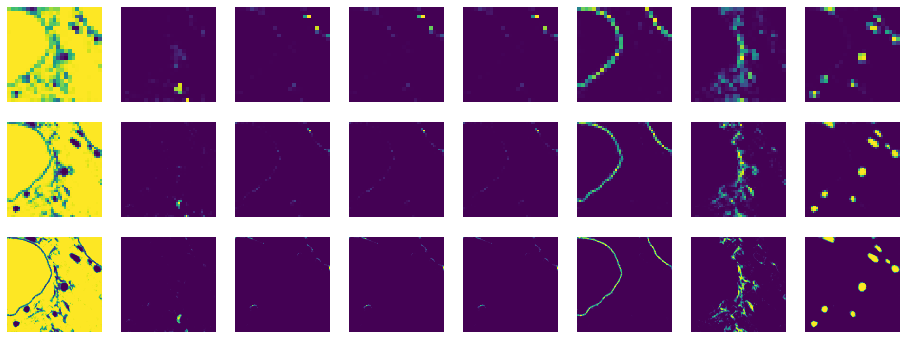

INFO [2019-11-04 22:35:09,079]: Epoch 921: loss= 0.580013
INFO [2019-11-04 22:35:12,047]: Epoch 922: loss= 0.580000
INFO [2019-11-04 22:35:15,040]: Epoch 923: loss= 0.579988
INFO [2019-11-04 22:35:17,984]: Epoch 924: loss= 0.579975
INFO [2019-11-04 22:35:20,938]: Epoch 925: loss= 0.579963
INFO [2019-11-04 22:35:23,884]: Epoch 926: loss= 0.579950
INFO [2019-11-04 22:35:26,803]: Epoch 927: loss= 0.579938
INFO [2019-11-04 22:35:29,731]: Epoch 928: loss= 0.579925
INFO [2019-11-04 22:35:32,720]: Epoch 929: loss= 0.579913
INFO [2019-11-04 22:35:35,659]: Epoch 930: loss= 0.579901


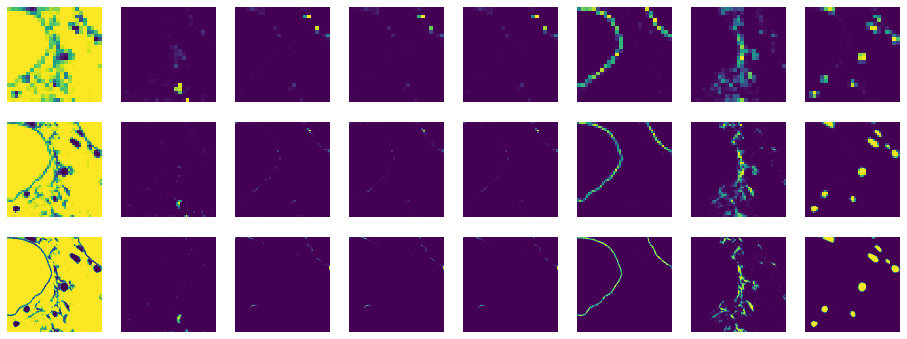

INFO [2019-11-04 22:35:39,273]: Epoch 931: loss= 0.579888
INFO [2019-11-04 22:35:42,205]: Epoch 932: loss= 0.579876
INFO [2019-11-04 22:35:45,121]: Epoch 933: loss= 0.579863
INFO [2019-11-04 22:35:48,035]: Epoch 934: loss= 0.579851
INFO [2019-11-04 22:35:51,062]: Epoch 935: loss= 0.579839
INFO [2019-11-04 22:35:53,987]: Epoch 936: loss= 0.579826
INFO [2019-11-04 22:35:56,987]: Epoch 937: loss= 0.579814
INFO [2019-11-04 22:35:59,930]: Epoch 938: loss= 0.579802
INFO [2019-11-04 22:36:02,949]: Epoch 939: loss= 0.579790
INFO [2019-11-04 22:36:06,009]: Epoch 940: loss= 0.579777


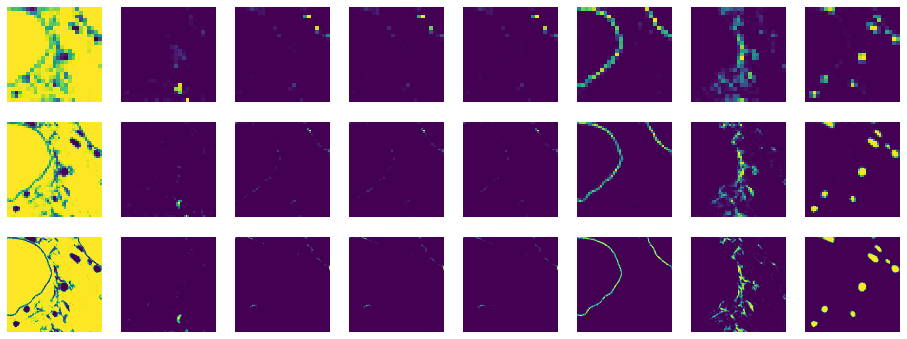

INFO [2019-11-04 22:36:09,624]: Epoch 941: loss= 0.579765
INFO [2019-11-04 22:36:12,560]: Epoch 942: loss= 0.579753
INFO [2019-11-04 22:36:15,499]: Epoch 943: loss= 0.579740
INFO [2019-11-04 22:36:18,470]: Epoch 944: loss= 0.579728
INFO [2019-11-04 22:36:21,424]: Epoch 945: loss= 0.579716
INFO [2019-11-04 22:36:24,342]: Epoch 946: loss= 0.579704
INFO [2019-11-04 22:36:27,306]: Epoch 947: loss= 0.579692
INFO [2019-11-04 22:36:30,234]: Epoch 948: loss= 0.579679
INFO [2019-11-04 22:36:33,187]: Epoch 949: loss= 0.579667
INFO [2019-11-04 22:36:36,148]: Epoch 950: loss= 0.579655


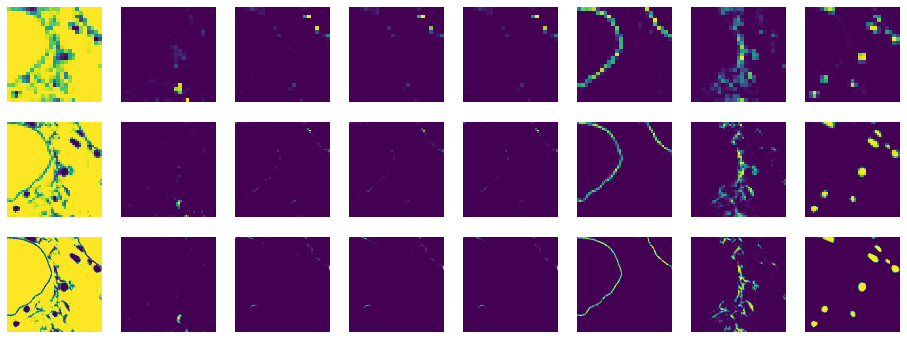

INFO [2019-11-04 22:36:39,828]: Epoch 951: loss= 0.579643
INFO [2019-11-04 22:36:42,876]: Epoch 952: loss= 0.579631
INFO [2019-11-04 22:36:46,349]: Epoch 953: loss= 0.579619
INFO [2019-11-04 22:36:49,617]: Epoch 954: loss= 0.579607
INFO [2019-11-04 22:36:52,596]: Epoch 955: loss= 0.579595
INFO [2019-11-04 22:36:55,562]: Epoch 956: loss= 0.579582
INFO [2019-11-04 22:36:58,468]: Epoch 957: loss= 0.579570
INFO [2019-11-04 22:37:01,412]: Epoch 958: loss= 0.579558
INFO [2019-11-04 22:37:04,350]: Epoch 959: loss= 0.579546
INFO [2019-11-04 22:37:07,460]: Epoch 960: loss= 0.579534


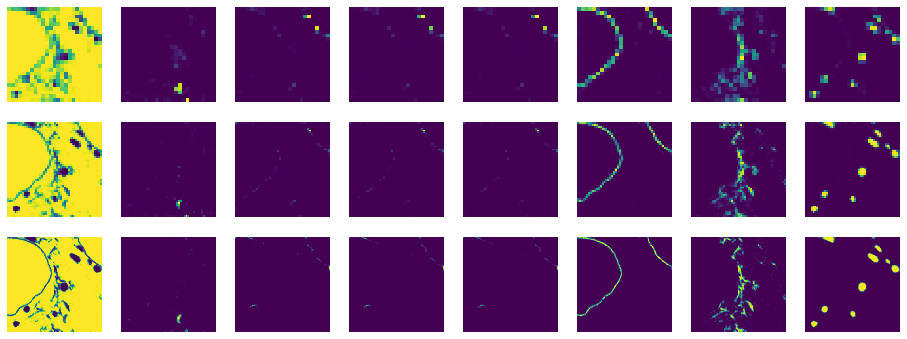

INFO [2019-11-04 22:37:11,155]: Epoch 961: loss= 0.579522
INFO [2019-11-04 22:37:14,215]: Epoch 962: loss= 0.579510
INFO [2019-11-04 22:37:17,187]: Epoch 963: loss= 0.579498
INFO [2019-11-04 22:37:20,104]: Epoch 964: loss= 0.579486
INFO [2019-11-04 22:37:23,048]: Epoch 965: loss= 0.579474
INFO [2019-11-04 22:37:25,955]: Epoch 966: loss= 0.579462
INFO [2019-11-04 22:37:28,872]: Epoch 967: loss= 0.579450
INFO [2019-11-04 22:37:31,794]: Epoch 968: loss= 0.579438
INFO [2019-11-04 22:37:34,727]: Epoch 969: loss= 0.579426
INFO [2019-11-04 22:37:37,661]: Epoch 970: loss= 0.579414


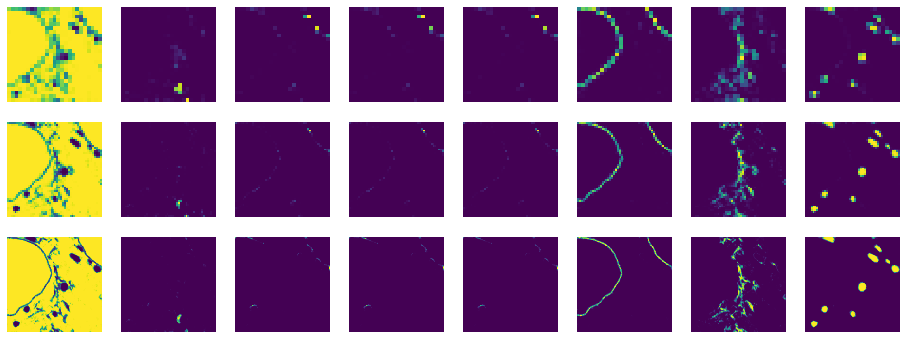

INFO [2019-11-04 22:37:41,347]: Epoch 971: loss= 0.579402
INFO [2019-11-04 22:37:44,316]: Epoch 972: loss= 0.579390
INFO [2019-11-04 22:37:47,353]: Epoch 973: loss= 0.579379
INFO [2019-11-04 22:37:50,269]: Epoch 974: loss= 0.579367
INFO [2019-11-04 22:37:53,198]: Epoch 975: loss= 0.579355
INFO [2019-11-04 22:37:56,146]: Epoch 976: loss= 0.579343
INFO [2019-11-04 22:37:59,088]: Epoch 977: loss= 0.579331
INFO [2019-11-04 22:38:02,024]: Epoch 978: loss= 0.579319
INFO [2019-11-04 22:38:04,950]: Epoch 979: loss= 0.579307
INFO [2019-11-04 22:38:07,939]: Epoch 980: loss= 0.579295


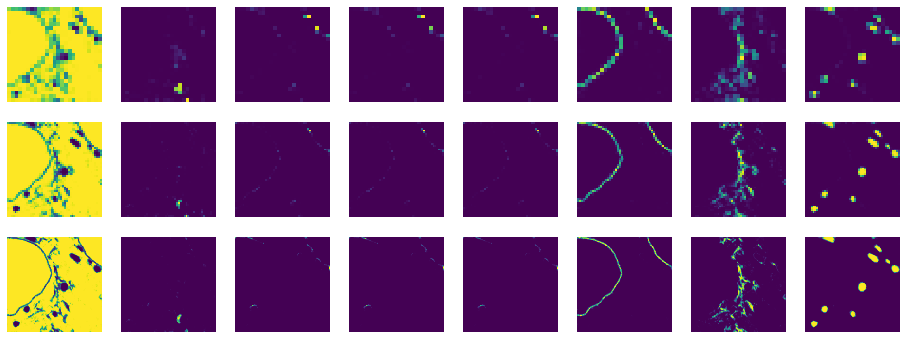

INFO [2019-11-04 22:38:11,622]: Epoch 981: loss= 0.579284
INFO [2019-11-04 22:38:14,606]: Epoch 982: loss= 0.579272
INFO [2019-11-04 22:38:17,539]: Epoch 983: loss= 0.579260
INFO [2019-11-04 22:38:20,468]: Epoch 984: loss= 0.579248
INFO [2019-11-04 22:38:23,392]: Epoch 985: loss= 0.579236
INFO [2019-11-04 22:38:26,301]: Epoch 986: loss= 0.579224
INFO [2019-11-04 22:38:29,239]: Epoch 987: loss= 0.579213
INFO [2019-11-04 22:38:32,198]: Epoch 988: loss= 0.579201
INFO [2019-11-04 22:38:35,139]: Epoch 989: loss= 0.579189
INFO [2019-11-04 22:38:38,105]: Epoch 990: loss= 0.579177


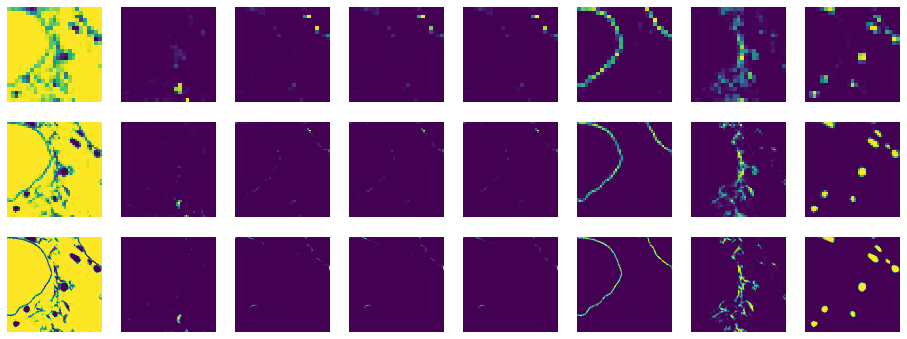

INFO [2019-11-04 22:38:41,619]: Epoch 991: loss= 0.579166
INFO [2019-11-04 22:38:44,577]: Epoch 992: loss= 0.579154
INFO [2019-11-04 22:38:48,203]: Epoch 993: loss= 0.579142
INFO [2019-11-04 22:38:51,239]: Epoch 994: loss= 0.579130
INFO [2019-11-04 22:38:54,192]: Epoch 995: loss= 0.579119
INFO [2019-11-04 22:38:57,148]: Epoch 996: loss= 0.579107
INFO [2019-11-04 22:39:00,069]: Epoch 997: loss= 0.579095
INFO [2019-11-04 22:39:03,024]: Epoch 998: loss= 0.579084
INFO [2019-11-04 22:39:05,966]: Epoch 999: loss= 0.579072


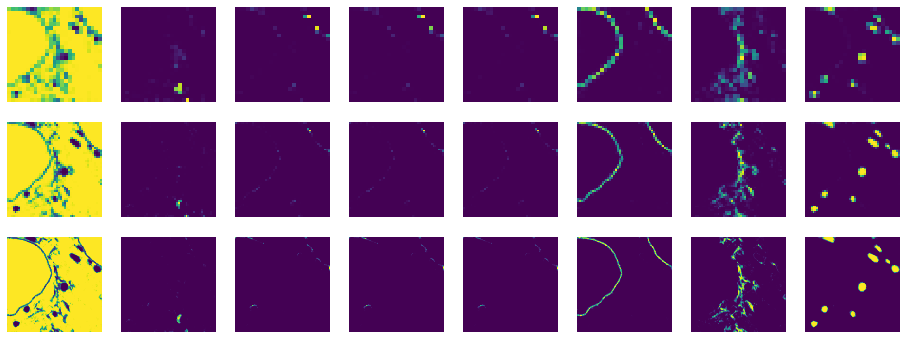

In [46]:
EPS = 1e-4
def extreme_mloss(mpx, mpx_true):
    with torch.enable_grad():
        sum_m = 0.0
        n_res = 0
        for px, px_true in zip(mpx, mpx_true):
            sum_class = 0.0
            for c in range(px.shape[1]):
                pxc = px[:, c, ...]
                lpxc = torch.log(pxc)
                pxtc = px_true[:, c, ...]
                if pxtc.sum() < EPS:
                    continue
                sum_class += -(pxtc * lpxc).sum() / (pxtc.sum()) \
                            + ((1-pxtc) * pxc).sum() / ((1-pxtc).sum())
#                 true_idx = px_true[:, c, ...] > 0.1
#                 if true_idx.sum() == 0:
#                     continue
#                 sum_class += -(torch.mean(lpxc[true_idx]) - torch.mean(pxc))
            sum_m += sum_class / px.shape[1]
            n_res += 1
    return sum_m / n_res


EPS = 1e-4
def ce_mloss(mlogpx, mpx_true):
    with torch.enable_grad():
        sum_m = 0.0
        n_res = 0
        for logpx, px_true in zip(mlogpx, mpx_true):
            sum_m += -(px_true * logpx).mean(-1).mean(-1).sum(-1).mean(0)
            n_res += 1
    return sum_m / n_res


def px2pc(px):
    n_batch, n_classes, n = px.shape
    pc = px.reshape(n_batch, n_classes, -1).mean(-1)
    pc_total = pc.sum(-1)
    return pc / pc_total


EPS = 1e-4
def kldiv_loss(mlogpx, mpx_true):
    with torch.enable_grad():
        total, nres = 0.0, 0
        for logpx, px_true in zip(mlogpx, mpx_true):
            n_batch, n_classes, nh, nw = logpx.shape
            logpx = logpx.reshape(n_batch, n_classes, -1)
            px_true = px_true.reshape(n_batch, n_classes, -1)
            
            px = torch.exp(logpx)
            pc = px2pc(px)
            pc_true = px2pc(px_true)
            pct_ok = pc_true > EPS
        
            # class density KL(q(c) || p(c))
            sum_class = -(pc_true * torch.log(pc)).sum(-1).mean(-1)

            # class distribution over image KL(q(x | c) || p(x | c))
            sum_dist = -((px_true * logpx).mean(-1)).sum(-1).mean(-1)

            # KL(q(x, c) || p(x, c))
            total += (sum_class + sum_dist)
            nres += 1
#             print(total.item(), sum_class.item(), sum_dist.item())
    return total / nres


NEPOCH = 1000
LR = 0.1
softmax = nn.Softmax2d()
logsoftmax = nn.LogSoftmax(dim=1)
optimizer = optim.SGD(mrsegnet.parameters(), lr=LR, momentum=0.9)
celoss = nn.CrossEntropyLoss()
for epoch in range(NEPOCH):
    optimizer.zero_grad()
    mlogits = mrsegnet(ximg_dsr_t)
#     loss = extreme_mloss(map(softmax, mlogits), yprob_dsr_t)
#     loss = ce_mloss(map(logsoftmax, mlogits), yprob_dsr_t)
    loss = kldiv_loss(map(logsoftmax, mlogits), yprob_dsr_t)
    loss.backward()
    optimizer.step()
    
    logger.info('Epoch %3d: loss= %f' % (epoch, loss.item()))
    if epoch < 5 or epoch % 10 == 0 or epoch == NEPOCH-1:
        mlogits = mlogits_pick_sample(mlogits)
        show_pred_mpx([logits2px(logits) for logits in mlogits])
        plt.show()
    if epoch in [500]:
        LR /= 3
        optimizer = optim.SGD(mrsegnet.parameters(), lr=LR, momentum=0.9)

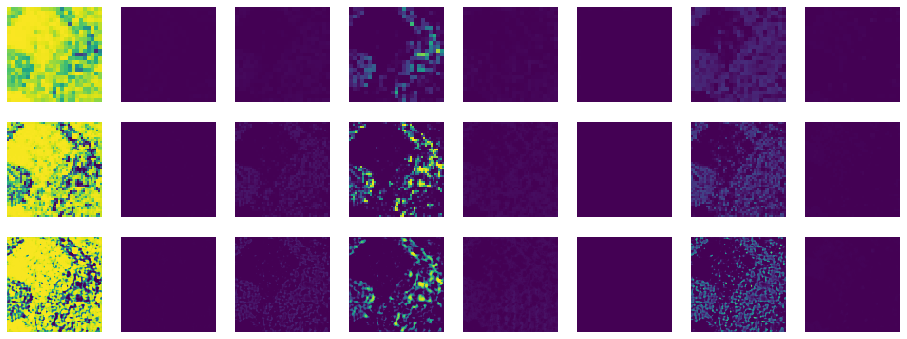

In [37]:
show_pred_mpx([logits2px(logits) for logits in mlogits])

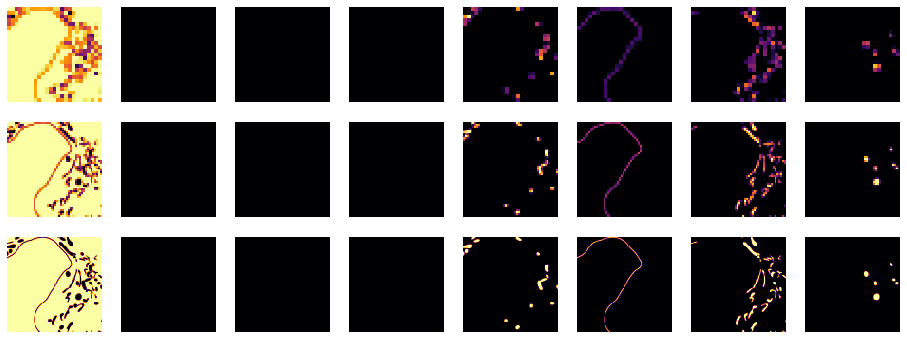

In [38]:
def show_pred_mpx(mpx, SZ=2, cmap='viridis'):
    N = len(mpx)
    M = mpx[0].shape[0]
    fig, axes = plt.subplots(nrows=N, ncols=M, figsize=(SZ*M, SZ*N))
    for axs, px in zip(axes, mpx):
        for ax, pxi in zip(axs, px):
            ax.imshow(pxi, vmin=0.0, vmax=1.0, cmap=cmap)
            ax.axis('off')
    
show_pred_mpx(yprob_sel_dsrs, cmap='inferno')

In [59]:
mrsegnet.load_state_dict(torch.load('/home/mixs/Documents/research/neuode/dump/model/msegnetall_overfit.pth'))

<All keys matched successfully>

In [47]:
torch.save(mrsegnet.state_dict(), '/home/mixs/Dodcuments/research/neuode/dump/model/msegnetall_overfit_2.pth')

In [26]:
x, y, px = extract_window(1600, 3840, 1600, 4480, 8)
x_t = torch.Tensor(normalize_image(x[::16, ::16]))[None, None, ...]
mpx_true = make_hierarichical_dsr(px, [64, 32, 16])
x.shape, y.shape, px.shape, [pr.shape for pr in mpx_true]

((2240, 2880),
 (2240, 2880),
 (8, 2240, 2880),
 [(8, 35, 45), (8, 70, 90), (8, 140, 180)])

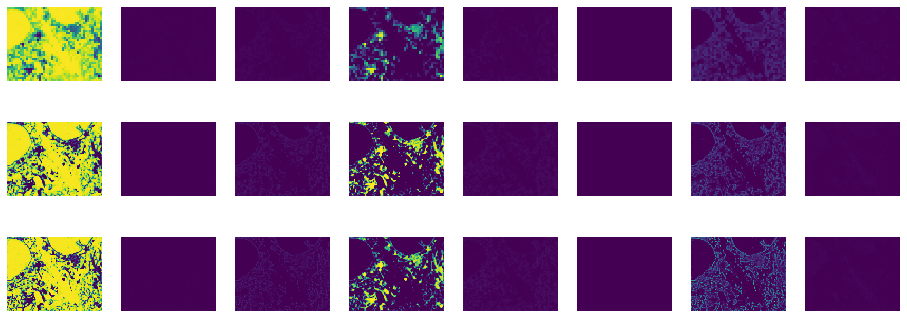

In [27]:
with torch.no_grad():
#     mlogits = mrsegnet(ximg_dsr_t)
    mlogits = mrsegnet(x_t)
    mlogits = mlogits_pick_sample(mlogits)
show_pred_mpx([logits2px(logits) for logits in mlogits])

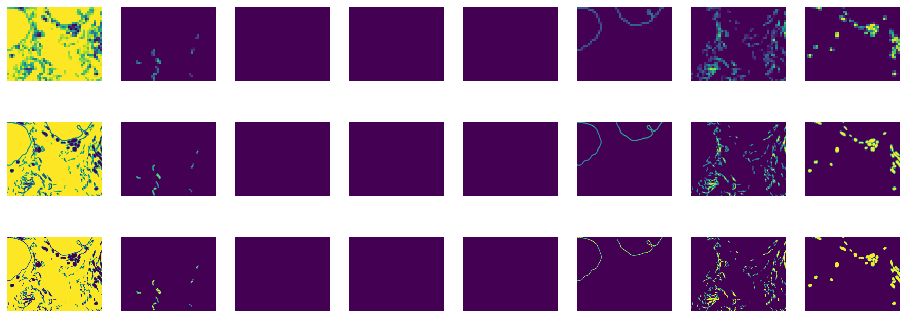

In [28]:
show_pred_mpx(mpx_true)

In [41]:
# list of soft probability layer
len(sample_mpx)

3

In [45]:
# the DSRs are 64, 32, and 16 respectively; the raw image was 2240 by 2880
# shape shown below are (num_batch, num_classes, height, width)
for mpx in sample_mpx:
    print(mpx.shape)

(1, 8, 35, 45)
(1, 8, 70, 90)
(1, 8, 140, 180)


In [52]:
# one raw image, greyscale with 2240x2880 pixels
raw_image.shape

torch.Size([1, 1, 2240, 2880])